# 🏙️ Renewable Energy Management System for NEOM - Saudi Arabia
## Graduation Project – Saudi Digital Academy, developed in collaboration with Le Wagon| Showcased at LEAP 2025

In support of Saudi Arabia’s Vision 2030 — which places sustainability, clean energy, and technological innovation at the heart of national transformation — this project offers a data-driven framework to simulate NEOM’s energy future through artificial intelligence and predictive modeling.

Developed by a five-member team during the Data Science Bootcamp at the Saudi Digital Academy, and showcased at LEAP 2025, the project forecasts both **electricity consumption** and **solar energy production** in NEOM’s context, leveraging real-world datasets and machine learning techniques.

The work was completed collaboratively within a tight 7-day timeline, and reflects our belief that we are not just witnesses to the Vision — we are part of its making.


🔗 **Full Repository on GitHub**  
For complete code, detailed analysis, preprocessing steps, and all final models:

➡️ [Renewable_Energy](https://github.com/NEOM-Renewable-Energy/Renewable_Energy)

---

### 👤 My Role – Afnan Alamri:
As the **Project Manager**, I took the lead in coordinating the team's efforts and was particularly involved in the **electricity consumption analysis**. Among my core contributions:

- Sourcing and adapting real-world electricity consumption data from **Tetouan, Morocco**, selected for its geographic and climatic resemblance to NEOM.
- Collaboratively designing and evaluating machine learning and deep learning models to forecast consumption patterns.
- Leading a cross-cultural energy behavior study that revealed clear similarities between Moroccan and Saudi users — influenced by shared **language, religious customs, cultural routines, and lifestyle rhythms** across Arab societies.
- Recommending enhancements through feature engineering, such as weekday/weekend flags, holiday indicators, hourly segmentation, and seasonal labeling.

These contributions represent the blend of my technical work and strategic oversight, carried out in synergy with a dedicated and skilled team.

---

### 🤝 Connect with the Team:

- [Afnan Alamri](https://www.linkedin.com/in/afnan-alamri-/)
- [Dalia Alfallaj](https://www.linkedin.com/in/dalia-alfallaj/)
- [Maram Aljraied](https://www.linkedin.com/in/maram-aljraied/)
- [Shahla Abdullah](https://www.linkedin.com/in/shahla-alawad/)
- [Abdulaziz Alfallaj](https://www.linkedin.com/in/abdulaziz-alfallaj/)

# 🧭 Notebook Guide

## 1. Electricity Consumption Forecasting
- Per capita consumption analysis
- Time-based aggregation and regional consumption trends
- Comparative study: Saudi vs Moroccan consumer patterns
- Forecasting individual and monthly electricity demand
- Applied models: Decision Tree, Random Forest, XGBoost, LightGBM, CatBoost, MLP

## 2. Solar Energy Production Forecasting
- Analysis of panel performance, irradiation, and temperature data
- Inverter efficiency evaluation and anomaly detection
- Forecasting solar output using LightGBM, CatBoost, and LSTM

## 3. Model Evaluation & Final Selection
- Summary of top-performing models across tasks
- Performance metrics and selection rationale

---

## 🧾 Datasets Used

The project is based on two real-world datasets that represent energy consumption and solar power production from different geographic contexts:

1. **Electricity Consumption Dataset (Tetouan, Morocco)**  
   - Sourced from Kaggle: [Electric Power Consumption Forecasting](https://www.kaggle.com/code/nechbamohammed/electric-power-consumption-forecasting)  
   - Chosen for its climatic and geographic similarity to NEOM.
   - Includes electricity usage data from multiple distribution stations, recorded at 10-minute intervals.
     
2. **Solar Production Dataset**  
   - Sourced from Kaggle: [Solar Power plant Dataset](https://www.kaggle.com/datasets/pythonafroz/solar-power/)  
   - Contains 15-minute interval data for solar panel generation across two plants.
   - Includes features such as DC power, AC power, and daily yields.

> Both datasets were adapted to simulate NEOM's environment for modeling and forecasting purposes.

# Per Capita Consumption

## SetUp

### import

In [1]:
!pip install statsmodels
!pip install holidays
!pip install pmdarima
!pip install plotly xgboost tensorflow pmdarima
!pip install matplotlib


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 38.5 MB/s eta 0:00:00


In [2]:
from sklearn.exceptions import ConvergenceWarning
import warnings

warnings.filterwarnings("ignore", category=ConvergenceWarning)


In [3]:
# Import packages and modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import xgboost as xgb

import tensorflow as tf
import pmdarima as pm
import lightgbm as lgb
import holidays
import statsmodels.api as sm
from statsmodels.tsa.arima.model import ARIMA
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler , StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score , make_scorer, mean_absolute_error
from sklearn.model_selection import cross_validate
from sklearn.cluster import KMeans

from sklearn.metrics import silhouette_score
from sklearn.ensemble import RandomForestRegressor

from tensorflow.keras import regularizers, Sequential, layers
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import LSTM
from statsmodels.tsa.stattools import adfuller
from pmdarima import auto_arima
from sklearn.model_selection import GridSearchCV

from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.model_selection import learning_curve


from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Conv1D, MaxPooling1D, Flatten, GRU, Normalization, LSTM
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model


from statsmodels.tsa.stattools import adfuller
from pmdarima import auto_arima


2025-04-23 16:05:45.399114: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1745424345.592448      20 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745424345.649358      20 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [4]:
pd.set_option('display.max_columns', None)

## Data Loading

### Read csv

In [5]:
df = pd.read_csv('/kaggle/input/tetouan-electricity-consumption-v2/powerconsumption.csv')
df.head()


,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
0,1/1/2017 0:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
1,1/1/2017 0:10,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2,1/1/2017 0:20,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
3,1/1/2017 0:30,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
4,1/1/2017 0:40,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964


## Data Cleaning

### Handle Missings

It is clear that we have outliers in the Diffuse Flows and General Diffuse Flows.

In [6]:
def detailed_check_df(dataframe, head=5):
    print("Shape:")
    print(dataframe.shape)

    print("Info:")
    print(dataframe.info(memory_usage='deep'))

    print("Types:")
    print(dataframe.dtypes)

    print("Missing Values:")
    missing_values = dataframe.isnull().sum()
    print(missing_values[missing_values > 0])

    print("Unique Values:")
    for column in dataframe.columns:
        print(f"{column} has {dataframe[column].nunique()} unique values")

detailed_check_df(df)

Shape:
(52416, 9)
Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52416 entries, 0 to 52415
Data columns (total 9 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Datetime                52416 non-null  object 
 1   Temperature             52416 non-null  float64
 2   Humidity                52416 non-null  float64
 3   WindSpeed               52416 non-null  float64
 4   GeneralDiffuseFlows     52416 non-null  float64
 5   DiffuseFlows            52416 non-null  float64
 6   PowerConsumption_Zone1  52416 non-null  float64
 7   PowerConsumption_Zone2  52416 non-null  float64
 8   PowerConsumption_Zone3  52416 non-null  float64
dtypes: float64(8), object(1)
memory usage: 6.8 MB
None
Types:
Datetime                   object
Temperature               float64
Humidity                  float64
WindSpeed                 float64
GeneralDiffuseFlows       float64
DiffuseFlows              float64
PowerConsumption_Z

In [7]:
df.isna().sum()
df.columns

Index(['Datetime', 'Temperature', 'Humidity', 'WindSpeed',
       'GeneralDiffuseFlows', 'DiffuseFlows', 'PowerConsumption_Zone1',
       'PowerConsumption_Zone2', 'PowerConsumption_Zone3'],
      dtype='object')

The outliers are clearly visible in both GeneralDiffuseFlows and DiffuseFlows

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


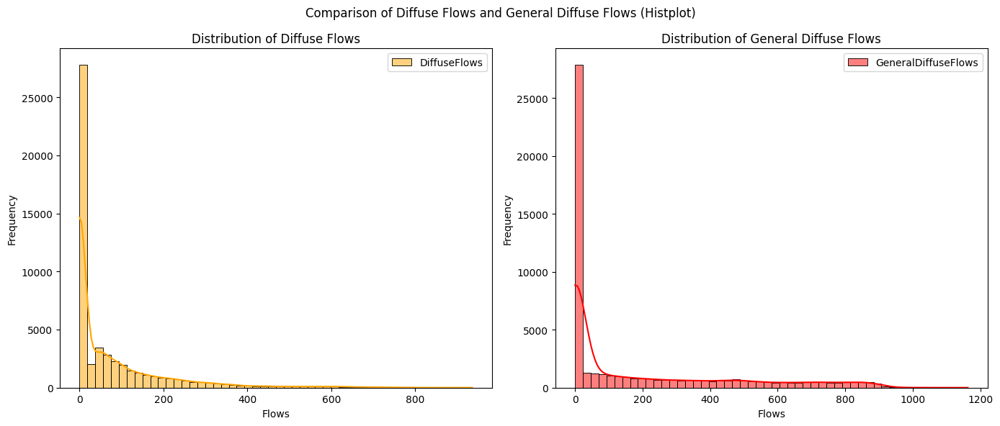

In [8]:
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# Plot for Diffuse Flows
sns.histplot(df['DiffuseFlows'], kde=True, label='DiffuseFlows', color='orange', bins=50, ax=ax[0])
ax[0].set_title('Distribution of Diffuse Flows')
ax[0].set_xlabel('Flows')
ax[0].set_ylabel('Frequency')
ax[0].legend()

# Plot for General Diffuse Flows
sns.histplot(df['GeneralDiffuseFlows'], kde=True, label='GeneralDiffuseFlows', color='red', bins=50, ax=ax[1])
ax[1].set_title('Distribution of General Diffuse Flows')
ax[1].set_xlabel('Flows')
ax[1].set_ylabel('Frequency')
ax[1].legend()

plt.suptitle('Comparison of Diffuse Flows and General Diffuse Flows (Histplot)')
plt.tight_layout()
plt.show()

Remove unnecessary columns

In [9]:
df = df.drop(columns = [ 'DiffuseFlows', 'GeneralDiffuseFlows'])

In [10]:
df.dtypes

Datetime                   object
Temperature               float64
Humidity                  float64
WindSpeed                 float64
PowerConsumption_Zone1    float64
PowerConsumption_Zone2    float64
PowerConsumption_Zone3    float64
dtype: object

## Data Preparing

### DateTime index

In [11]:
df['Datetime'] = pd.to_datetime(df['Datetime'],format='%m/%d/%Y %H:%M')
df.set_index('Datetime', inplace=True)

df.head()

,Temperature,Humidity,WindSpeed,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
Datetime,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,34055.69620,16128.87538,20240.96386
2017-01-01 00:10:00,6.414,74.5,0.083,29814.68354,19375.07599,20131.08434
2017-01-01 00:20:00,6.313,74.5,0.080,29128.10127,19006.68693,19668.43373
2017-01-01 00:30:00,6.121,75.0,0.083,28228.86076,18361.09422,18899.27711
2017-01-01 00:40:00,5.921,75.7,0.081,27335.69620,17872.34043,18442.40964


In [12]:
# Create new columns using the Datetime index
df['Year'] = df.index.year
df['Month'] = df.index.month
df['Day'] = df.index.day
df['Hour'] = df.index.hour
df.head()

,Temperature,Humidity,WindSpeed,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,Year,Month,Day,Hour
Datetime,,,,,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,34055.69620,16128.87538,20240.96386,2017,1,1,0
2017-01-01 00:10:00,6.414,74.5,0.083,29814.68354,19375.07599,20131.08434,2017,1,1,0
2017-01-01 00:20:00,6.313,74.5,0.080,29128.10127,19006.68693,19668.43373,2017,1,1,0
2017-01-01 00:30:00,6.121,75.0,0.083,28228.86076,18361.09422,18899.27711,2017,1,1,0
2017-01-01 00:40:00,5.921,75.7,0.081,27335.69620,17872.34043,18442.40964,2017,1,1,0


### Add IsHoliday column

#### Insert the 2017 Moroccan Holiday Dataset


Holidays in Morocco for the year 2017 will be added using a holidays library. The goal is to introduce a new feature to the dataset, allowing us to measure electricity consumption on holidays versus non-holidays.

In [13]:
df.index = pd.to_datetime(df.index)
df['Date'] = df.index.date

# Initialize the Morocco holidays for the year 2017
morocco_holidays = holidays.Morocco(years=[2017])

# Add the 'IsHoliday' column
df['IsHoliday'] = df['Date'].apply(lambda x: 1 if x in morocco_holidays else 0)
df = df.drop(columns = ['Date'])

df.head()

,Temperature,Humidity,WindSpeed,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,Year,Month,Day,Hour,IsHoliday
Datetime,,,,,,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,34055.69620,16128.87538,20240.96386,2017,1,1,0,1
2017-01-01 00:10:00,6.414,74.5,0.083,29814.68354,19375.07599,20131.08434,2017,1,1,0,1
2017-01-01 00:20:00,6.313,74.5,0.080,29128.10127,19006.68693,19668.43373,2017,1,1,0,1
2017-01-01 00:30:00,6.121,75.0,0.083,28228.86076,18361.09422,18899.27711,2017,1,1,0,1
2017-01-01 00:40:00,5.921,75.7,0.081,27335.69620,17872.34043,18442.40964,2017,1,1,0,1


#### Morocco holidays for 2017

##### To ensure accuracy, this is list all holidays for Morocco in 2017 generated by the holidays library.

In [14]:
# Print all holidays in Morocco for 2017
for date, name in sorted(morocco_holidays.items()):
    print(date, name)

2017-01-01 New Year's Day
2017-01-11 Proclamation of Independence Day
2017-05-01 Labor Day
2017-06-25 Eid al-Fitr (estimated)
2017-06-26 Eid al-Fitr (estimated)
2017-07-30 Throne Day
2017-08-14 Oued Ed-Dahab Day
2017-08-20 Revolution Day
2017-08-21 Youth Day
2017-09-01 Eid al-Adha (estimated)
2017-09-02 Eid al-Adha (estimated)
2017-09-21 Islamic New Year (estimated)
2017-11-06 Green March
2017-11-18 Independence Day
2017-11-30 Prophet's Birthday (estimated)
2017-12-01 Prophet's Birthday (estimated)


### Time of Day and Weekend Classification

Time-of-day categories will be added based on the hour, and new columns will be added to determine the day of the week and whether it's a weekend or not.

In [15]:
# Define time of day categories
def categorize_time_of_day(hour):
    if 6 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 18:
        return 'Afternoon'
    elif 18 <= hour < 24:
        return 'Evening'
    else:
        return 'Night'

# Categorize the time of day using the 'Hour' column
df['TimeOfDay'] = df['Hour'].apply(categorize_time_of_day)

# Add day of the week and check if it is a weekend
df['Weekday'] = df.index.weekday

# Add a column to indicate if it's a weekend
df['IsWeekend'] = df['Weekday'].apply(lambda x: 1 if x >= 5 else 0)

df = df.drop(columns = ['Weekday'])

### Season Classification

Months will be classified into seasons, a "Season" column will be added, and specific columns will be converted to numeric types.

In [16]:
# Define the seasons
def categorize_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Autumn'

df['Season'] = df['Month'].apply(categorize_season)

# Let's set the data types to numeric
df['Year'] = df['Year'].astype(int)
df['IsWeekend'] = df['IsWeekend'].astype(int)
df.head()

,Temperature,Humidity,WindSpeed,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,Year,Month,Day,Hour,IsHoliday,TimeOfDay,IsWeekend,Season
Datetime,,,,,,,,,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,34055.69620,16128.87538,20240.96386,2017,1,1,0,1,Night,1,Winter
2017-01-01 00:10:00,6.414,74.5,0.083,29814.68354,19375.07599,20131.08434,2017,1,1,0,1,Night,1,Winter
2017-01-01 00:20:00,6.313,74.5,0.080,29128.10127,19006.68693,19668.43373,2017,1,1,0,1,Night,1,Winter
2017-01-01 00:30:00,6.121,75.0,0.083,28228.86076,18361.09422,18899.27711,2017,1,1,0,1,Night,1,Winter
2017-01-01 00:40:00,5.921,75.7,0.081,27335.69620,17872.34043,18442.40964,2017,1,1,0,1,Night,1,Winter


### Zones

#### dealing with one city better than multi-zones

In [17]:
df['TotalPowerConsumption'] = df['PowerConsumption_Zone1'] + df['PowerConsumption_Zone2'] + df['PowerConsumption_Zone3']
df.head()

,Temperature,Humidity,WindSpeed,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,Year,Month,Day,Hour,IsHoliday,TimeOfDay,IsWeekend,Season,TotalPowerConsumption
Datetime,,,,,,,,,,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,34055.69620,16128.87538,20240.96386,2017,1,1,0,1,Night,1,Winter,70425.53544
2017-01-01 00:10:00,6.414,74.5,0.083,29814.68354,19375.07599,20131.08434,2017,1,1,0,1,Night,1,Winter,69320.84387
2017-01-01 00:20:00,6.313,74.5,0.080,29128.10127,19006.68693,19668.43373,2017,1,1,0,1,Night,1,Winter,67803.22193
2017-01-01 00:30:00,6.121,75.0,0.083,28228.86076,18361.09422,18899.27711,2017,1,1,0,1,Night,1,Winter,65489.23209
2017-01-01 00:40:00,5.921,75.7,0.081,27335.69620,17872.34043,18442.40964,2017,1,1,0,1,Night,1,Winter,63650.44627


#### Dropping the three zones since we have the total

In [18]:
df.drop(columns=['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3'], inplace=True)
df.head()

,Temperature,Humidity,WindSpeed,Year,Month,Day,Hour,IsHoliday,TimeOfDay,IsWeekend,Season,TotalPowerConsumption
Datetime,,,,,,,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,2017,1,1,0,1,Night,1,Winter,70425.53544
2017-01-01 00:10:00,6.414,74.5,0.083,2017,1,1,0,1,Night,1,Winter,69320.84387
2017-01-01 00:20:00,6.313,74.5,0.080,2017,1,1,0,1,Night,1,Winter,67803.22193
2017-01-01 00:30:00,6.121,75.0,0.083,2017,1,1,0,1,Night,1,Winter,65489.23209
2017-01-01 00:40:00,5.921,75.7,0.081,2017,1,1,0,1,Night,1,Winter,63650.44627


###  ENCODING -OneHotIncoder


In [19]:
ohe = OneHotEncoder(sparse_output=False)
ohe.fit(df[['Season', 'TimeOfDay']])
df[ohe.get_feature_names_out(['Season', 'TimeOfDay'])] = ohe.transform(df[['Season', 'TimeOfDay']])
df = df.drop(columns = ['Season', 'TimeOfDay'])

df.head()

,Temperature,Humidity,WindSpeed,Year,Month,Day,Hour,IsHoliday,IsWeekend,TotalPowerConsumption,Season_Autumn,Season_Spring,Season_Summer,Season_Winter,TimeOfDay_Afternoon,TimeOfDay_Evening,TimeOfDay_Morning,TimeOfDay_Night
Datetime,,,,,,,,,,,,,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,2017,1,1,0,1,1,70425.53544,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
2017-01-01 00:10:00,6.414,74.5,0.083,2017,1,1,0,1,1,69320.84387,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
2017-01-01 00:20:00,6.313,74.5,0.080,2017,1,1,0,1,1,67803.22193,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
2017-01-01 00:30:00,6.121,75.0,0.083,2017,1,1,0,1,1,65489.23209,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
2017-01-01 00:40:00,5.921,75.7,0.081,2017,1,1,0,1,1,63650.44627,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


## Exploratory Data Analysis 📊

### Visualize Correlation Analysis relationships

In [20]:
df.columns

Index(['Temperature', 'Humidity', 'WindSpeed', 'Year', 'Month', 'Day', 'Hour',
       'IsHoliday', 'IsWeekend', 'TotalPowerConsumption', 'Season_Autumn',
       'Season_Spring', 'Season_Summer', 'Season_Winter',
       'TimeOfDay_Afternoon', 'TimeOfDay_Evening', 'TimeOfDay_Morning',
       'TimeOfDay_Night'],
      dtype='object')

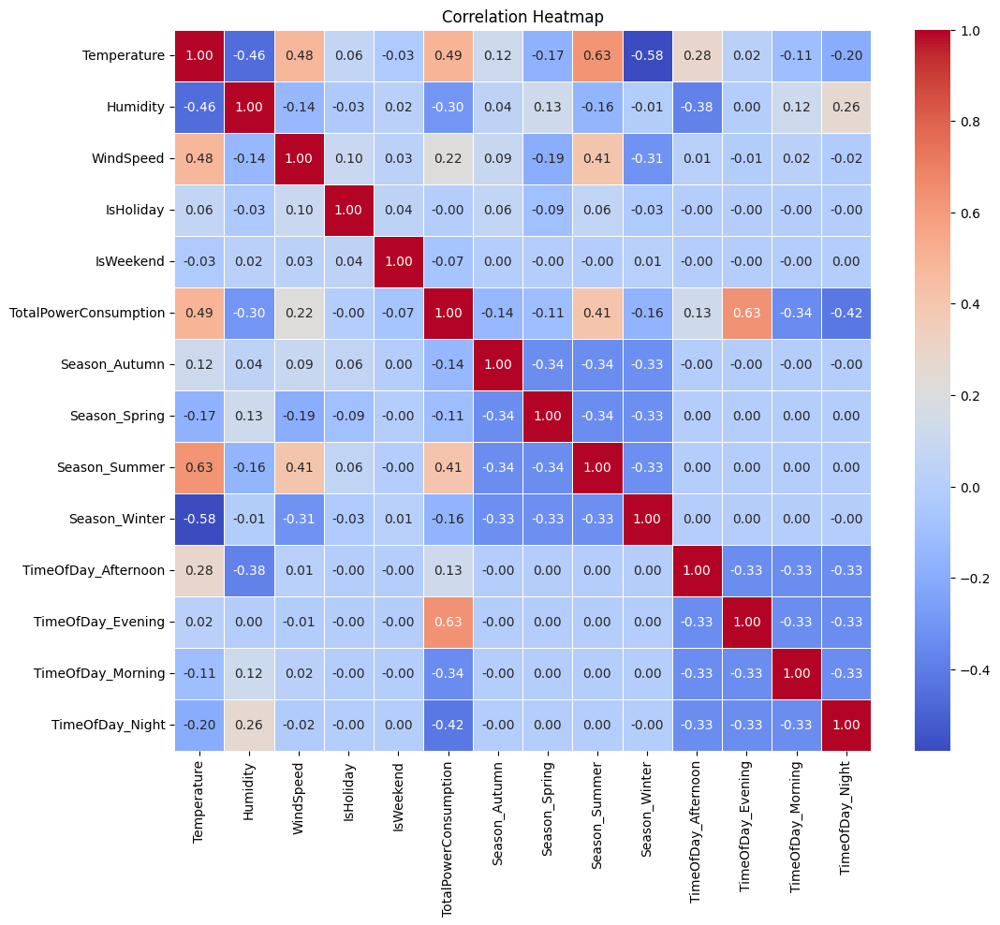

In [21]:
columns_to_include = ['Temperature', 'Humidity', 'WindSpeed',
       'Month', 'Day', 'Hour', 'IsHoliday', 'Weekday',
       'IsWeekend', 'TotalPowerConsumption',  'Season_Autumn', 'Season_Spring',
       'Season_Summer', 'Season_Winter', 'TimeOfDay_Afternoon', 'TimeOfDay_Evening',
       'TimeOfDay_Morning', 'TimeOfDay_Night']

# Check if columns exist in DataFrame
existing_columns = [col for col in columns_to_include if col in df.columns]

# Calculate correlation matrix
correlation_matrix = df[existing_columns].select_dtypes(include=['float64', 'int64']).corr()

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

## Resample

### Daily Resample

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


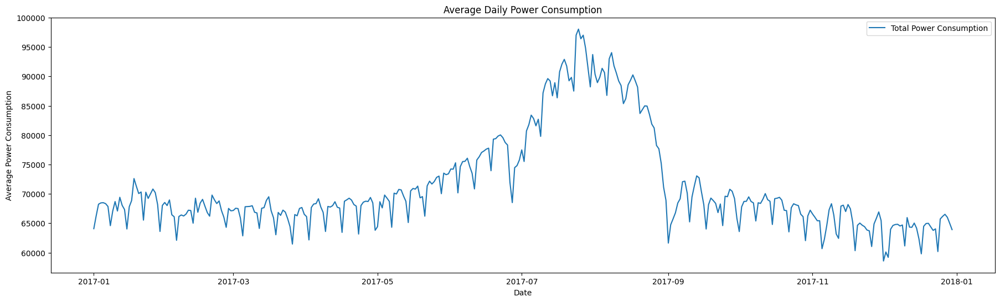

In [22]:
# Resample the 'TotalPowerConsumption' column to daily frequency and calculate the mean
daily_resampled = df['TotalPowerConsumption'].resample('D').mean()

# Plot daily Total Power Consumption
plt.figure(figsize=(22, 6))
sns.lineplot(data=daily_resampled)
plt.xlabel('Date')
plt.ylabel('Average Power Consumption')
plt.title('Average Daily Power Consumption')
plt.legend(labels=['Total Power Consumption'])
plt.show()

#### Per Capita Consumption


### Population in the city of Tetouan

The total population will be used to calculate per capita consumption, which is what we aim to predict in the models.



In [23]:
total_individuals = 399817
df['PerCapitaConsumption'] = df['TotalPowerConsumption'] / total_individuals

## Lag Shifted

In [24]:
numeric_cols = df.select_dtypes(include=['float64', 'int64', 'int32'])

# Resample data to calculate mean values for selected columns
df_grouped = numeric_cols.resample('h').mean()  # Resample hourly and take mean

# Columns to create lag features using mean values
columns_to_lag = [
    'Temperature', 'Humidity', 'WindSpeed'
]

# Lag values (2, 4, 6, ..., 48 hours)
lags = [x for x in range(2,49,2)]

# Create lag features on the grouped (mean) data
df_lagged = df_grouped.copy()

for col in columns_to_lag:
    for lag in lags:
        df_lagged[f'{col}_lag{lag}'] = df_grouped[col].shift(lag)

# Remove rows with NaN values due to lagging
df_lagged = df_lagged.dropna()
df_lagged.head()

,Temperature,Humidity,WindSpeed,Year,Month,Day,Hour,IsHoliday,IsWeekend,TotalPowerConsumption,Season_Autumn,Season_Spring,Season_Summer,Season_Winter,TimeOfDay_Afternoon,TimeOfDay_Evening,TimeOfDay_Morning,TimeOfDay_Night,PerCapitaConsumption,Temperature_lag2,Temperature_lag4,Temperature_lag6,Temperature_lag8,Temperature_lag10,Temperature_lag12,Temperature_lag14,Temperature_lag16,Temperature_lag18,Temperature_lag20,Temperature_lag22,Temperature_lag24,Temperature_lag26,Temperature_lag28,Temperature_lag30,Temperature_lag32,Temperature_lag34,Temperature_lag36,Temperature_lag38,Temperature_lag40,Temperature_lag42,Temperature_lag44,Temperature_lag46,Temperature_lag48,Humidity_lag2,Humidity_lag4,Humidity_lag6,Humidity_lag8,Humidity_lag10,Humidity_lag12,Humidity_lag14,Humidity_lag16,Humidity_lag18,Humidity_lag20,Humidity_lag22,Humidity_lag24,Humidity_lag26,Humidity_lag28,Humidity_lag30,Humidity_lag32,Humidity_lag34,Humidity_lag36,Humidity_lag38,Humidity_lag40,Humidity_lag42,Humidity_lag44,Humidity_lag46,Humidity_lag48,WindSpeed_lag2,WindSpeed_lag4,WindSpeed_lag6,WindSpeed_lag8,WindSpeed_lag10,WindSpeed_lag12,WindSpeed_lag14,WindSpeed_lag16,WindSpeed_lag18,WindSpeed_lag20,WindSpeed_lag22,WindSpeed_lag24,WindSpeed_lag26,WindSpeed_lag28,WindSpeed_lag30,WindSpeed_lag32,WindSpeed_lag34,WindSpeed_lag36,WindSpeed_lag38,WindSpeed_lag40,WindSpeed_lag42,WindSpeed_lag44,WindSpeed_lag46,WindSpeed_lag48
Datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2017-01-03 00:00:00,11.840000,75.533333,0.074833,2017.0,1.0,3.0,0.0,0.0,0.0,59671.767438,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.149248,12.876667,13.411667,14.206667,15.238333,15.563333,15.168333,12.865000,8.873333,9.336667,10.253333,11.031667,10.666667,12.791667,11.690000,14.013333,15.471667,15.766667,14.846667,6.145333,4.655167,4.571667,5.097667,5.054333,6.196833,68.675000,68.645000,65.691667,60.763333,55.986667,58.125000,74.436667,83.916667,84.650000,81.933333,76.750000,78.033333,66.206667,70.883333,65.273333,58.291667,55.636667,57.078333,69.635000,73.600000,75.750000,74.050000,78.933333,75.066667,0.074667,0.075167,0.076000,0.076000,0.075667,0.076000,0.076667,0.081833,0.076000,0.076167,0.077833,0.076667,0.074333,0.077167,0.077333,0.076000,0.076500,0.075667,3.738500,0.082667,0.082167,0.082333,0.082333,0.081833
2017-01-03 01:00:00,12.131667,72.566667,0.076500,2017.0,1.0,3.0,1.0,0.0,0.0,53044.344748,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.132672,12.473333,13.125000,13.523333,14.966667,15.475000,15.306667,15.050000,9.488333,9.543333,9.730000,10.568333,10.703333,11.711667,11.748333,11.810000,15.146667,15.558333,15.680000,9.893333,4.609167,4.453833,4.741667,5.004333,5.548833,71.716667,66.961667,69.695000,61.641667,57.263333,59.308333,58.008333,86.116667,84.900000,83.550000,79.266667,78.916667,72.506667,70.826667,70.208333,59.933333,58.191667,57.071667,58.036667,73.983333,73.400000,75.233333,77.083333,77.583333,0.074833,0.075333,0.075500,0.077333,0.075500,0.076333,0.076167,0.079833,0.077333,0.077000,0.077500,0.076167,0.075000,0.075333,0.077500,0.078500,0.074833,0.076667,2.088167,0.082167,0.082667,0.081000,0.082833,0.082000
2017-01-03 02:00:00,11.788333,73.883333,0.076833,2017.0,1.0,3.0,2.0,0.0,0.0,49677.844478,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.124251,11.840000,12.876667,13.411667,14.206667,15.238333,15.563333,15.168333,12.865000,8.873333,9.336667,10.253333,11.031667,10.666667,12.791667,11.690000,14.013333,15.471667,15.766667,14.846667,6.145333,4.655167,4.571667,5.097667,5.054333,75.533333,68.675000,68.645000,65.691667,60.763333,55.986667,58.125000,74.436667,83.916667,84.650000,81.933333,76.750000,78.033333,66.206667,70.883333,65.273333,58.291667,55.636667,57.078333,69.635000,73.600000,75.750000,74.050000,78.933333,0.074833,0.074667,0.075167,0.076000,0.076000,0.075667,0.076000,0.076667,0.081833,0.076000,0.076167,0.077833,0.076667,0.074333,0.077167,0.077333,0.076000,0.076500,0.075667,3.738500,0.082667,0.082167,0.082333,0.082333
2017-01-03 03:00:00,12.206667,73.933333

In [25]:
df_grouped.dtypes

Temperature              float64
Humidity                 float64
WindSpeed                float64
Year                     float64
Month                    float64
Day                      float64
Hour                     float64
IsHoliday                float64
IsWeekend                float64
TotalPowerConsumption    float64
Season_Autumn            float64
Season_Spring            float64
Season_Summer            float64
Season_Winter            float64
TimeOfDay_Afternoon      float64
TimeOfDay_Evening        float64
TimeOfDay_Morning        float64
TimeOfDay_Night          float64
PerCapitaConsumption     float64
dtype: object

## Per Capita Consumption analysis

Calculates the maximum per capita energy consumption by month and season.

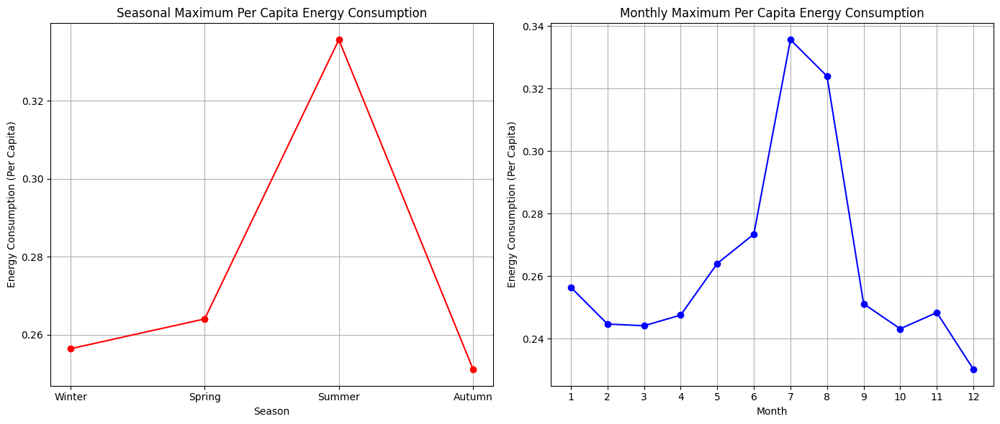

In [26]:
# Monthly maximum energy consumption for PerCapitaConsumption
monthly_max = df.groupby('Month')['PerCapitaConsumption'].max().reset_index()

# Generate a 'Season' column by summing one-hot encoded seasonal columns, ensuring they contain only 0 or 1 values.
df['Season'] = df[['Season_Winter', 'Season_Spring', 'Season_Summer', 'Season_Autumn']].idxmax(axis=1).str.replace('Season_', '')

# Seasonal maximum energy consumption for PerCapitaConsumption
seasonal_max = df.groupby('Season')['PerCapitaConsumption'].max().reset_index()

# To display seasons in order
seasonal_max['Season'] = pd.Categorical(seasonal_max['Season'], categories=['Winter', 'Spring', 'Summer', 'Autumn'], ordered=True)
seasonal_max = seasonal_max.sort_values('Season')

# Create a subplot figure with 1 row and 2 columns
plt.figure(figsize=(14, 6))

# Plot for seasonal maximum energy consumption
plt.subplot(1, 2, 1)
plt.plot(seasonal_max['Season'], seasonal_max['PerCapitaConsumption'], marker='o', linestyle='-', color='r')
plt.title('Seasonal Maximum Per Capita Energy Consumption')
plt.xlabel('Season')
plt.ylabel('Energy Consumption (Per Capita)')
plt.grid(True)

# Plot for monthly maximum energy consumption
plt.subplot(1, 2, 2)
plt.plot(monthly_max['Month'], monthly_max['PerCapitaConsumption'], marker='o', linestyle='-', color='b')
plt.title('Monthly Maximum Per Capita Energy Consumption')
plt.xlabel('Month')
plt.ylabel('Energy Consumption (Per Capita)')
plt.grid(True)
plt.xticks(range(1, 13))

plt.tight_layout()
plt.show()

#### Dropping encoded columns


In [27]:
df = df.drop(columns = ['Season'])
df = df.drop(columns = ['TotalPowerConsumption'])

## Scaling

The scaling is applied here to standardize the numerical values in the columns, bringing them between 0 and 1, to improve model performance and ensure that all variables have equal influence.

In [28]:
df_lagged = df_lagged.drop(columns = ['TotalPowerConsumption'])

In [29]:
# List of columns to scale
columns_to_scale = df_lagged.select_dtypes(include=['float64', 'int64']).columns
columns_to_scale= columns_to_scale.drop('PerCapitaConsumption')

# MinMaxScaler
scaler = MinMaxScaler()
df_lagged[columns_to_scale] = scaler.fit_transform(df_lagged[columns_to_scale])
pd.set_option('display.max_columns', None)
df_lagged.head()

,Temperature,Humidity,WindSpeed,Year,Month,Day,Hour,IsHoliday,IsWeekend,Season_Autumn,Season_Spring,Season_Summer,Season_Winter,TimeOfDay_Afternoon,TimeOfDay_Evening,TimeOfDay_Morning,TimeOfDay_Night,PerCapitaConsumption,Temperature_lag2,Temperature_lag4,Temperature_lag6,Temperature_lag8,Temperature_lag10,Temperature_lag12,Temperature_lag14,Temperature_lag16,Temperature_lag18,Temperature_lag20,Temperature_lag22,Temperature_lag24,Temperature_lag26,Temperature_lag28,Temperature_lag30,Temperature_lag32,Temperature_lag34,Temperature_lag36,Temperature_lag38,Temperature_lag40,Temperature_lag42,Temperature_lag44,Temperature_lag46,Temperature_lag48,Humidity_lag2,Humidity_lag4,Humidity_lag6,Humidity_lag8,Humidity_lag10,Humidity_lag12,Humidity_lag14,Humidity_lag16,Humidity_lag18,Humidity_lag20,Humidity_lag22,Humidity_lag24,Humidity_lag26,Humidity_lag28,Humidity_lag30,Humidity_lag32,Humidity_lag34,Humidity_lag36,Humidity_lag38,Humidity_lag40,Humidity_lag42,Humidity_lag44,Humidity_lag46,Humidity_lag48,WindSpeed_lag2,WindSpeed_lag4,WindSpeed_lag6,WindSpeed_lag8,WindSpeed_lag10,WindSpeed_lag12,WindSpeed_lag14,WindSpeed_lag16,WindSpeed_lag18,WindSpeed_lag20,WindSpeed_lag22,WindSpeed_lag24,WindSpeed_lag26,WindSpeed_lag28,WindSpeed_lag30,WindSpeed_lag32,WindSpeed_lag34,WindSpeed_lag36,WindSpeed_lag38,WindSpeed_lag40,WindSpeed_lag42,WindSpeed_lag44,WindSpeed_lag46,WindSpeed_lag48
Datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2017-01-03 00:00:00,0.228240,0.765765,0.003430,0.0,0.0,0.066667,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.149248,0.256962,0.271785,0.293812,0.322395,0.331400,0.320456,0.256639,0.146045,0.158882,0.184279,0.205844,0.195731,0.254607,0.224084,0.288455,0.328860,0.337034,0.311544,0.070462,0.029175,0.026861,0.041435,0.040234,0.071889,0.682167,0.681802,0.645803,0.585731,0.527507,0.553571,0.752397,0.867951,0.876889,0.843775,0.780595,0.796238,0.652080,0.709085,0.640704,0.555603,0.523241,0.540813,0.693869,0.742199,0.768406,0.747684,0.807208,0.760076,0.003402,0.003487,0.003629,0.003629,0.003572,0.003629,0.003742,0.004621,0.003629,0.003657,0.003941,0.003742,0.003345,0.003827,0.003856,0.003629,0.003714,0.003572,0.626609,0.004763,0.004678,0.004706,0.004706,0.004621
2017-01-03 01:00:00,0.236321,0.729603,0.003714,0.0,0.0,0.066667,0.043478,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.132672,0.245787,0.263843,0.274879,0.314869,0.328953,0.324289,0.317177,0.163084,0.164608,0.169780,0.193007,0.196747,0.224684,0.225700,0.227409,0.319856,0.331262,0.334632,0.174305,0.027900,0.023597,0.031571,0.038849,0.053935,0.719243,0.661283,0.694600,0.596437,0.543068,0.567995,0.552149,0.894767,0.879937,0.863481,0.811271,0.807005,0.728872,0.708394,0.700857,0.575614,0.554384,0.540732,0.552495,0.746871,0.739761,0.762108,0.784658,0.790752,0.003430,0.003515,0.003544,0.003856,0.003544,0.003685,0.003657,0.004281,0.003856,0.003799,0.003884,0.003657,0.003459,0.003515,0.003884,0.004054,0.003430,0.003742,0.345892,0.004678,0.004763,0.004479,0.004791,0.004649
2017-01-03 02:00:00,0.226809,0.745653,0.003770,0.0,0.0,0.066667,0.086957,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.124251,0.228240,0.256962,0.271785,0.293812,0.322395,0.331400,0.320456,0.256639,0.146045,0.158882,0.184279,0.205844,0.195731,0.254607,0.224084,0.288455,0.328860,0.337034,0.311544,0.070462,0.029175,0.026861,0.041435,0.040234,0.765765,0.682167,0.681802,0.645803,0.585731,0.527507,0.553571,0.752397,0.867951,0.876889,0.843775,0.780595,0.796238,0.652080,0.709085,0.640704,0.555603,0.523241,0.540813,0.693869,0.742199,0.768406,0.747684,0.807208,0.003430,0.003402,0.003487,0.003629,0.003629,0.003572,0.003629,0.003742,0.004621,0.003629,0.003657,0.003941,0.003742,0.003345,0.003827,0.003856,0.003629,0.003714,0.003572,0.626609,0.004763,0.004678,0.004706,0.004706
2017-01-03 03:00:00,0.238399,0.746262,0.003657,0.0,0.0,0.066667,0.130435,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.119879,0.236321,0.245787,0.263843,0.274879,0.314869,0.328953,0.324289,0.317177,0.163084,0.1

## Models

### K-Means


**K-Means** revealed distinct energy consumption patterns by clustering based on environmental and time factors, supporting optimized management strategies.

Key points:
1. **Segmentation**: Divided data into three clusters, each with unique patterns influenced by weather and time.
2. **Consumption variation**: Clusters differ in consumption levels under specific conditions.
3. **Cluster centers**: Red points mark average values, indicating key factors like temperature and time affecting consumption.

#### Step 1: Determine the Number of Clusters

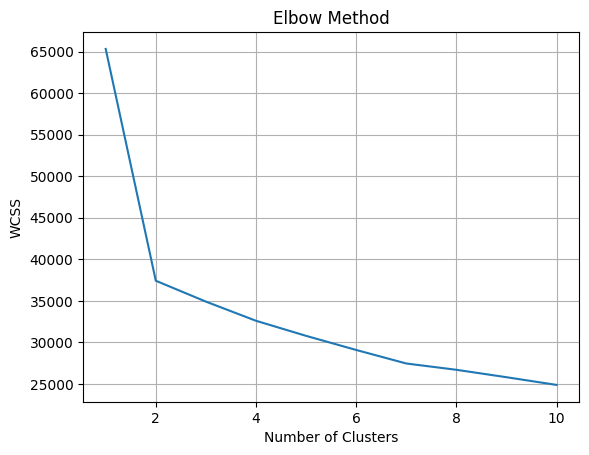

In [30]:
# Determine the optimal number of clusters using the Elbow Method
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=20, random_state=43)
    kmeans.fit(df_lagged[columns_to_scale])
    wcss.append(kmeans.inertia_)

# Plot the results of the Elbow Method
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid()
plt.show()

##### The silhouette_score is a reliable indicator to help finalize the choice among 2, 3, 4, and 5 clusters. 
After evaluating, the silhouette scores, 2 clusters were identified as the best option.


In [31]:
cluster_range = range(2, 6)

# Loop through the cluster range
for n_clusters in cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, init='k-means++', max_iter=300, n_init=20, random_state=42)
    kmeans.fit(df_lagged[columns_to_scale])
    score = silhouette_score(df_lagged[columns_to_scale], kmeans.labels_)
    print(f'Silhouette Score for {n_clusters} clusters: {score}')

Silhouette Score for 2 clusters: 0.3871688473017733
Silhouette Score for 3 clusters: 0.20338550570740918
Silhouette Score for 4 clusters: 0.1297261945834731
Silhouette Score for 5 clusters: 0.13641929338643216


#### Step 2: Apply the K-means Algorithm

In [32]:
kmeans = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
df_lagged['Cluster'] = kmeans.fit_predict(df_lagged[columns_to_scale])

# Add the clusters to the original DataFrame
df_lagged['Cluster'] = kmeans.labels_

#### Step 3: Analyze and Visualize the Results

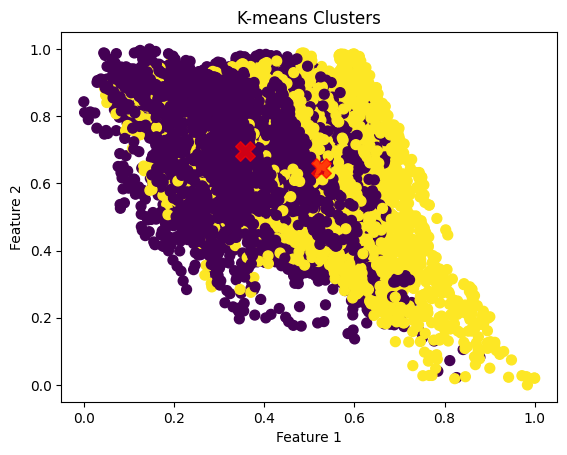

In [33]:
# Calculate the mean values for each cluster
cluster_means = df_lagged.groupby('Cluster').mean()

# Visualize the clusters
plt.scatter(df_lagged[columns_to_scale].iloc[:, 0], df_lagged[columns_to_scale].iloc[:, 1], c=df_lagged['Cluster'], s=50, cmap='viridis')

# Also visualize the cluster centers
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75, marker='X')
plt.title('K-means Clusters')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.show()

## Time Series

### ARIMA

ARIMA was applied to capture time-based patterns in Per Capita Consumption, as it’s a common choice for univariate time series forecasting. However, the model produced a constant prediction line, showing its limitation when only time is considered. This result suggests that additional influential factors must be included for more accurate forecasting.

Checking stationarity of Per Capita Consumption series with ADF test for ARIMA readiness.

In [34]:
from statsmodels.tsa.stattools import adfuller
series = df['PerCapitaConsumption']

result = adfuller(series)
print('ADF Statistic:', result[0])
print('p-value:', result[1])


ADF Statistic: -26.567629573254504
p-value: 0.0


In [35]:
split_ratio = 0.7
split_index = int(len(series) * split_ratio)
train, test = series[:split_index], series[split_index:]

In [36]:
from statsmodels.tsa.arima.model import ARIMA
ARIMA_model = ARIMA(train, order=(1,1,5))
ARIMA_model_fit = ARIMA_model.fit()

print(ARIMA_model_fit.summary())

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


                                SARIMAX Results                                 
Dep. Variable:     PerCapitaConsumption   No. Observations:                36691
Model:                   ARIMA(1, 1, 5)   Log Likelihood              177528.736
Date:                  Wed, 23 Apr 2025   AIC                        -355043.472
Time:                          16:06:43   BIC                        -354983.900
Sample:                      01-01-2017   HQIC                       -355024.539
                           - 09-12-2017                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8538      0.007    115.224      0.000       0.839       0.868
ma.L1         -0.0113      0.007     -1.519      0.129      -0.026       0.003
ma.L2         -0.0404      0.007    

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-407202.629, Time=22.62 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-358049.567, Time=2.64 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-407167.631, Time=2.59 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-379508.861, Time=5.53 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-358051.564, Time=0.88 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-407195.038, Time=6.76 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-407186.640, Time=18.89 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=-405602.623, Time=33.87 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=-407202.643, Time=26.66 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=-407197.615, Time=18.80 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=-407192.905, Time=30.13 sec
 ARIMA(2,1,4)(0,0,0)[0] intercept   : AIC=-407199.302, Time=31.69 sec
 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=-407204.203, Time=33.11 sec
 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=-400473.60

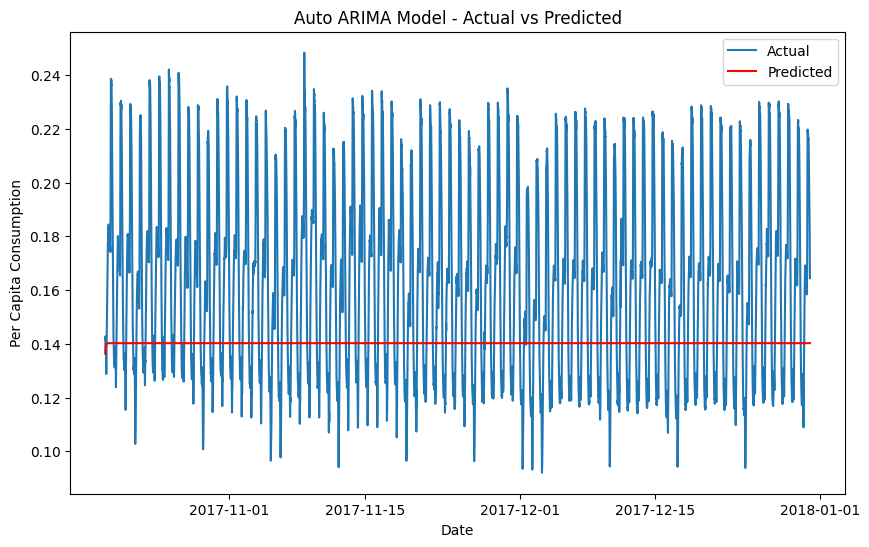

Mean Squared Error (MSE): 0.001728614962433188
Mean Absolute Error (MAE): 0.03291315987375868


In [37]:
from pmdarima import auto_arima
split_ratio = 0.8
split_index = int(len(series) * split_ratio)
train, test = series[:split_index], series[split_index:]

# Automatically determine the best ARIMA parameters
ARIMA_auto_model = auto_arima(train, seasonal=False, trace=True)

ARIMA_auto_model.fit(train)

forecast = ARIMA_auto_model.predict(n_periods=len(test))

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(test.index, test, label='Actual')
plt.plot(test.index, forecast, label='Predicted', color='red')
plt.title('Auto ARIMA Model - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Per Capita Consumption')
plt.legend()
plt.show()

# Calculate MSE and MAE for evaluation
mse = mean_squared_error(test, forecast)
mae = mean_absolute_error(test, forecast)
print(f'Mean Squared Error (MSE): {mse}')
print(f'Mean Absolute Error (MAE): {mae}')


### SARIMA

In [38]:
split_ratio = 0.8
split_index = int(len(series) * split_ratio)
train, test = series[:split_index], series[split_index:]


In [39]:
import pmdarima as pm
smodel = pm.auto_arima(train, seasonal=True, m=12,
                       start_p=0, max_p=2, max_d=2, start_q=0, max_q=2,
                       start_P=0, max_P=3, max_D=1, start_Q=0, max_Q=3,
                       trace=True, error_action='ignore', suppress_warnings=True)


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=-358049.567, Time=2.66 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=-406483.276, Time=22.24 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=-380456.819, Time=25.55 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=-358051.564, Time=0.86 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=-407167.631, Time=2.43 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=-406568.142, Time=20.79 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=-406553.292, Time=47.19 sec
 ARIMA(2,1,0)(0,0,0)[12] intercept   : AIC=-407180.985, Time=3.97 sec
 ARIMA(2,1,0)(1,0,0)[12] intercept   : AIC=-406502.486, Time=49.96 sec
 ARIMA(2,1,0)(0,0,1)[12] intercept   : AIC=-406587.699, Time=22.02 sec
 ARIMA(2,1,0)(1,0,1)[12] intercept   : AIC=-406572.525, Time=27.51 sec
 ARIMA(2,1,1)(0,0,0)[12] intercept   : AIC=-407186.640, Time=18.41 sec
 ARIMA(2,1,1)(1,0,0)[12] intercept   : AIC=-406433.930, Time=53.54 sec
 ARIMA(2,1,1)(0,0,1)[12] intercept   :

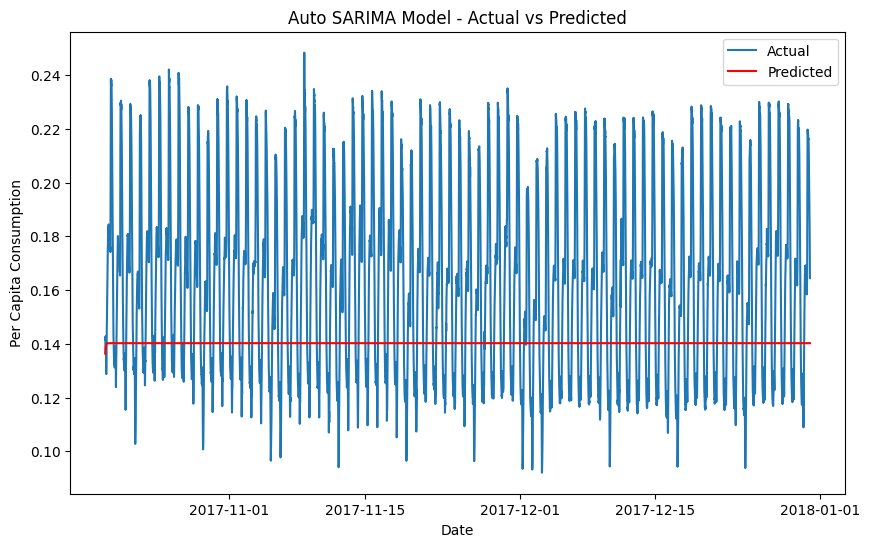

Mean Squared Error (MSE): 0.001728614962433188
Mean Absolute Error (MAE): 0.03291315987375868


In [40]:
# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(test.index, test, label='Actual')
plt.plot(test.index, forecast, label='Predicted', color='red')
plt.title('Auto SARIMA Model - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Per Capita Consumption')
plt.legend()
plt.show()

# Calculate MSE and MAE for evaluation
mse = mean_squared_error(test, forecast)
mae = mean_absolute_error(test, forecast)
print(f'Mean Squared Error (MSE): {mse}')
print(f'Mean Absolute Error (MAE): {mae}')

## Linear Regression

The model performs well in minimizing errors, but with an **R² of 0.454**, there's still room for improvement in explaining more variance in the data.

In [41]:
X = df_lagged.drop(columns=['PerCapitaConsumption'])
y = df_lagged['PerCapitaConsumption']


In [42]:
train_size = 0.7
index = round(train_size * df_lagged.shape[0])

# Splitting for Time series
X_train = X.iloc[:index]
X_test = X.iloc[index:]

y_train = y.iloc[:index]
y_test = y.iloc[index:]

print(f"Training data shape: X_train={X_train.shape}, y_train={y_train.shape}")
print(f"Test data shape: X_test={X_test.shape}, y_test={y_test.shape}")


Training data shape: X_train=(6082, 90), y_train=(6082,)
Test data shape: X_test=(2606, 90), y_test=(2606,)


In [43]:
from sklearn.linear_model import LinearRegression
model1 = LinearRegression()

model1.fit(X_train, y_train)
y_pred = model1.predict(X_test)


In [44]:
# Calculate the root mean square error (RMSE) and R²
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'Mean Squared Error (MSE): {mse}')
print(f'Mean Absolute Error (MAE): {mae}')
print(f'R-squared (R²): {r2}')

Root Mean Squared Error (RMSE): 0.025504851485860347
Mean Squared Error (MSE): 0.0006504974493157927
Mean Absolute Error (MAE): 0.018805818451581684
R-squared (R²): 0.45416590948567814


The plot shows that while the predicted values follow the trend of the true values for both the training and test sets, there is noticeable scatter, especially in the test set. 

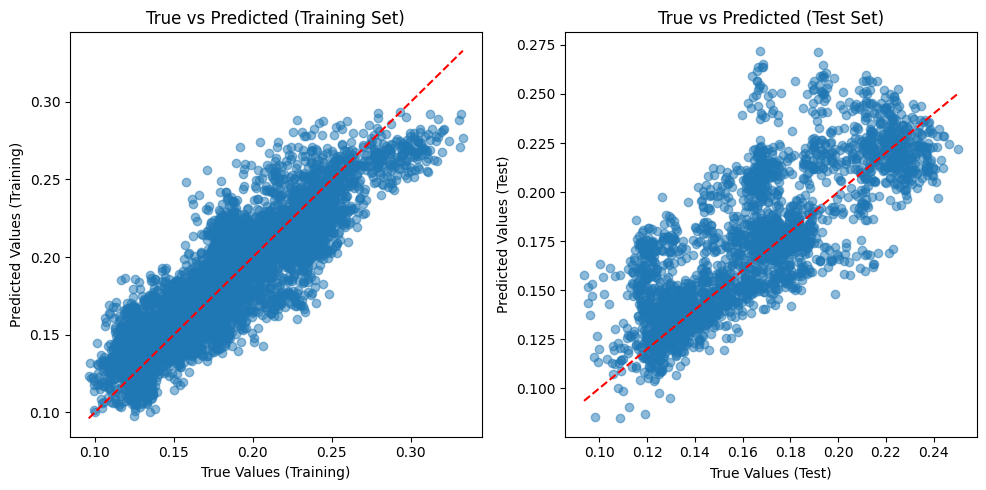

In [45]:
# Predict using the training set
y_train_pred = model1.predict(X_train)

# Plot the true vs predicted values for training set
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.scatter(y_train, y_train_pred, alpha=0.5)
plt.plot([min(y_train), max(y_train)], [min(y_train), max(y_train)], color='red', linestyle='--')
plt.xlabel('True Values (Training)')
plt.ylabel('Predicted Values (Training)')
plt.title('True vs Predicted (Training Set)')

# Plot the true vs predicted values for test set
y_test_pred = model1.predict(X_test)

plt.subplot(1, 2, 2)
plt.scatter(y_test, y_test_pred, alpha=0.5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--')
plt.xlabel('True Values (Test)')
plt.ylabel('Predicted Values (Test)')
plt.title('True vs Predicted (Test Set)')

plt.tight_layout()
plt.show()

## Train RandomForest Models


The results appears reasonable and highly suitable given the available metrics. The high values of R² indicate that the model explains the variation in energy consumption for each zone effectively, while the low values of MSE and MAE suggest that the actual errors are minimal.

Based on these metrics, it seems that the model is accurate and logical concerning your objective of predicting energy consumption for each zone. If these features have been used and the validity of the values is confirmed, this suggests that the model is performing efficiently and is well-suited for analyzing energy consumption.

In [46]:
X = df_lagged.drop(['PerCapitaConsumption'], axis=1, errors='ignore')
y = df_lagged['PerCapitaConsumption']


In [47]:
train_size = 0.7
index = round(train_size * df_lagged.shape[0])

X_train = X.iloc[:index]
X_test = X.iloc[index:]

y_train = y.iloc[:index]
y_test = y.iloc[index:]


In [48]:
from sklearn.ensemble import RandomForestRegressor

RFmodel1 = RandomForestRegressor(random_state=0)

RFmodel1.fit(X_train, y_train)
y_pred = RFmodel1.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error (MSE):", mse)
print("Mean Absolute Error (MAE):", mae)
print("R-squared (R^2):", r2)

Mean Squared Error (MSE): 0.00026526914548286073
Mean Absolute Error (MAE): 0.013466641362847278
R-squared (R^2): 0.777411974607364


Plotting learning curves using the R² metric to evaluate the performance of the Random Forest Regressor model.

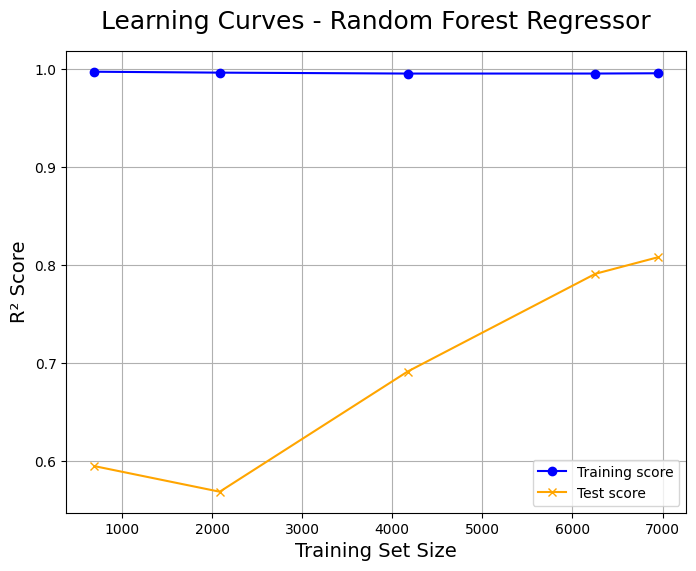

In [49]:
train_sizes = [0.1, 0.3, 0.6, 0.9, 1]

# Generate learning curves
train_sizes, train_scores, test_scores = learning_curve(
    estimator=RFmodel1, X=X, y=y, train_sizes=train_sizes, cv=5, scoring='r2'
)

train_scores_mean = np.mean(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)

# Plot the learning curves
plt.figure(figsize=(8, 6))
plt.plot(train_sizes, train_scores_mean, label='Training score', marker='o', color='blue')
plt.plot(train_sizes, test_scores_mean, label='Test score', marker='x', color='orange')
plt.ylabel('R² Score', fontsize=14)
plt.xlabel('Training Set Size', fontsize=14)
plt.title('Learning Curves - Random Forest Regressor', fontsize=18, y=1.03)
plt.legend(loc='best')
plt.grid(True)
plt.show()

<!-- نشيك عليه -->

## Train lightgbm Models

The model trained using LightGBM performed well, achieving a **Mean Squared Error (MSE)** of 0.0051, a **Mean Absolute Error (MAE)** of 0.0597, and an **R-squared (R²)** of 75.43%. This indicates that the model can make accurate predictions, though with slightly lower precision compared to the previous model.

In [50]:
model1 = lgb.LGBMRegressor(random_state=0)

model1.fit(X_train, y_train)

y1_pred = model1.predict(X_test)

print("Mean Squared Error (MSE):",  np.mean((y1_pred - y_test)**2))
print("Mean Absolute Error (MAE):",  mean_absolute_error(y_test, y1_pred))
print("R-squared (R²):", r2_score(y_test, y1_pred))

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002686 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 19211
[LightGBM] [Info] Number of data points in the train set: 6082, number of used features: 89
[LightGBM] [Info] Start training from score 0.183790
Mean Squared Error (MSE): 0.00028109213741914587
Mean Absolute Error (MAE): 0.014040266626088673
R-squared (R²): 0.7641348611892531


The plot shows that the training error is low and stable, while the validation error decreases as the training set size increases, indicating improved model performance with more data and no overfitting issues.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.052423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 10794
[LightGBM] [Info] Number of data points in the train set: 486, number of used features: 86
[LightGBM] [Info] Start training from score 0.167820
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

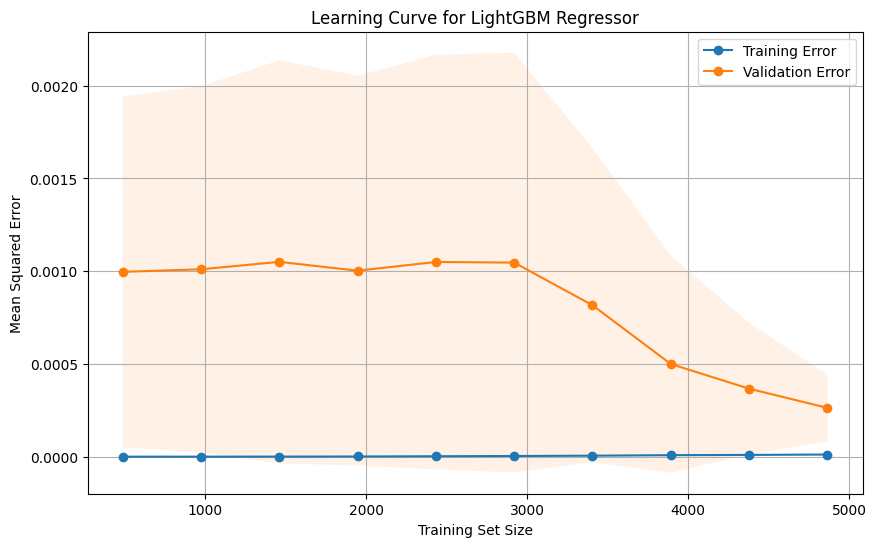

In [51]:
from lightgbm import LGBMRegressor
model1 = lgb.LGBMRegressor(random_state=0)

# Generate the learning curve data
train_sizes, train_scores, validation_scores = learning_curve(
    estimator=model1,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

train_scores_mean = -np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
validation_scores_mean = -np.mean(validation_scores, axis=1)
validation_scores_std = np.std(validation_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Error', marker='o')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.1)
plt.plot(train_sizes, validation_scores_mean, label='Validation Error', marker='o')
plt.fill_between(train_sizes, validation_scores_mean - validation_scores_std,
                 validation_scores_mean + validation_scores_std, alpha=0.1)

plt.title('Learning Curve for LightGBM Regressor')
plt.xlabel('Training Set Size')
plt.ylabel('Mean Squared Error')
plt.legend(loc='best')
plt.grid(True)
plt.show()

## Train XGBoost Models

The XGBoost model achieved the best results, with a low MAE of 0.0115 and an R² of 81.73%, indicating high predictive accuracy with minimal errors.


In [52]:
# Define parameter grid
param_grid = {
    'max_depth': [3, 4, 5, 6, 7],
    'learning_rate': [0.01, 0.05, 0.1],
    'n_estimators': [100, 300, 500, 700],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'min_child_weight': [1, 3, 5]
}

# Create the XGBoost regressor
xgb_model = xgb.XGBRegressor(objective='reg:squarederror', eval_metric='rmse')

# Create GridSearchCV
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2)

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

# Best parameters
print("Best parameters found: ", grid_search.best_params_)

# Use the best parameters to train the final model
best_params = grid_search.best_params_
xgb_model_optimized = xgb.XGBRegressor(**best_params)
xgb_model_optimized.fit(X_train, y_train)

# Make predictions
y_pred_optimized = xgb_model_optimized.predict(X_test)

# Evaluate
mse_optimized = mean_squared_error(y_test, y_pred_optimized)
r2_optimized = r2_score(y_test, y_pred_optimized)
print(f"Optimized Mean Squared Error (MSE): {mse_optimized:.4f}")
print(f"Optimized R-squared (R²): {r2_optimized:.4f}")


Fitting 3 folds for each of 1620 candidates, totalling 4860 fits

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further sp

Prepare the Data

In [53]:
# Define features (X) and target variable (y) from the dataset
X = df_lagged.drop(columns=['PerCapitaConsumption'])
y = df_lagged['PerCapitaConsumption']

# Split the data into training and testing sets based on time series order
train_size = 0.7
index = round(train_size * df_lagged.shape[0])
X_train = X.iloc[:index]
X_test = X.iloc[index:]
y_train = y.iloc[:index]
y_test = y.iloc[index:]

Train the Model

In [54]:
# Convert the training and testing data into DMatrix, which is required by XGBoost
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

# Set up the parameters for the XGBoost model
params = {
    'max_depth': 2,
    'learning_rate': 0.01,
    'objective': 'reg:squarederror',
    'eval_metric': 'rmse'
}
# Create a dictionary to store evaluation results and train the XGBoost model
evals_result = {}

xgb_model = xgb.train(
    params,
    dtrain,
    num_boost_round=500,
    evals=[(dtrain, 'train'), (dtest, 'eval')],
    early_stopping_rounds=10,
    evals_result=evals_result,
    verbose_eval=False
)

# Make predictions on the test set
y_pred = xgb_model.predict(dtest)

# Calculate performance metrics
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print results
print(f"Mean Absolute Error (MAE): {mae:.4f}")
print(f"Mean Squared Error (MSE): {mse:.4f}")
print(f"R-squared (R²): {r2:.4f}")

Mean Absolute Error (MAE): 0.0115
Mean Squared Error (MSE): 0.0002
R-squared (R²): 0.8173


Visualize Training and Validation Performance

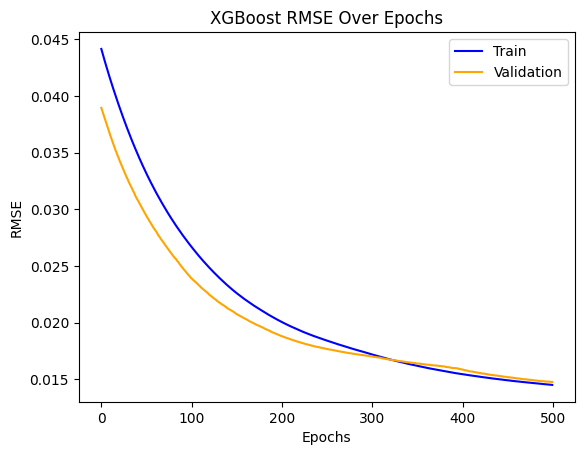

In [55]:
epochs = len(evals_result['train']['rmse'])
x_axis = range(0, epochs)

fig, ax = plt.subplots()

ax.plot(x_axis, evals_result['train']['rmse'], label='Train', color='blue')
ax.plot(x_axis, evals_result['eval']['rmse'], label='Validation', color='orange')

ax.legend()
plt.xlabel('Epochs')
plt.ylabel('RMSE')
plt.title('XGBoost RMSE Over Epochs')

plt.show()

Saving the Model: Exporting the XGBoost Pipeline as a Pickle File

In [56]:
import pickle

# Export Pipeline as pickle file
with open("xgb_model.pkl", "wb") as file:
    pickle.dump(xgb_model, file)

with open("model2.pkl", "wb") as file:
    pickle.dump(grid_search.best_estimator_, file)

## RNN: LSTM

The LSTM model shows good performance with a low MAE of 0.0132, explaining 70.5% of the variance (R² = 0.7051). The performance is stable on both the training and validation sets, but there is slight room for improvement.

In [57]:
X = df.drop([['PerCapitaConsumption']], axis=1, errors='ignore')
y = df['PerCapitaConsumption']

In [58]:
train_size = 0.7
index = round(train_size * df.shape[0])

X_train = X.iloc[:index]
X_test = X.iloc[index:]

y_train = y.iloc[:index]
y_test = y.iloc[index:]

X_train = X_train.values.reshape((X_train.shape[0], 1, X_train.shape[1]))
X_test = X_test.values.reshape((X_test.shape[0], 1, X_test.shape[1]))


In [59]:
normalizer = Normalization()
normalizer.adapt(X_train)

model_LSTM = Sequential()
model_LSTM.add(normalizer)
model_LSTM.add(LSTM(units=20, activation='tanh'))
model_LSTM.add(Dense(10, activation='relu'))
model_LSTM.add(Dense(1, activation='linear'))

model_LSTM.compile(loss='mse', optimizer='adam', metrics=['mae'])

I0000 00:00:1745435395.735933      20 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


In [60]:
es = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

history_LSTM = model_LSTM.fit(X_train, y_train, validation_split=0.2, batch_size=32, epochs=100, verbose=2, callbacks=[es])
y_pred = model_LSTM.predict(X_test)

Epoch 1/100


I0000 00:00:1745435400.596582     705 cuda_dnn.cc:529] Loaded cuDNN version 90300


918/918 - 9s - 9ms/step - loss: 0.0017 - mae: 0.0193 - val_loss: 0.0072 - val_mae: 0.0470
Epoch 2/100
918/918 - 3s - 4ms/step - loss: 2.8206e-05 - mae: 0.0040 - val_loss: 0.0084 - val_mae: 0.0471
Epoch 3/100
918/918 - 3s - 4ms/step - loss: 1.0120e-05 - mae: 0.0024 - val_loss: 0.0088 - val_mae: 0.0472
Epoch 4/100
918/918 - 3s - 4ms/step - loss: 5.1678e-06 - mae: 0.0017 - val_loss: 0.0091 - val_mae: 0.0477
Epoch 5/100
918/918 - 3s - 4ms/step - loss: 3.1320e-06 - mae: 0.0013 - val_loss: 0.0094 - val_mae: 0.0479
Epoch 6/100
918/918 - 4s - 4ms/step - loss: 2.0998e-06 - mae: 0.0011 - val_loss: 0.0096 - val_mae: 0.0478
Epoch 7/100
918/918 - 3s - 4ms/step - loss: 1.5176e-06 - mae: 9.3886e-04 - val_loss: 0.0099 - val_mae: 0.0483
Epoch 8/100
918/918 - 3s - 4ms/step - loss: 1.2283e-06 - mae: 8.4130e-04 - val_loss: 0.0102 - val_mae: 0.0489
Epoch 9/100
918/918 - 3s - 4ms/step - loss: 9.6575e-07 - mae: 7.4920e-04 - val_loss: 0.0105 - val_mae: 0.0494
Epoch 10/100
918/918 - 3s - 4ms/step - loss: 8.357

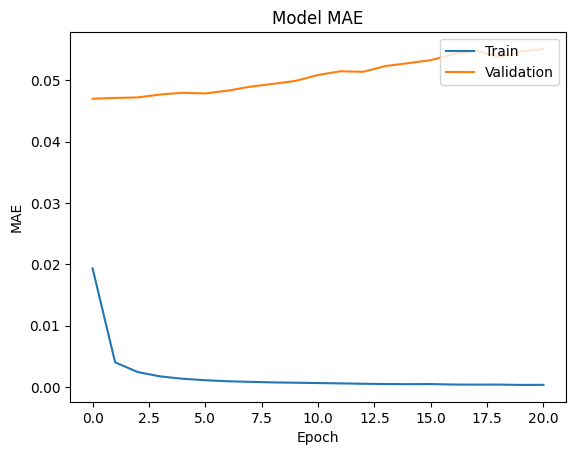

492/492 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0592 - mae: 0.2299
Model Mean Absolute Error (LSTM): 0.1777
R^2: -34.9618
Mean Squared Error (MSE): 0.0438


In [61]:
plt.plot(history_LSTM.history['mae'])
plt.plot(history_LSTM.history['val_mae'])
plt.title('Model MAE')
plt.ylabel('MAE')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

# Evaluate the model on the test set
lstm_mae = model_LSTM.evaluate(X_test, y_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print(f'Model Mean Absolute Error (LSTM): {lstm_mae[1]:.4f}')
print(f"R^2: {r2:.4f}")
print(f'Mean Squared Error (MSE): {mse:.4f}')

## RNN: GRU

The GRU model shows a significant drop in MAE for both training and validation data, indicating good initial learning. However, the extremely negative R² value (-907.5975) suggests a major issue with the model's ability to generalize, indicating poor performance in predicting validation data, which may require adjustments to the model or input data.

In [62]:
X = df.drop(['PerCapitaConsumption'], axis=1, errors='ignore').resample('D').mean()
y = df['PerCapitaConsumption'].resample('D').mean()

In [63]:
train_size = 0.7
index = round(train_size * len(X))

X_train = X.iloc[:index]
X_test = X.iloc[index:]

y_train = y.iloc[:index]
y_test = y.iloc[index:]

# Reshape the data to 3D for GRU
X_train = X_train.values.reshape((X_train.shape[0], 1, X_train.shape[1]))
X_test = X_test.values.reshape((X_test.shape[0], 1, X_test.shape[1]))


In [64]:
normalizer = Normalization()
normalizer.adapt(X_train)

model_GRU = Sequential()
model_GRU.add(normalizer)
model_GRU.add(GRU(units=20, activation='tanh', return_sequences=False))
model_GRU.add(Dense(10, activation='relu'))
model_GRU.add(Dense(1, activation='linear'))

model_GRU.compile(loss='mse', optimizer='adam', metrics=['mae'])

In [65]:
es = EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True)

history_GRU = model_GRU.fit(X_train, y_train, validation_split=0.2, batch_size=32, epochs=100, verbose=2, callbacks=[es])

y_pred = model_GRU.predict(X_test)

Epoch 1/100
7/7 - 2s - 346ms/step - loss: 0.0385 - mae: 0.1632 - val_loss: 0.0290 - val_mae: 0.1462
Epoch 2/100
7/7 - 0s - 10ms/step - loss: 0.0180 - mae: 0.1134 - val_loss: 0.0160 - val_mae: 0.1068
Epoch 3/100
7/7 - 0s - 10ms/step - loss: 0.0091 - mae: 0.0810 - val_loss: 0.0158 - val_mae: 0.1002
Epoch 4/100
7/7 - 0s - 9ms/step - loss: 0.0054 - mae: 0.0585 - val_loss: 0.0171 - val_mae: 0.1048
Epoch 5/100
7/7 - 0s - 9ms/step - loss: 0.0038 - mae: 0.0462 - val_loss: 0.0166 - val_mae: 0.1035
Epoch 6/100
7/7 - 0s - 10ms/step - loss: 0.0031 - mae: 0.0412 - val_loss: 0.0157 - val_mae: 0.0994
Epoch 7/100
7/7 - 0s - 10ms/step - loss: 0.0028 - mae: 0.0392 - val_loss: 0.0151 - val_mae: 0.0969
Epoch 8/100
7/7 - 0s - 10ms/step - loss: 0.0025 - mae: 0.0364 - val_loss: 0.0148 - val_mae: 0.0949
Epoch 9/100
7/7 - 0s - 9ms/step - loss: 0.0022 - mae: 0.0336 - val_loss: 0.0145 - val_mae: 0.0925
Epoch 10/100
7/7 - 0s - 10ms/step - loss: 0.0019 - mae: 0.0312 - val_loss: 0.0145 - val_mae: 0.0909
Epoch 11/10

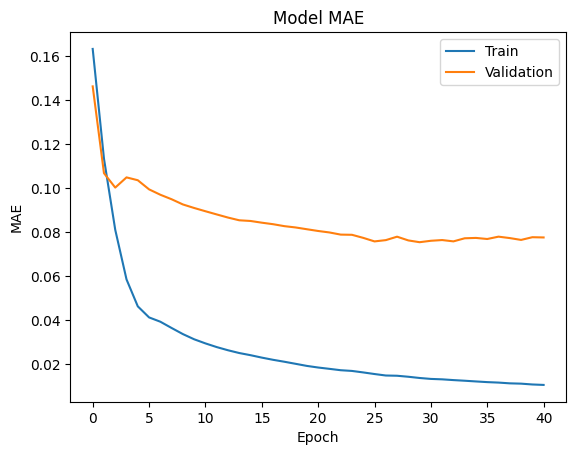

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0634 - mae: 0.2216 
Model Mean Absolute Error (GRU): 0.2490
R^2: -1648.1611


In [66]:
plt.plot(history_GRU.history['mae'])
plt.plot(history_GRU.history['val_mae'])
plt.title('Model MAE')
plt.ylabel('MAE')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

# Evaluate the model on the test set
gru_mae = model_GRU.evaluate(X_test, y_test)
r2 = r2_score(y_test, y_pred)

print(f'Model Mean Absolute Error (GRU): {gru_mae[1]:.4f}')
print(f"R^2: {r2:.4f}")

## Multilayer Perceptron model (MLP)

The second model shows that the **training error** started very high but quickly dropped within the first epoch. Meanwhile, the **validation error** remained consistently low throughout the training, indicating that the model performs well after adjusting the learning rate.

In [67]:
X = df_lagged.drop(['PerCapitaConsumption'], axis=1, errors='ignore')
y = df_lagged['PerCapitaConsumption']

In [68]:
train_size = 0.6
index = round(train_size * df_lagged.shape[0])

X_train = X.iloc[:index]
X_test = X.iloc[index:]

y_train = y.iloc[:index]
y_test = y.iloc[index:]

epochs = 500
batch = 256
lr = 0.1

adam = Adam(learning_rate=lr)

In [69]:
model_mlp2 = Sequential()

# Layer with an increased number of neurons
model_mlp2.add(Dense(200, activation='relu', input_dim=X_train.shape[1]))

# Dropout To reduce overfitting
model_mlp2.add(Dropout(0.3))

# L2 regularization
model_mlp2.add(Dense(100, activation='relu', kernel_regularizer=l2(0.001)))
model_mlp2.add(Dense(50, activation='relu'))

model_mlp2.add(Dense(1))
model_mlp2.compile(loss='mse', optimizer=adam)
model_mlp2.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_4 (Dense)                      │ (None, 200)                 │          18,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 200)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 100)                 │          20,100 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 50)                  │           5,050 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 43,401 (169.54 KB)

 Trainable params: 43,401 (169.54 KB)

 Non-trainable params: 0 (0.00 B)

In [70]:
# Add EarlyStopping to prevent overfitting
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)


mlp_history2 = model_mlp2.fit(X_train.values, y_train, validation_data=(X_test.values, y_test), epochs=epochs, batch_size=batch, verbose=2, callbacks=[early_stopping])

Epoch 1/500


I0000 00:00:1745435488.257707     705 service.cc:148] XLA service 0x103df0810 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1745435488.258464     705 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1745435489.505101     705 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


21/21 - 5s - 232ms/step - loss: 10543.8184 - val_loss: 1.0034
Epoch 2/500
21/21 - 0s - 4ms/step - loss: 1.0768 - val_loss: 1.1257
Epoch 3/500
21/21 - 0s - 4ms/step - loss: 1.1249 - val_loss: 1.1257
Epoch 4/500
21/21 - 0s - 4ms/step - loss: 1.1142 - val_loss: 1.1090


In [71]:
# Prediction
train_predict2 = model_mlp2.predict(X_train)
test_predict2 = model_mlp2.predict(X_test)

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


In [72]:
# Calculate MSE, MAE
mse2 = mean_squared_error(y_test, test_predict2)
mae2 = mean_absolute_error(y_test, test_predict2)

print("Mean squared error on test set: {:.4f}".format(mse))
print("Mean absolute error on test set: {:.4f}".format(mae))

Mean squared error on test set: 0.0438
Mean absolute error on test set: 0.0115


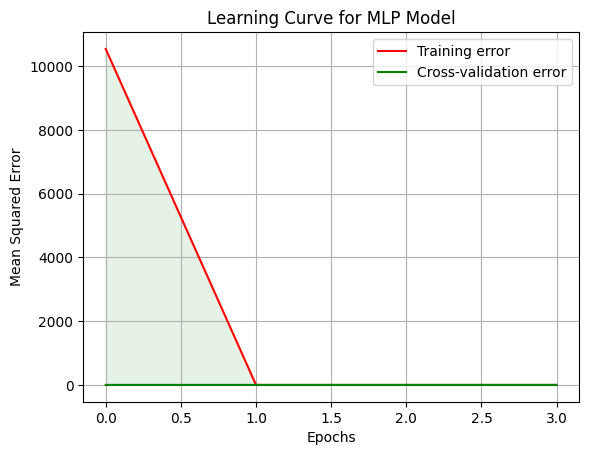

In [73]:
train_loss = mlp_history2.history['loss']
val_loss = mlp_history2.history['val_loss']

plt.plot(train_loss, 'r-', label='Training error')
plt.plot(val_loss, 'g-', label='Cross-validation error')

plt.fill_between(np.arange(len(train_loss)), train_loss, val_loss, color='green', alpha=0.1)

plt.title('Learning Curve for MLP Model')
plt.xlabel('Epochs')
plt.ylabel('Mean Squared Error')
plt.legend(loc='upper right')
plt.grid(True)

plt.show()

# 

-----
# Solar Producers 

## DataSet explanation:

### The columns:
**For Generation Data**:

DATE_TIME:  Date and time for each observation. Observations recorded at 15 minute intervals.

PLANT_ID : ID of Solar Power Plant

SOURCE_KEY: Inverter ID

DC_POWER: power input to the inverter (SOURCE_KEY) at interval (in kW)

AC_POWER: power generated by the inverter (SOURCE_KEY) at interval (in kW)

DAILY_YIELD:shows how much energy has been generated so far on a given day

This is the cumulative sum of the energy generated since the start of the current day (midnight).
It resets to zero at the beginning of each day and accumulates throughout the day for each 15-minute interval.


TOTAL_YIELD:reflects the lifetime energy generation of the inverter up to the recorded timestamp.

This is the overall cumulative energy generated by the inverter (represented by SOURCE_KEY) from the time it started operating until the current observation time.
It keeps increasing across days and does not reset, unless the system is reset or reinitialized.







**For Weather Sensor Data**
DATE_TIME:  Date and time for each observation. Observations recorded at 15 minute intervals

PLANT_ID: ID of Solar Power Plant (common for the entire file)

SOURCE_KEY: Sensor panel ID (Common for entire file, only one type of sensor panel for the plant)

AMBIENT_TEMPERATURE: The air temperature surrounding the solar plant.
Useful for analyzing how external temperature impacts power generation and inverter performance.


MODULE_TEMPERATURE: The temperature of the module attached to the sensor panel.


IRRADIATION: Amount of irradiation for the 15 minute interval


## import libraries and Dataset

In [74]:
import pandas as pd
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import plotly.graph_objs as go
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.model_selection import cross_validate
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from xgboost import XGBRegressor
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, r2_score


warnings.filterwarnings("ignore")

In [75]:
generation_data2 = pd.read_csv('/kaggle/input/solar-panel-dataset-v2/Plant_2_Generation_Data.csv')

In [76]:
weather_data2 = pd.read_csv('/kaggle/input/solar-panel-dataset-v2/Plant_2_Weather_Sensor_Data.csv')

## EDA for generation_data2

In [77]:
generation_data2.head(5)

,DATE_TIME,PLANT_ID,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
0,2020-05-15 00:00:00,4136001,4UPUqMRk7TRMgml,0.0,0.0,9425.000000,2.429011e+06
1,2020-05-15 00:00:00,4136001,81aHJ1q11NBPMrL,0.0,0.0,0.000000,1.215279e+09
2,2020-05-15 00:00:00,4136001,9kRcWv60rDACzjR,0.0,0.0,3075.333333,2.247720e+09
3,2020-05-15 00:00:00,4136001,Et9kgGMDl729KT4,0.0,0.0,269.933333,1.704250e+06
4,2020-05-15 00:00:00,4136001,IQ2d7wF4YD8zU1Q,0.0,0.0,3177.000000,1.994153e+07


In [78]:
generation_data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DATE_TIME    67698 non-null  object 
 1   PLANT_ID     67698 non-null  int64  
 2   SOURCE_KEY   67698 non-null  object 
 3   DC_POWER     67698 non-null  float64
 4   AC_POWER     67698 non-null  float64
 5   DAILY_YIELD  67698 non-null  float64
 6   TOTAL_YIELD  67698 non-null  float64
dtypes: float64(4), int64(1), object(2)
memory usage: 3.6+ MB


In [79]:
generation_data2.isnull().sum()

DATE_TIME      0
PLANT_ID       0
SOURCE_KEY     0
DC_POWER       0
AC_POWER       0
DAILY_YIELD    0
TOTAL_YIELD    0
dtype: int64

In [80]:
generation_data2.describe()

,PLANT_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
count,67698.0,67698.000000,67698.000000,67698.000000,6.769800e+04
mean,4136001.0,246.701961,241.277825,3294.890295,6.589448e+08
std,0.0,370.569597,362.112118,2919.448386,7.296678e+08
min,4136001.0,0.000000,0.000000,0.000000,0.000000e+00
25%,4136001.0,0.000000,0.000000,272.750000,1.996494e+07
50%,4136001.0,0.000000,0.000000,2911.000000,2.826276e+08
75%,4136001.0,446.591667,438.215000,5534.000000,1.348495e+09
max,4136001.0,1420.933333,1385.420000,9873.000000,2.247916e+09


In [81]:
generation_data2['SOURCE_KEY'].nunique()

22

In [82]:
generation_data2['PLANT_ID'].nunique()

1

In [83]:
generation_data2['DATE_TIME'] = pd.to_datetime(generation_data2['DATE_TIME'], format='%Y-%m-%d %H:%M:%S')

In [84]:
generation_data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   DATE_TIME    67698 non-null  datetime64[ns]
 1   PLANT_ID     67698 non-null  int64         
 2   SOURCE_KEY   67698 non-null  object        
 3   DC_POWER     67698 non-null  float64       
 4   AC_POWER     67698 non-null  float64       
 5   DAILY_YIELD  67698 non-null  float64       
 6   TOTAL_YIELD  67698 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 3.6+ MB


In [85]:
generation_data2.duplicated().sum()

0

## EDA Weather Sensor datasets2

In [86]:
weather_data2.head(5)

,DATE_TIME,PLANT_ID,SOURCE_KEY,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15 00:00:00,4136001,iq8k7ZNt4Mwm3w0,27.004764,25.060789,0.0
1,2020-05-15 00:15:00,4136001,iq8k7ZNt4Mwm3w0,26.880811,24.421869,0.0
2,2020-05-15 00:30:00,4136001,iq8k7ZNt4Mwm3w0,26.682055,24.427290,0.0
3,2020-05-15 00:45:00,4136001,iq8k7ZNt4Mwm3w0,26.500589,24.420678,0.0
4,2020-05-15 01:00:00,4136001,iq8k7ZNt4Mwm3w0,26.596148,25.088210,0.0


In [87]:
weather_data2['SOURCE_KEY'].nunique()

1

In [88]:
weather_data2['PLANT_ID'].nunique()

1

In [89]:
weather_data2.duplicated().sum()

0

In [90]:
weather_data2['DATE_TIME'] = pd.to_datetime(weather_data2['DATE_TIME'], format='%Y-%m-%d %H:%M:%S')

In [91]:
weather_data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3259 entries, 0 to 3258
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DATE_TIME            3259 non-null   datetime64[ns]
 1   PLANT_ID             3259 non-null   int64         
 2   SOURCE_KEY           3259 non-null   object        
 3   AMBIENT_TEMPERATURE  3259 non-null   float64       
 4   MODULE_TEMPERATURE   3259 non-null   float64       
 5   IRRADIATION          3259 non-null   float64       
dtypes: datetime64[ns](1), float64(3), int64(1), object(1)
memory usage: 152.9+ KB


In [92]:
weather_data2['SOURCE_KEY'].nunique()

1

## Merging generation data2 and weather sensor data2

In [93]:
solar = pd.merge(generation_data2.drop(columns = ['PLANT_ID']), weather_data2.drop(columns = ['PLANT_ID', 'SOURCE_KEY']), on='DATE_TIME')
solar


,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15 00:00:00,4UPUqMRk7TRMgml,0.0,0.0,9425.000000,2.429011e+06,27.004764,25.060789,0.0
1,2020-05-15 00:00:00,81aHJ1q11NBPMrL,0.0,0.0,0.000000,1.215279e+09,27.004764,25.060789,0.0
2,2020-05-15 00:00:00,9kRcWv60rDACzjR,0.0,0.0,3075.333333,2.247720e+09,27.004764,25.060789,0.0
3,2020-05-15 00:00:00,Et9kgGMDl729KT4,0.0,0.0,269.933333,1.704250e+06,27.004764,25.060789,0.0
4,2020-05-15 00:00:00,IQ2d7wF4YD8zU1Q,0.0,0.0,3177.000000,1.994153e+07,27.004764,25.060789,0.0
...,...,...,...,...,...,...,...,...,...
67693,2020-06-17 23:45:00,q49J1IKaHRwDQnt,0.0,0.0,4157.000000,5.207580e+05,23.202871,22.535908,0.0
67694,2020-06-17 23:45:00,rrq4fwE8jgrTyWY,0.0,0.0,3931.000000,1.211314e+08,23.202871,22.535908,0.0
67695,2020-06-17 23:45:00,vOuJvMaM2sgwLmb,0.0,0.0,4322.000000,2.427691e+06,23.202871,22.535908,0.0
67696,2020-06-17 23:45:00,xMbIugepa2P7lBB,0.0,0.0,4218.000000,1.068964e+08,23.202871,22.535908,0.0


## EDA for solar (The merge)

In [94]:
solar.shape

(67698, 9)

In [95]:
# Adding separate time and date columns
solar["DATE"] = pd.to_datetime(solar["DATE_TIME"]).dt.date
solar["TIME"] = pd.to_datetime(solar["DATE_TIME"]).dt.time
solar['DAY'] = pd.to_datetime(solar['DATE_TIME']).dt.day
solar['MONTH'] = pd.to_datetime(solar['DATE_TIME']).dt.month
solar['WEEK'] = pd.to_datetime(solar['DATE_TIME']).dt.isocalendar().week  # Updated line

# Add hours and minutes for ML models
solar['HOURS'] = pd.to_datetime(solar['TIME'], format='%H:%M:%S').dt.hour
solar['MINUTES'] = pd.to_datetime(solar['TIME'], format='%H:%M:%S').dt.minute
solar['TOTAL MINUTES PASS'] = solar['MINUTES'] + solar['HOURS'] * 60

# Add date as string column
solar["DATE_STRING"] = solar["DATE"].astype(str)
solar["HOURS"] = solar["HOURS"].astype(str)
solar["TIME"] = solar["TIME"].astype(str)

# Display the first two rows
solar.head(2)


,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING
0,2020-05-15,4UPUqMRk7TRMgml,0.0,0.0,9425.0,2.429011e+06,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15
1,2020-05-15,81aHJ1q11NBPMrL,0.0,0.0,0.0,1.215279e+09,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15


In [96]:
solar.head(532)


,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING
0,2020-05-15 00:00:00,4UPUqMRk7TRMgml,0.000000,0.000000,9425.000000,2.429011e+06,27.004764,25.060789,0.000000,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15
1,2020-05-15 00:00:00,81aHJ1q11NBPMrL,0.000000,0.000000,0.000000,1.215279e+09,27.004764,25.060789,0.000000,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15
2,2020-05-15 00:00:00,9kRcWv60rDACzjR,0.000000,0.000000,3075.333333,2.247720e+09,27.004764,25.060789,0.000000,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15
3,2020-05-15 00:00:00,Et9kgGMDl729KT4,0.000000,0.000000,269.933333,1.704250e+06,27.004764,25.060789,0.000000,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15
4,2020-05-15 00:00:00,IQ2d7wF4YD8zU1Q,0.000000,0.000000,3177.000000,1.994153e+07,27.004764,25.060789,0.000000,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
527,2020-05-15 05:45:00,xoJJ8DcxJEcupym,0.000000,0.000000,0.000000,2.091436e+08,24.741274,23.786662,0.002838,2020-05-15,05:45:00,15,5,20,5,45,345,2020-05-15
528,2020-05-15 06:00:00,4UPUqMRk7TRMgml,15.406667,14.860000,0.800000,2.429012e+06,24.742787,24.077230,0.012962,2020-05-15,06:00:00,15,5,20,6,0,360,2020-05-15
529,2020-05-15 06:00:00,81aHJ1q11NBPMrL,14.773333,14.246667,0.733333,1.215279e+09,24.742787,24.077230,0.012962,2020-05-15,06:00:00,15,5,20,6,0,360,2020-05-15
530,2020-05-15 06:00:00,9kRcWv60rDACzjR,15.380000,14.840000,1.866667,2.247720e+09,24.742787,24.077230,0.012962,2020-05-15,06:00:00,15,5,20,6,0,360,2020-05-15


In [97]:
solar.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 18 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DATE_TIME            67698 non-null  datetime64[ns]
 1   SOURCE_KEY           67698 non-null  object        
 2   DC_POWER             67698 non-null  float64       
 3   AC_POWER             67698 non-null  float64       
 4   DAILY_YIELD          67698 non-null  float64       
 5   TOTAL_YIELD          67698 non-null  float64       
 6   AMBIENT_TEMPERATURE  67698 non-null  float64       
 7   MODULE_TEMPERATURE   67698 non-null  float64       
 8   IRRADIATION          67698 non-null  float64       
 9   DATE                 67698 non-null  object        
 10  TIME                 67698 non-null  object        
 11  DAY                  67698 non-null  int32         
 12  MONTH                67698 non-null  int32         
 13  WEEK                 67698 non-

In [98]:
solar.isnull().sum()

DATE_TIME              0
SOURCE_KEY             0
DC_POWER               0
AC_POWER               0
DAILY_YIELD            0
TOTAL_YIELD            0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
DATE                   0
TIME                   0
DAY                    0
MONTH                  0
WEEK                   0
HOURS                  0
MINUTES                0
TOTAL MINUTES PASS     0
DATE_STRING            0
dtype: int64

In [99]:
solar.describe()

,DATE_TIME,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DAY,MONTH,WEEK,MINUTES,TOTAL MINUTES PASS
count,67698,67698.000000,67698.000000,67698.000000,6.769800e+04,67698.000000,67698.000000,67698.000000,67698.000000,67698.000000,67698.0,67698.000000,67698.000000
mean,2020-06-01 10:44:33.650624768,246.701961,241.277825,3294.890295,6.589448e+08,27.986756,32.607233,0.229204,15.530680,5.529705,22.563296,22.517061,714.329522
min,2020-05-15 00:00:00,0.000000,0.000000,0.000000,0.000000e+00,20.942385,20.265123,0.000000,1.000000,5.000000,20.0,0.000000,0.000000
25%,2020-05-23 21:00:00,0.000000,0.000000,272.750000,1.996494e+07,24.570349,23.685627,0.000000,9.000000,5.000000,21.0,15.000000,360.000000
50%,2020-06-01 23:00:00,0.000000,0.000000,2911.000000,2.826276e+08,26.910352,27.433723,0.018554,16.000000,6.000000,23.0,30.000000,720.000000
75%,2020-06-09 23:30:00,446.591667,438.215000,5534.000000,1.348495e+09,30.912601,40.019036,0.431027,22.000000,6.000000,24.0,45.000000,1080.000000
max,2020-06-17 23:45:00,1420.933333,1385.420000,9873.000000,2.247916e+09,39.181638,66.635953,1.098766,31.000000,6.000000,25.0,45.000000,1425.000000
std,NaN,370.569597,362.112118,2919.448386,7.296678e+08,4.021294,11.226446,0.309365,8.527546,0.499120,1.47473,16.764084,415.672274


In [100]:
solar['SOURCE_KEY'].nunique()

22

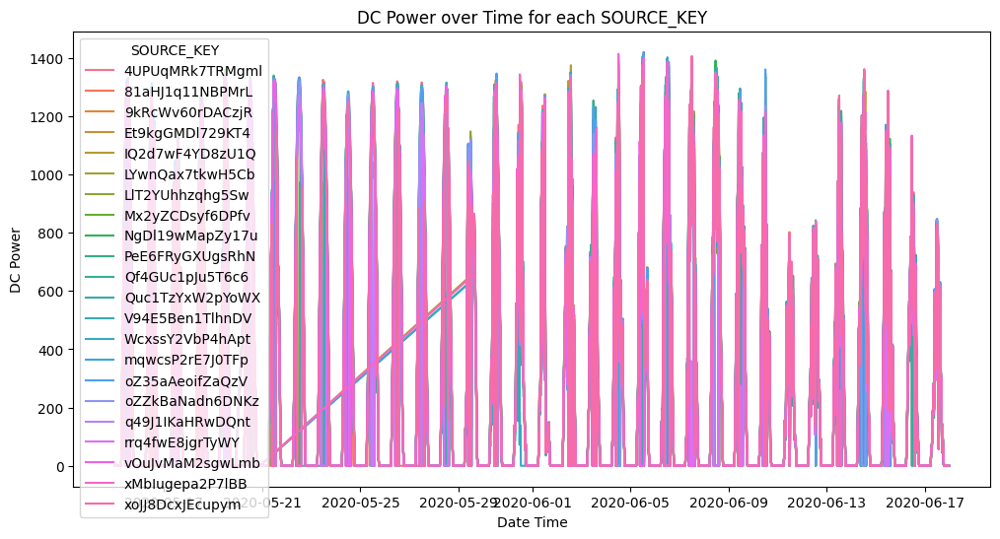

In [101]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=solar, x='DATE_TIME', y='DC_POWER', hue='SOURCE_KEY')

# Add labels and title
plt.xlabel('Date Time')
plt.ylabel('DC Power')
plt.title('DC Power over Time for each SOURCE_KEY')

# Show the plot
plt.show()


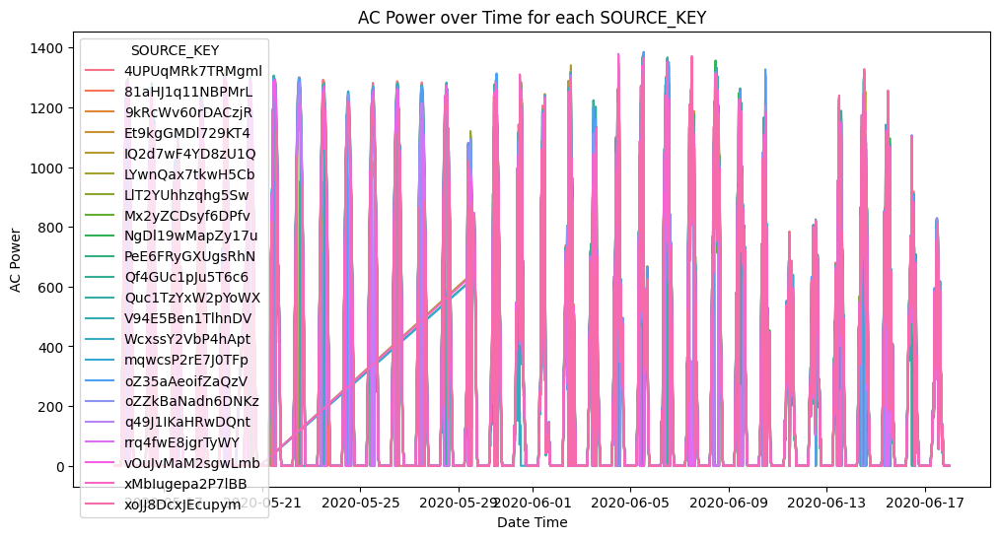

In [102]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=solar, x='DATE_TIME', y='AC_POWER', hue='SOURCE_KEY')

# Add labels and title
plt.xlabel('Date Time')
plt.ylabel('AC Power')
plt.title('AC Power over Time for each SOURCE_KEY')

# Show the plot
plt.show()


### Solar Plant Performance Analysis: Key Insights and Anomalies

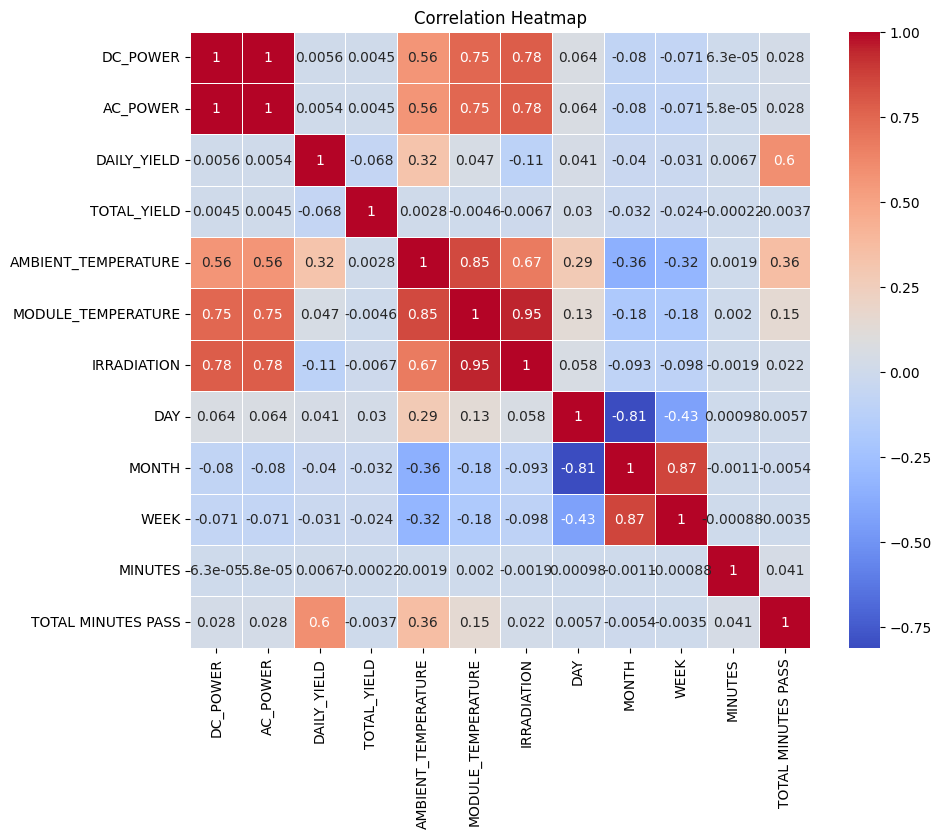

In [103]:
numeric_columns = solar.select_dtypes(include=np.number).columns.tolist()
corr_df = solar[numeric_columns].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr_df, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

**DC Power and AC Power:**
Strong positive correlation observed
Indicates efficient power conversion in the inverters.

**Power and Irradiation:** High correlation between power output and solar irradiation
Demonstrates the direct impact of sunlight on energy production.

**Power and Temperature:** Correlation noted between power output and both module and ambient temperatures the temperature influence on solar panel efficiency.


#### Daily Yield and AC Power 

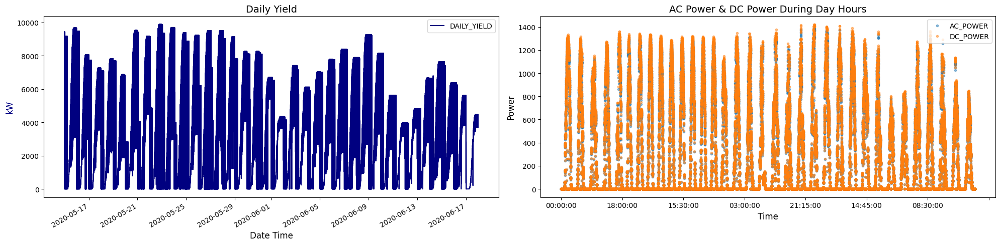

In [104]:
def plot_daily_yield_and_power(solar):
    fig, (ax1, ax2) = plt.subplots(ncols=2, nrows=1, figsize=(20, 5), dpi=100)

    # Daily yield plot
    solar.plot(x='DATE_TIME', y='DAILY_YIELD', color='navy', ax=ax1)
    ax1.set_title('Daily Yield', fontsize=14)
    ax1.set_ylabel('kW', color='navy', fontsize=12)
    ax1.set_xlabel('Date Time', fontsize=12)
    ax1.tick_params(axis='both', which='major', labelsize=10)

    # AC & DC power plot
    power_data = solar.set_index('TIME')[['AC_POWER', 'DC_POWER']]
    power_data.plot(style='.', ax=ax2, alpha=0.5)
    ax2.set_title('AC Power & DC Power During Day Hours', fontsize=14)
    ax2.set_ylabel('Power', fontsize=12)
    ax2.set_xlabel('Time', fontsize=12)
    ax2.tick_params(axis='both', which='major', labelsize=10)
    ax2.legend(fontsize=10)

    plt.tight_layout()
    plt.show()

plot_daily_yield_and_power(solar)

#### Daily and Total Yield

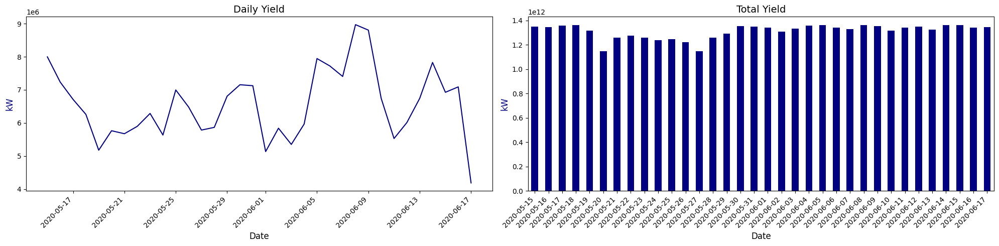

In [105]:
def plot_daily_yield_and_total_yield(solar):
    # Ensure DATE_TIME is a datetime object
    solar['date'] = pd.to_datetime(solar['DATE_TIME']).dt.date

    # Group by date and sum, exclude 'DATE_TIME' column from sum
    df_plant1_grouped = solar.groupby('date').sum(numeric_only=True)

    # Create subplots
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 5), dpi=100)

    # Plot Daily Yield
    df_plant1_grouped['DAILY_YIELD'].plot(ax=ax1, color='navy')
    ax1.set_title('Daily Yield', fontsize=14)
    ax1.set_ylabel('kW', color='navy', fontsize=12)
    ax1.set_xlabel('Date', fontsize=12)
    ax1.tick_params(axis='both', which='major', labelsize=10)

    # Plot Total Yield
    df_plant1_grouped['TOTAL_YIELD'].plot(kind='bar', ax=ax2, color='navy')
    ax2.set_title('Total Yield', fontsize=14)
    ax2.set_ylabel('kW', color='navy', fontsize=12)
    ax2.set_xlabel('Date', fontsize=12)
    ax2.tick_params(axis='both', which='major', labelsize=10)

    # Auto-format x-axis labels
    fig.autofmt_xdate(rotation=45)

    # Adjust layout
    plt.tight_layout()
    plt.show()

plot_daily_yield_and_total_yield(solar)

#### TOTAL_YIELD by inverter (source key)
shows comparison of the total energy yield across all inverters. The bar chart shows individual inverter performance, and the line plot highlights the decreasing trend in yield. It is useful for identifying the most and least productive inverters, helping assess which inverters might need further investigation or maintenance.






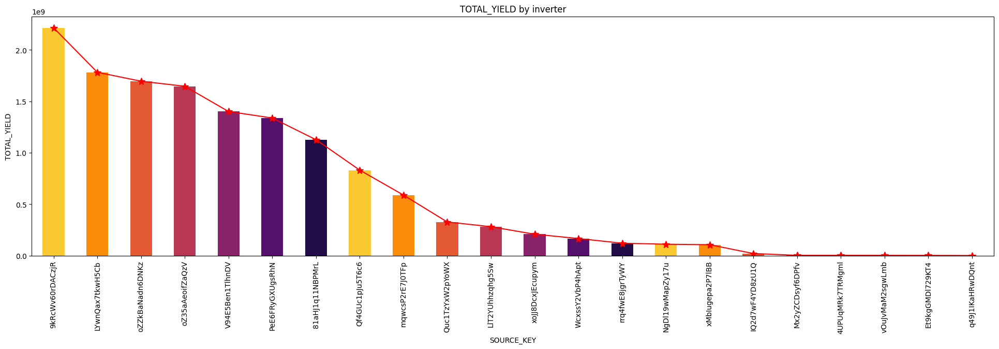

In [106]:
plt.figure(figsize=(24,6))
plt.title('TOTAL_YIELD by inverter')
plt.ylabel('TOTAL_YIELD')
solar.groupby('SOURCE_KEY')['TOTAL_YIELD'].mean().sort_values(ascending=False).plot(kind='line', marker='*', color='red', ms=10)
solar.groupby('SOURCE_KEY')['TOTAL_YIELD'].mean().sort_values(ascending=False).plot(kind='bar',color=sns.color_palette("inferno_r", 7))
plt.show()

#### DAILY_YIELD & IRRADIATION

In [107]:
fig = px.scatter(solar, x = 'DAILY_YIELD', y = 'IRRADIATION', log_x=True,
                 hover_name="SOURCE_KEY", hover_data=["DAILY_YIELD", "IRRADIATION"],
                color = 'DAILY_YIELD', color_continuous_scale= 'rainbow',
                title = 'Quality or Quantity, That\'s the question')
fig.show()

In [108]:
dfpie = solar.loc[solar.groupby('SOURCE_KEY')['AMBIENT_TEMPERATURE'].idxmax()]
fig = px.bar(dfpie, x = 'SOURCE_KEY', y = 'AMBIENT_TEMPERATURE',
            text = 'SOURCE_KEY', color = 'DAILY_YIELD',
            title = 'Max AMBIENT_TEMPERATURE')
fig.show()

#### Irradiation, Ambient and Module Temperature

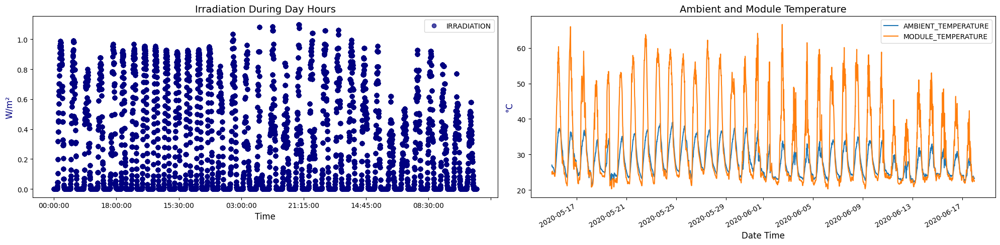

In [109]:
def plot_irradiation_and_temperature(solar):
    fig, (ax1, ax2) = plt.subplots(ncols=2, nrows=1, figsize=(20, 5), dpi=100)

    # Daily irradiation plot
    solar.plot(x='TIME', y='IRRADIATION', ax=ax1, style='o', color='navy', alpha=0.7)
    ax1.set_title('Irradiation During Day Hours', fontsize=14)
    ax1.set_ylabel('W/m²', color='navy', fontsize=12)
    ax1.set_xlabel('Time', fontsize=12)
    ax1.tick_params(axis='both', which='major', labelsize=10)

    # Temperature plot
    solar.set_index('DATE_TIME')[['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE']].plot(ax=ax2)
    ax2.set_title('Ambient and Module Temperature', fontsize=14)
    ax2.set_ylabel('°C', color='navy', fontsize=12)
    ax2.set_xlabel('Date Time', fontsize=12)
    ax2.tick_params(axis='both', which='major', labelsize=10)
    ax2.legend(fontsize=10)

    plt.tight_layout()
    plt.show()

plot_irradiation_and_temperature(solar)


#### Temperature:

In [110]:
solar['AMBIENT_TEMPERATURE'].describe()

count    67698.000000
mean        27.986756
std          4.021294
min         20.942385
25%         24.570349
50%         26.910352
75%         30.912601
max         39.181638
Name: AMBIENT_TEMPERATURE, dtype: float64

In [111]:
solar['MODULE_TEMPERATURE'].describe()

count    67698.000000
mean        32.607233
std         11.226446
min         20.265123
25%         23.685627
50%         27.433723
75%         40.019036
max         66.635953
Name: MODULE_TEMPERATURE, dtype: float64

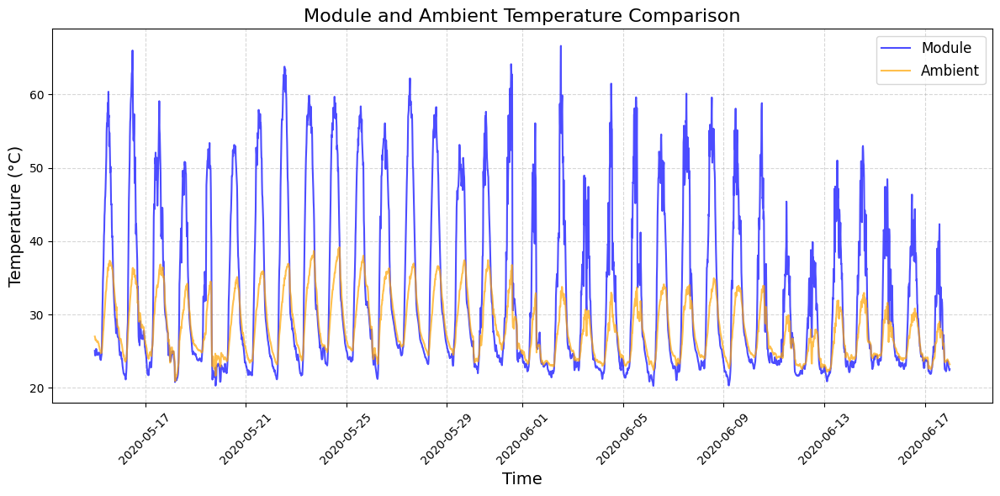

In [112]:
def plot_temperature(solar):
    plt.figure(figsize=(12, 6))

    # Plot Module and Ambient Temperature
    plt.plot(solar['DATE_TIME'], solar['MODULE_TEMPERATURE'], label="Module", color='blue', linestyle='-', alpha=0.7)
    plt.plot(solar['DATE_TIME'], solar['AMBIENT_TEMPERATURE'], label="Ambient", color='orange', linestyle='-',  alpha=0.7)

    # Add title and labels
    plt.title("Module and Ambient Temperature Comparison", fontsize=16)
    plt.xlabel("Time", fontsize=14)
    plt.ylabel("Temperature (°C)", fontsize=14)

    # Add grid and legend
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.legend(fontsize=12)

    # Rotate x-ticks for better readability
    plt.xticks(rotation=45)

    plt.tight_layout()
    plt.show()

plot_temperature(solar)

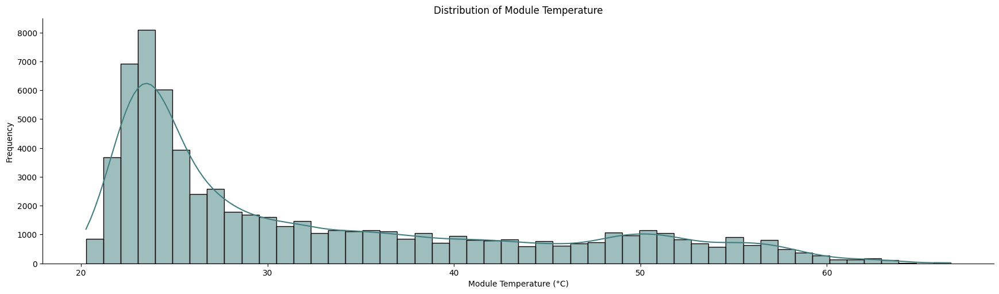

In [113]:
# Module Temperature
sns.displot(
    data=solar,
    x="MODULE_TEMPERATURE",
    kde=True,
    bins=50,
    color="#3F7F7F",
    height=5,
    aspect=3.5
)
plt.title("Distribution of Module Temperature")
plt.xlabel("Module Temperature (°C)")
plt.ylabel("Frequency")
plt.show()

**Explanation**: shows the frequency of different module temperatures recorded in the solar plant. Most of the temperatures fall between 25°C to 30°C, representing typical operating conditions. As temperatures increase beyond 40°C, they occur less frequently, with very high temperatures (around 60°C) being rare.





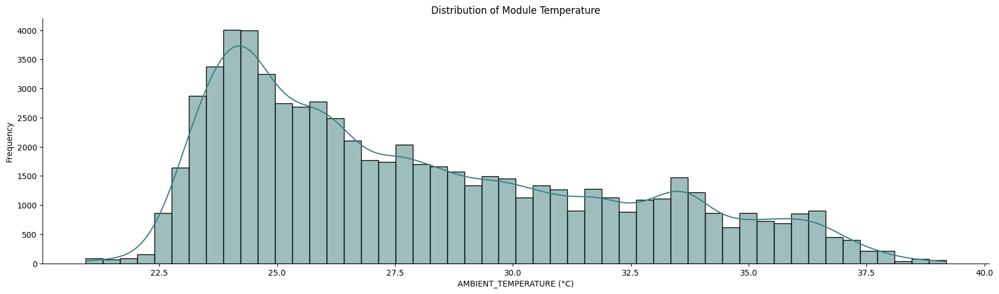

In [114]:
# AMBIENT Temperature
sns.displot(
    data=solar,
    x="AMBIENT_TEMPERATURE",
    kde=True,
    bins=50,
    color="#3F7F7F",
    height=5,
    aspect=3.5
)
plt.title("Distribution of Module Temperature")
plt.xlabel("AMBIENT_TEMPERATURE (°C)")
plt.ylabel("Frequency")
plt.show()

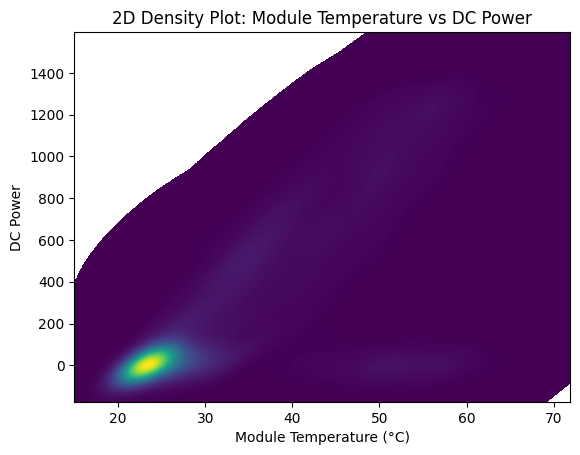

In [115]:
sns.kdeplot(
    data=solar,
    x="MODULE_TEMPERATURE",
    y="DC_POWER",
    cmap="viridis",
    fill=True,
    thresh=0,
    levels=100
)

plt.title("2D Density Plot: Module Temperature vs DC Power")
plt.xlabel("Module Temperature (°C)")
plt.ylabel("DC Power")
plt.show()


#### Average temperature and Maximum temperature between module and ambient:

In [116]:
mod_amb_avg_diff = solar['MODULE_TEMPERATURE'].mean() - solar['AMBIENT_TEMPERATURE'].mean()
print(f"Average temperature difference between module and ambient: {mod_amb_avg_diff:.2f}°C")
mod_amb_max_diff = solar['MODULE_TEMPERATURE'].max() - solar['AMBIENT_TEMPERATURE'].max()
print(f"Maximum temperature difference between module and ambient: {mod_amb_max_diff:.2f}°C")

Average temperature difference between module and ambient: 4.62°C
Maximum temperature difference between module and ambient: 27.45°C


## Faults & Abnormalities detection in solar power plant generation


### Multiple Plotting of DC_POWER generation on per day

 The shape we observe is influenced by the sun’s angle relative to the solar panels. In the early morning, the sun is at its lowest point in the sky, meaning sunlight must pass through a thicker layer of the atmosphere to reach the panels. As sunlight travels through more atmosphere, more energy is absorbed, leaving less available for the panels to convert into electricity. However, at midday, when the sun is directly overhead, sunlight travels through less atmosphere, allowing the panels to absorb more energy and generate more electricity efficiently.

 **Note**: Reason for very high Fluctuation & Reduction in DC_POWER generation is due to fault in the **system** or may be fluctuation in **weather** or due to clouds etc. which need to be analyse further


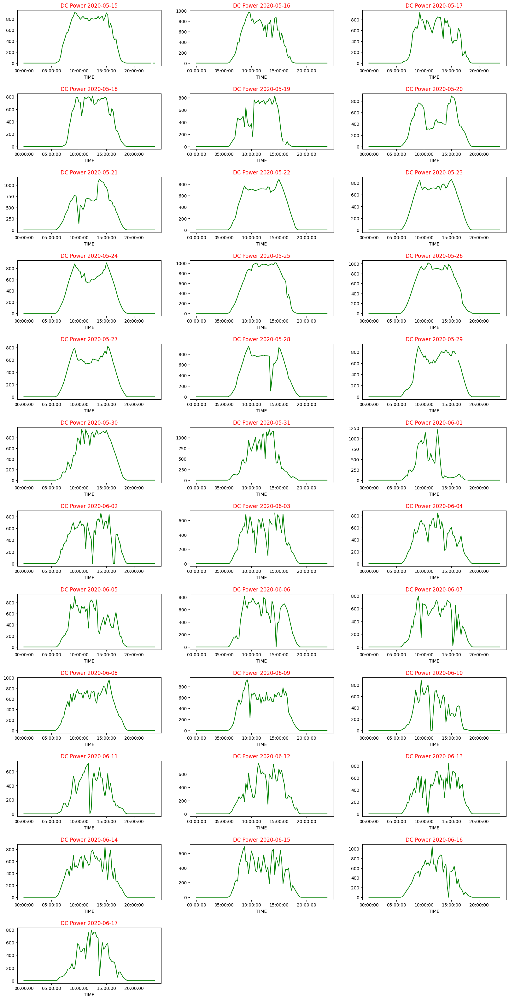

In [117]:
solar_dc = solar.pivot_table(values='DC_POWER', index='TIME', columns='DATE')

def Daywise_plot(data= None, row = None, col = None, title='DC Power'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40))

    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='green')
        ax.set_title('{} {}'.format(title, cols[i-1]),color='red')

Daywise_plot(data=solar_dc, row=12, col=3)

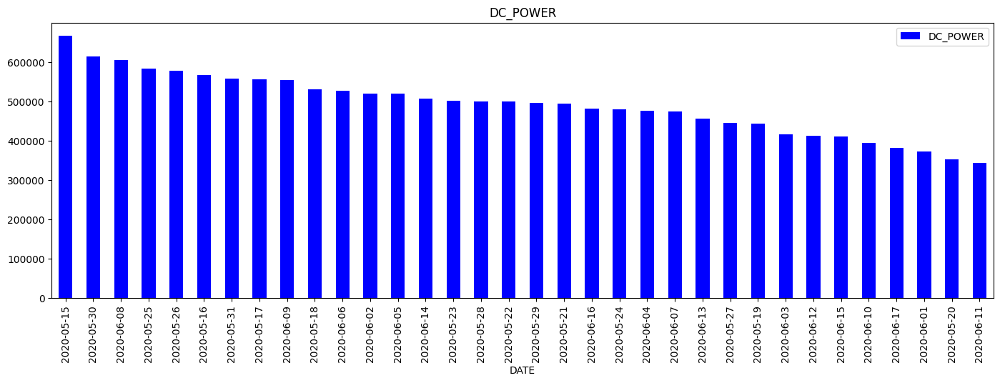

In [118]:
daily_irradiation = solar.groupby('DATE')['DC_POWER'].agg('sum')
daily_irradiation.sort_values(ascending=False).plot.bar(figsize=(17,5), legend=True,color='blue')
plt.title('DC_POWER')
plt.show()

### Multiple Plotting of IRRADIATION generation on per day

IRRADIATION graph pattern is looking very similar to the corresponding DC_POWER generation on per day basis.

In solar power plant DC_POWER or Output power is mostly depends on IRRADIATION .Or it is not wrong to say that it’s directly proportional.


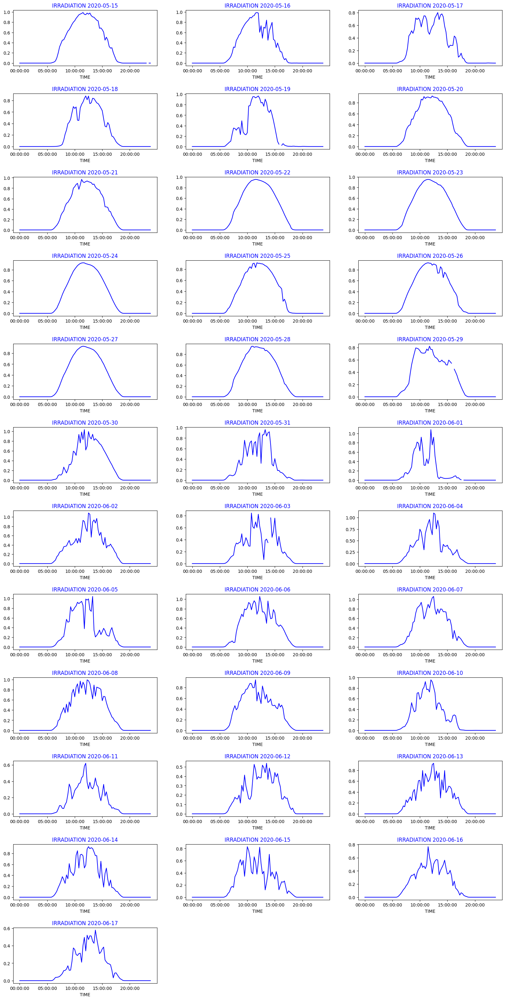

In [119]:
solar_irradiation = solar.pivot_table(values='IRRADIATION', index='TIME', columns='DATE')

def Daywise_plot(data= None, row = None, col = None, title='IRRADIATION'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40))

    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='blue')
        ax.set_title('{} {}'.format(title, cols[i-1]),color='blue')

Daywise_plot(data=solar_irradiation, row=12, col=3)


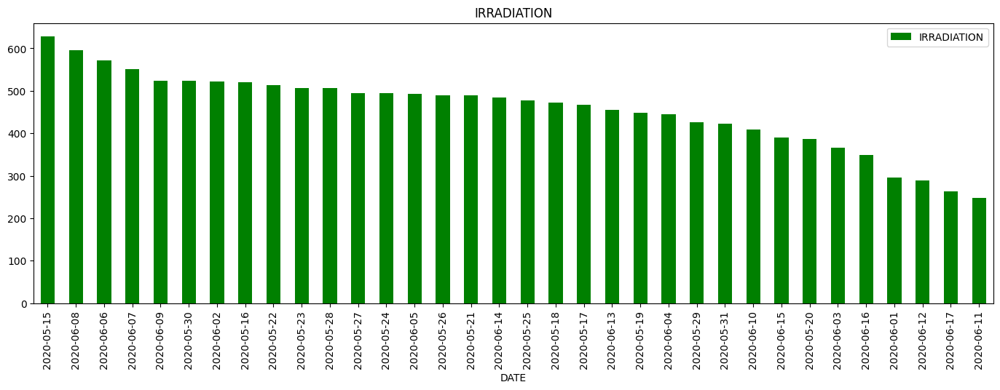

In [120]:
daily_irradiation = solar.groupby('DATE')['IRRADIATION'].agg('sum')
daily_irradiation.sort_values(ascending=False).plot.bar(figsize=(17,5), legend=True,color='green')
plt.title('IRRADIATION')
plt.show()

### Inverter wise

Analyzes how efficiently the inverters in a solar plant convert DC power (Direct Current) into AC power (Alternating Current)
so the Inverter loss is calculated as the percentage of DC power converted into AC power. This helps measure how well the inverter performs

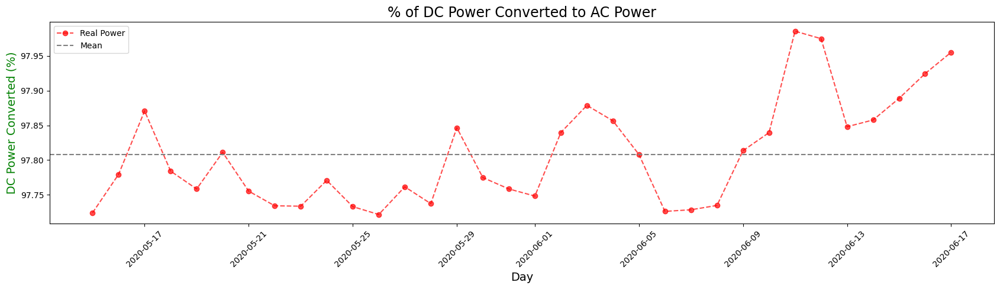

In [121]:
def plot_inverter_loss(solar):
    # Create a copy of the DataFrame
    loss_df = solar.copy()

    # Extract the date and group by day
    loss_df['Day'] = pd.to_datetime(loss_df['DATE_TIME']).dt.date
    loss_df = loss_df.groupby('Day').sum(numeric_only=True)

    # Calculate inverter loss
    loss_df['inverter_loss'] = (loss_df['AC_POWER'] / loss_df['DC_POWER']) * 100

    # Plot inverter loss
    plt.figure(figsize=(17, 5))
    loss_df['inverter_loss'].plot(style='o--', label='Real Power', color='red', alpha=0.7)

    # Plot mean line
    plt.axhline(loss_df['inverter_loss'].mean(), linestyle='--', color='gray', label='Mean')

    # Add titles and labels
    plt.title('% of DC Power Converted to AC Power', fontsize=17)
    plt.ylabel('DC Power Converted (%)', fontsize=14, color='green')
    plt.xlabel('Day', fontsize=14)
    plt.xticks(rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()

plot_inverter_loss(solar)

#### Solar Power Plant Inverter Efficiency Calculation
The inverter efficiency refers to how much dc power will be converted to ac power, as some of power will be lost during this transition in two forms.

In [122]:
solar_dc_power = solar[solar['DC_POWER'] > 0]['DC_POWER'].values
solar_ac_power = solar[solar['AC_POWER'] > 0]['AC_POWER'].values
solar_plant_eff = (np.max(solar_ac_power)/np.max(solar_dc_power ))*100
solar_loss= 100 - solar_plant_eff
print(f"Power ratio AC/DC (Efficiency) of Solar Power Plant:{solar_plant_eff:0.3f} %")
print(f"Power ratio AC/DC (loss) of Solar Power Plant: {solar_loss:0.3f} %")

Power ratio AC/DC (Efficiency) of Solar Power Plant:97.501 %
Power ratio AC/DC (loss) of Solar Power Plant: 2.499 %


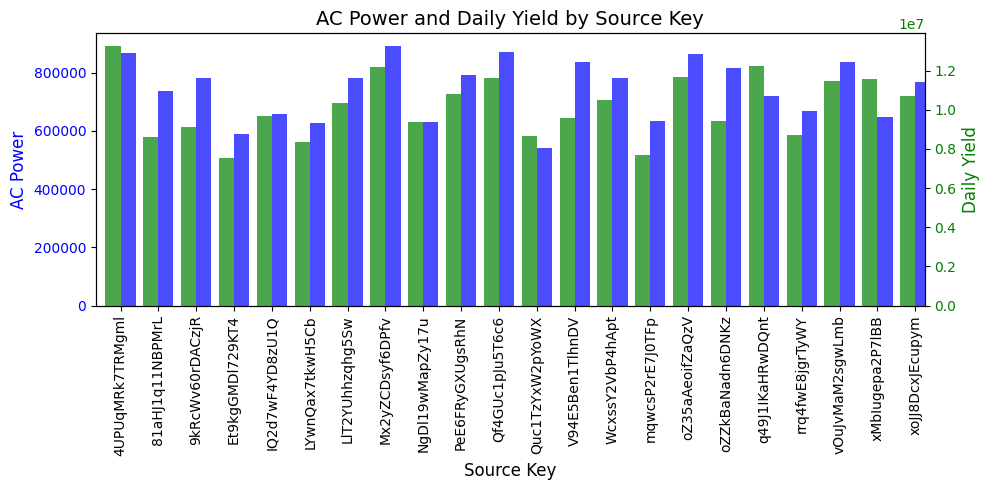

In [123]:
# Group data
ac_power = solar.groupby('SOURCE_KEY')[['AC_POWER', 'DAILY_YIELD']].sum()

# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(10, 5))

# Plot AC_POWER on the first y-axis
ac_power['AC_POWER'].plot(kind='bar', ax=ax1, color='blue', position=0, width=0.4, label='AC Power', alpha=0.7)
ax1.set_ylabel('AC Power', color='blue', fontsize=12)
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis
ax2 = ax1.twinx()

# Plot DAILY_YIELD on the second y-axis
ac_power['DAILY_YIELD'].plot(kind='bar', ax=ax2, color='green', position=1, width=0.4, label='Daily Yield', alpha=0.7)
ax2.set_ylabel('Daily Yield', color='green', fontsize=12)
ax2.tick_params(axis='y', labelcolor='green')

# Set title and labels
plt.title('AC Power and Daily Yield by Source Key', fontsize=14)
ax1.set_xlabel('Source Key', fontsize=12)

# Adjust layout
fig.tight_layout()

plt.show()

## Split The data

In [124]:
df = solar.copy()

In [125]:
df

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING,date
0,2020-05-15 00:00:00,4UPUqMRk7TRMgml,0.0,0.0,9425.000000,2.429011e+06,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
1,2020-05-15 00:00:00,81aHJ1q11NBPMrL,0.0,0.0,0.000000,1.215279e+09,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
2,2020-05-15 00:00:00,9kRcWv60rDACzjR,0.0,0.0,3075.333333,2.247720e+09,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
3,2020-05-15 00:00:00,Et9kgGMDl729KT4,0.0,0.0,269.933333,1.704250e+06,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
4,2020-05-15 00:00:00,IQ2d7wF4YD8zU1Q,0.0,0.0,3177.000000,1.994153e+07,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67693,2020-06-17 23:45:00,q49J1IKaHRwDQnt,0.0,0.0,4157.000000,5.207580e+05,23.202871,22.535908,0.0,2020-06-17,23:45:00,17,6,25,23,45,1425,2020-06-17,2020-06-17
67694,2020-06-17 23:45:00,rrq4fwE8jgrTyWY,0.0,0.0,3931.000000,1.211314e+08,23.202871,22.535908,0.0,2020-06-17,23:45:00,17,6,25,23,45,1425,2020-06-17,2020-06-17
67695,2020-06-17 23:45:00,vOuJvMaM2sgwLmb,0.0,0.0,4322.000000,2.427691e+06,23.202871,22.535908,0.0,2020-06-17,23:45:00,17,6,25,23,45,1425,2020-06-17,2020-06-17
67696,2020-06-17 23:45:00,xMbIugepa2P7lBB,0.0,0.0,4218.000000,1.068964e+08,23.202871,22.535908,0.0,2020-06-17,23:45:00,17,6,25,23,45,1425,2020-06-17,2020-06-17


In [126]:
df=df.set_index("DATE_TIME")

In [127]:
df.reset_index()

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING,date
0,2020-05-15 00:00:00,4UPUqMRk7TRMgml,0.0,0.0,9425.000000,2.429011e+06,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
1,2020-05-15 00:00:00,81aHJ1q11NBPMrL,0.0,0.0,0.000000,1.215279e+09,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
2,2020-05-15 00:00:00,9kRcWv60rDACzjR,0.0,0.0,3075.333333,2.247720e+09,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
3,2020-05-15 00:00:00,Et9kgGMDl729KT4,0.0,0.0,269.933333,1.704250e+06,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
4,2020-05-15 00:00:00,IQ2d7wF4YD8zU1Q,0.0,0.0,3177.000000,1.994153e+07,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67693,2020-06-17 23:45:00,q49J1IKaHRwDQnt,0.0,0.0,4157.000000,5.207580e+05,23.202871,22.535908,0.0,2020-06-17,23:45:00,17,6,25,23,45,1425,2020-06-17,2020-06-17
67694,2020-06-17 23:45:00,rrq4fwE8jgrTyWY,0.0,0.0,3931.000000,1.211314e+08,23.202871,22.535908,0.0,2020-06-17,23:45:00,17,6,25,23,45,1425,2020-06-17,2020-06-17
67695,2020-06-17 23:45:00,vOuJvMaM2sgwLmb,0.0,0.0,4322.000000,2.427691e+06,23.202871,22.535908,0.0,2020-06-17,23:45:00,17,6,25,23,45,1425,2020-06-17,2020-06-17
67696,2020-06-17 23:45:00,xMbIugepa2P7lBB,0.0,0.0,4218.000000,1.068964e+08,23.202871,22.535908,0.0,2020-06-17,23:45:00,17,6,25,23,45,1425,2020-06-17,2020-06-17


In [128]:
df = df.reset_index()

In [129]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DATE_TIME            67698 non-null  datetime64[ns]
 1   SOURCE_KEY           67698 non-null  object        
 2   DC_POWER             67698 non-null  float64       
 3   AC_POWER             67698 non-null  float64       
 4   DAILY_YIELD          67698 non-null  float64       
 5   TOTAL_YIELD          67698 non-null  float64       
 6   AMBIENT_TEMPERATURE  67698 non-null  float64       
 7   MODULE_TEMPERATURE   67698 non-null  float64       
 8   IRRADIATION          67698 non-null  float64       
 9   DATE                 67698 non-null  object        
 10  TIME                 67698 non-null  object        
 11  DAY                  67698 non-null  int32         
 12  MONTH                67698 non-null  int32         
 13  WEEK                 67698 non-

In [130]:
df["DATE_TIME"] = pd.to_datetime(df["DATE_TIME"])

In [131]:
df = df.set_index("DATE_TIME")

In [132]:
df=df.resample("H")["AMBIENT_TEMPERATURE","MODULE_TEMPERATURE","IRRADIATION","DC_POWER"].mean()
df.head()

,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DC_POWER
DATE_TIME,,,,
2020-05-15 00:00:00,26.767055,24.582656,0.0,0.0
2020-05-15 01:00:00,26.505909,25.172109,0.0,0.0
2020-05-15 02:00:00,26.296562,24.555514,0.0,0.0
2020-05-15 03:00:00,26.141691,24.627655,0.0,0.0
2020-05-15 04:00:00,25.509473,24.658230,0.0,0.0


In [133]:
X = df[['AMBIENT_TEMPERATURE','MODULE_TEMPERATURE','IRRADIATION']]
y = df['DC_POWER']

In [134]:
y.mean()

248.87088119552809

# Models

## XGBRegressor with gridsearch model

In [135]:
X

,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
DATE_TIME,,,
2020-05-15 00:00:00,26.767055,24.582656,0.0
2020-05-15 01:00:00,26.505909,25.172109,0.0
2020-05-15 02:00:00,26.296562,24.555514,0.0
2020-05-15 03:00:00,26.141691,24.627655,0.0
2020-05-15 04:00:00,25.509473,24.658230,0.0
...,...,...,...
2020-06-17 19:00:00,23.530150,22.480403,0.0
2020-06-17 20:00:00,23.676085,22.454153,0.0
2020-06-17 21:00:00,23.836589,23.519539,0.0


In [136]:
X_train,X_test, y_train, y_test= train_test_split(X,y,train_size=0.8,random_state=2021)

In [137]:
X_train,X_val, y_train, y_val= train_test_split(X_train,y_train,train_size=0.8,random_state=2021)

In [138]:
# Initialize the standard scaler for preprocessing
preproc2 = StandardScaler()

X_train_preproc = preproc2.fit_transform(X_train, y_train)
X_val_preproc = preproc2.transform(X_val)
X_test_preproc = preproc2.transform(X_test)

In [139]:
xgb_model= XGBRegressor(random_state= 2021)

In [140]:
#make a dictonary of hyperparmaters
search_space={
    'n_estimators': [100,200,500],
    'max_depth': [3,6,9],
    'gamma': [0.01,0.1],
    'learning_rate': [0.001,0.01,0.1,1]
}

In [141]:
gs = GridSearchCV(estimator = xgb_model,
                  param_grid= search_space,
                  scoring = ['r2','neg_mean_absolute_error'],#mean_absolute_error, neg_mean_absolute_error
                  refit= 'r2',
                  cv=5,
                  verbose= 4
)

In [142]:
gs.fit(X_train_preproc,y_train)

Fitting 5 folds for each of 72 candidates, totalling 360 fits
[CV 1/5] END gamma=0.01, learning_rate=0.001, max_depth=3, n_estimators=100; neg_mean_absolute_error: (test=-268.085) r2: (test=0.166) total time=   0.0s
[CV 2/5] END gamma=0.01, learning_rate=0.001, max_depth=3, n_estimators=100; neg_mean_absolute_error: (test=-252.418) r2: (test=0.179) total time=   0.0s
[CV 3/5] END gamma=0.01, learning_rate=0.001, max_depth=3, n_estimators=100; neg_mean_absolute_error: (test=-259.082) r2: (test=0.162) total time=   0.0s
[CV 4/5] END gamma=0.01, learning_rate=0.001, max_depth=3, n_estimators=100; neg_mean_absolute_error: (test=-263.450) r2: (test=0.172) total time=   0.0s
[CV 5/5] END gamma=0.01, learning_rate=0.001, max_depth=3, n_estimators=100; neg_mean_absolute_error: (test=-256.165) r2: (test=0.166) total time=   0.0s
[CV 1/5] END gamma=0.01, learning_rate=0.001, max_depth=3, n_estimators=200; neg_mean_absolute_error: (test=-243.601) r2: (test=0.304) total time=   0.1s
[CV 2/5] END g

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, device=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, m...
                                    max_depth=None, max_leaves=None,
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None,
                                    multi_strategy=None, n_estimators=None,
                                    n_jobs=None, num_parallel_tree=None,
                                    random_state=2021, ...),
             param_grid={'gamma': [0.01, 0.1],
                         'learning_rate': [0.001, 0.01, 0.1, 1],
                         'max_depth': [3, 6, 9],
                         'n_estimators': [100, 200, 500]},
             refit='r2', scoring=['r2', 'neg_mean_absolute_error'], verbose=4)

In [143]:
# Display the best parameters and the corresponding R^2 score
print("Best parameters found: ", gs.best_params_)
print("Best R^2 score: ", gs.best_score_)


Best parameters found:  {'gamma': 0.01, 'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
Best R^2 score:  0.953669594219656


In [144]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
# Evaluate the model on the validation set
y_val_pred = gs.predict(X_val_preproc)
mae_val = mean_absolute_error(y_val, y_val_pred)
rmse_val = np.sqrt(mean_squared_error(y_val, y_val_pred))
print("Mean Absolute Error on Validation Set: ", mae_val)
print("RMSE on Validation Set: ", rmse_val)


Mean Absolute Error on Validation Set:  37.59355064754041
RMSE on Validation Set:  80.74146116862954


In [145]:
# Evaluate the model on the test set
y_test_pred = gs.predict(X_test_preproc)
mae_test = mean_absolute_error(y_test, y_test_pred)
rmse_test = np.sqrt(mean_squared_error(y_test, y_test_pred))
print("Mean Absolute Error on Test Set: ", mae_test)
print("RMSE on Test Set: ", rmse_test)


Mean Absolute Error on Test Set:  37.09024909684772
RMSE on Test Set:  81.5957291933781


In [146]:
y.mean()

248.87088119552809

## RandomForst model

In [147]:
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor(random_state=42)

In [148]:
rf.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [149]:
evalute_train= rf.score(X_train, y_train)
evalute_train

0.9933223132099929

In [150]:
# Perform 5-fold cross-validation on the training set
cross_validate(rf, X_train, y_train, cv=5)

{'fit_time': array([0.14477634, 0.14467216, 0.13898253, 0.14372706, 0.1652348 ]),
 'score_time': array([0.00460172, 0.00468445, 0.00464749, 0.00468326, 0.00561976]),
 'test_score': array([0.94418142, 0.96980945, 0.96765244, 0.94604444, 0.94042435])}

In [151]:
# Evaluate the model on the test sample R²
evalute_test= rf.score(X_test, y_test)
evalute_test

0.9104334870303501

In [152]:
rf.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': None,
 'max_features': 1.0,
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': 42,
 'verbose': 0,
 'warm_start': False}

In [153]:
param_grid = {
    'model__n_estimators': [300, 500],
    'model__max_depth': [10, 20],
    'model__min_samples_split': [2, 5]
}

In [154]:
pipe = Pipeline([('model', rf)])

In [155]:
from sklearn.metrics import make_scorer, mean_squared_error
scorer = make_scorer(mean_squared_error, greater_is_better=False)

In [156]:
grid = GridSearchCV(pipe, param_grid, cv=5,scoring=scorer)

In [157]:
grid.fit(X_train,y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('model',
                                        RandomForestRegressor(random_state=42))]),
             param_grid={'model__max_depth': [10, 20],
                         'model__min_samples_split': [2, 5],
                         'model__n_estimators': [300, 500]},
             scoring=make_scorer(mean_squared_error, greater_is_better=False))

In [158]:
# find best parama
grid.best_params_

{'model__max_depth': 10,
 'model__min_samples_split': 2,
 'model__n_estimators': 500}

In [159]:
# select best estimator
best = grid.best_estimator_

In [160]:
# fit best estimator
best.fit(X_train,y_train)

Pipeline(steps=[('model',
                 RandomForestRegressor(max_depth=10, n_estimators=500,
                                       random_state=42))])

In [161]:
# predict with best estimator
y_pred=best.predict(X_test)
y_pred

array([0.00000000e+00, 9.50828102e+02, 2.48559294e+02, 7.93346262e+02,
       6.56104493e+02, 7.99558604e+02, 0.00000000e+00, 3.11221837e-01,
       8.36257896e+02, 0.00000000e+00, 6.52336126e+02, 7.09293024e+02,
       0.00000000e+00, 6.88199193e+02, 0.00000000e+00, 6.31485865e+02,
       4.47121643e+02, 4.51535475e+02, 0.00000000e+00, 3.35183351e+02,
       3.65091675e+01, 7.50099609e+01, 0.00000000e+00, 0.00000000e+00,
       6.39903399e+02, 0.00000000e+00, 0.00000000e+00, 8.94021504e+02,
       0.00000000e+00, 0.00000000e+00, 8.21934035e+02, 2.67225985e+01,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 8.77743666e+02,
       3.29161799e+02, 0.00000000e+00, 2.44290457e+02, 7.51288584e+01,
       7.96631077e+02, 0.00000000e+00, 0.00000000e+00, 7.43495472e+02,
       0.00000000e+00, 3.60955994e+02, 6.59329903e+02, 0.00000000e+00,
       5.65703265e+02, 8.65770066e+02, 7.34371577e+02, 8.17203283e+02,
       4.81320498e+02, 0.00000000e+00, 0.00000000e+00, 2.67521110e+02,
      

In [162]:
# mean absolute error
mean_absolute_error(y_test,y_pred)

34.14795635619182

In [163]:
41/y.mean()

0.16474406247546458

In [164]:
# r square
r2_score(y_test,y_pred)

0.9105241356537808

In [165]:
from tpot import TPOTRegressor

# Initialize TPOTRegressor to automatically find and optimize the best ML pipeline
pipeline_optimizer = TPOTRegressor(generations=5, population_size=20, cv=5,
                                    random_state=42, verbosity=2)
pipeline_optimizer.fit(X_train, y_train)


Version 0.12.1 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


[CV] END colsample_bytree=1.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=100, subsample=0.6; total time=   3.6s
[CV] END colsample_bytree=1.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=100, subsample=0.8; total time=   3.6s
[CV] END colsample_bytree=1.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=300, subsample=0.6; total time=  11.2s
[CV] END colsample_bytree=1.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=300, subsample=0.8; total time=   9.9s
[CV] END colsample_bytree=1.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=300, subsample=1.0; total time=   9.2s
[CV] END colsample_bytree=1.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, subsample=0.8; total time=  14.5s
[CV] END colsample_bytree=1.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, subsample=1.0; total time=  10.0s
[CV] END colsample_bytree=1.0, learning_rate=0.1, max_

TPOTRegressor(generations=5, population_size=20, random_state=42, verbosity=2)

In [166]:
print(pipeline_optimizer.score(X_test, y_test))

-6153.810374227529


In [167]:
pipeline_optimizer.export('tpot_exported_pipeline.py')

In [168]:
# Evaluate the model on the test set
y_test_pred = pipeline_optimizer.predict(X_test)
mae_test = mean_absolute_error(y_test, y_test_pred)
rmse_test = np.sqrt(mean_squared_error(y_test, y_test_pred))
print("Mean Absolute Error on Test Set: ", mae_test)
print("RMSE on Test Set: ", rmse_test)

Mean Absolute Error on Test Set:  35.31118437897371
RMSE on Test Set:  78.44622600372519


## Decision Tree Regressor model


In [169]:
dtr = DecisionTreeRegressor(max_depth=3, random_state=2529)

### Train the model

In [170]:
dtr.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=3, random_state=2529)

### Model Evaluation

In [171]:
# Evaluate the model on the training sample R² Score
evalute_train= dtr.score(X_train, y_train)
evalute_train

0.9589147030453731

### Cross-Validation to ensures the model is not overfitting by testing it on different subsets of the training data.

In [172]:
# Perform 5-fold cross-validation on the training set
cross_validate(dtr, X_train, y_train, cv=5)


{'fit_time': array([0.00326014, 0.00197768, 0.00191188, 0.00189352, 0.00191164]),
 'score_time': array([0.00125623, 0.00106525, 0.00103641, 0.00101924, 0.0010159 ]),
 'test_score': array([0.9466973 , 0.95629173, 0.96231537, 0.946742  , 0.93778883])}

In [173]:
# Evaluate the model on the test sample R²
evalute_test= dtr.score(X_test, y_test)
evalute_test

0.9132415279573051

### Hyperparameter Tuning with GridSearchCV

In [174]:
dtr.get_params()

{'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 3,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'random_state': 2529,
 'splitter': 'best'}

In [175]:
# the parameter grid for tuning
params = {'model__max_depth' : [2,3,4,5,6,7,8, 9, 10],
        'model__criterion' : ['squared_error', 'absolute_error'],
        'model__random_state' : [2529]}

### Create a pipeline

In [176]:
pipe = Pipeline([('model', dtr)])

### Initialize GridSearchCV



In [177]:
from sklearn.metrics import make_scorer, mean_squared_error
scorer = make_scorer(mean_squared_error, greater_is_better=False)


In [178]:
grid = GridSearchCV(pipe, params, cv=5,scoring=scorer)

In [179]:
grid

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('model',
                                        DecisionTreeRegressor(max_depth=3,
                                                              random_state=2529))]),
             param_grid={'model__criterion': ['squared_error',
                                              'absolute_error'],
                         'model__max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'model__random_state': [2529]},
             scoring=make_scorer(mean_squared_error, greater_is_better=False))

In [180]:
# Train the GridSearchCV
grid.fit(X_train,y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('model',
                                        DecisionTreeRegressor(max_depth=3,
                                                              random_state=2529))]),
             param_grid={'model__criterion': ['squared_error',
                                              'absolute_error'],
                         'model__max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'model__random_state': [2529]},
             scoring=make_scorer(mean_squared_error, greater_is_better=False))

In [181]:
# find best parama
grid.best_params_

{'model__criterion': 'absolute_error',
 'model__max_depth': 4,
 'model__random_state': 2529}

In [182]:
# select best estimator
best = grid.best_estimator_

In [183]:
# fit best estimator
best.fit(X_train,y_train)

Pipeline(steps=[('model',
                 DecisionTreeRegressor(criterion='absolute_error', max_depth=4,
                                       random_state=2529))])

### Final Model Training with Best Parameters

In [184]:
# predict with best estimator
y_pred=best.predict(X_test)
y_pred

array([  0.        , 836.98177098, 238.15503307, 836.98177098,
       622.32744589, 702.42142857,   0.        ,   0.        ,
       836.98177098,   0.        , 702.42142857, 702.42142857,
         0.        , 702.42142857,   0.        , 622.32744589,
       438.35368506, 438.35368506,   0.        , 336.44312229,
        37.00449134,  69.81751864,   0.        ,   0.        ,
       622.32744589,   0.        ,   0.        , 836.98177098,
         0.        ,   0.        , 836.98177098,  37.00449134,
         0.        ,   0.        ,   0.        , 836.98177098,
       290.80743747,   0.        , 238.15503307,  69.81751864,
       836.98177098,   0.        ,   0.        , 738.1976422 ,
         0.        , 336.44312229, 622.32744589,   0.        ,
       576.3807766 , 836.98177098, 702.42142857, 836.98177098,
       438.35368506,   0.        ,   0.        , 290.80743747,
       154.88118506, 290.80743747, 238.15503307,   0.        ,
       154.88118506, 622.32744589, 836.98177098,  37.00

In [185]:
# mean absolute error
mean_absolute_error(y_test,y_pred)

36.15803709419841

In [186]:
41/y.mean()

0.16474406247546458

In [187]:
# r square
r2_score(y_test,y_pred)


0.9164406068202968

In [188]:
# mean absolute percentage error
mean_absolute_percentage_error(y_test,y_pred)

0.09934913907825366

## Linear Regression

In [189]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [190]:
y_pred = lr.predict(X_test)

In [191]:
# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')

LR Model R² Score: 83.29%
Mean Squared Error: 12736.23


In [192]:
# Cross-Validation
cv_scores = cross_val_score(lr, X, y, cv=5, scoring='r2')
print(f'Cross-Validation R² Scores: {cv_scores}')
print(f'Mean CV R² Score: {cv_scores.mean() * 100:.2f}%')

Cross-Validation R² Scores: [0.86337889 0.90467693 0.89329813 0.87491173 0.84898625]
Mean CV R² Score: 87.71%


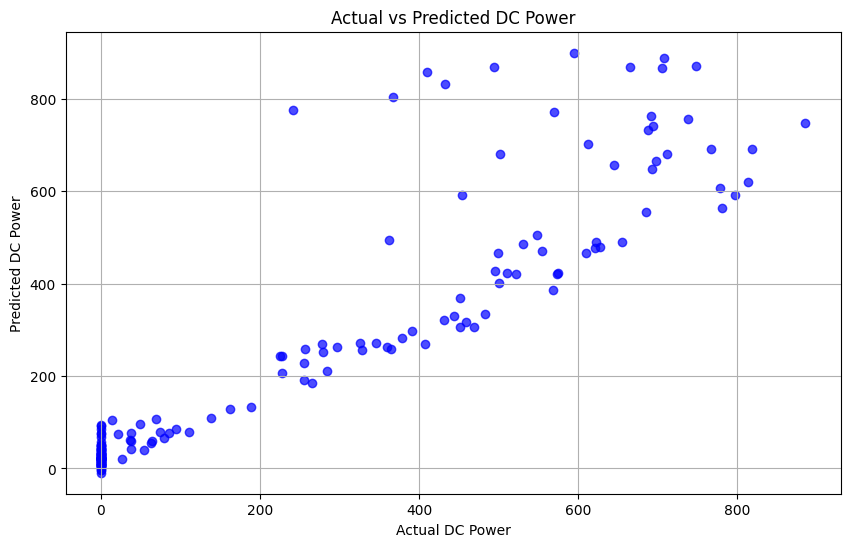

In [193]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.7, color='b')
plt.xlabel('Actual DC Power')
plt.ylabel('Predicted DC Power')
plt.title('Actual vs Predicted DC Power')
plt.grid(True)
plt.show()

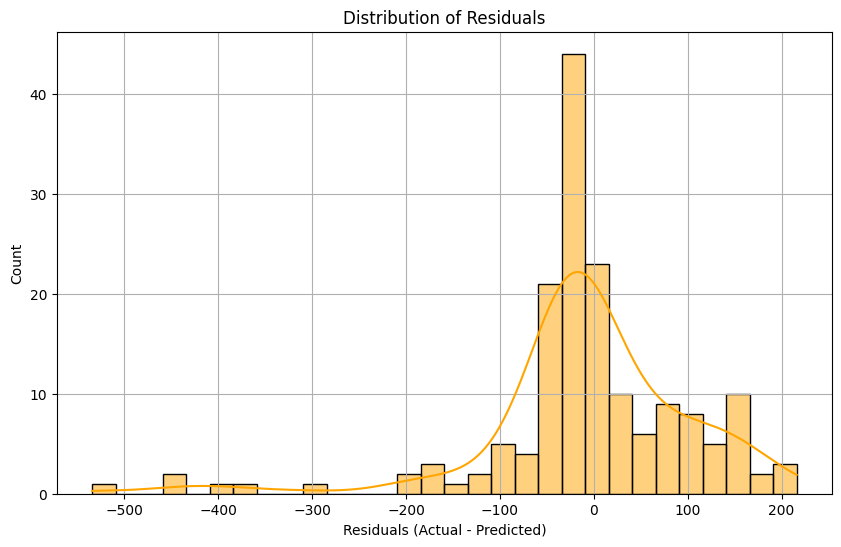

In [194]:
residuals = y_test - y_pred

plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, bins=30, color='orange')
plt.xlabel('Residuals (Actual - Predicted)')
plt.title('Distribution of Residuals')
plt.grid(True)
plt.show()

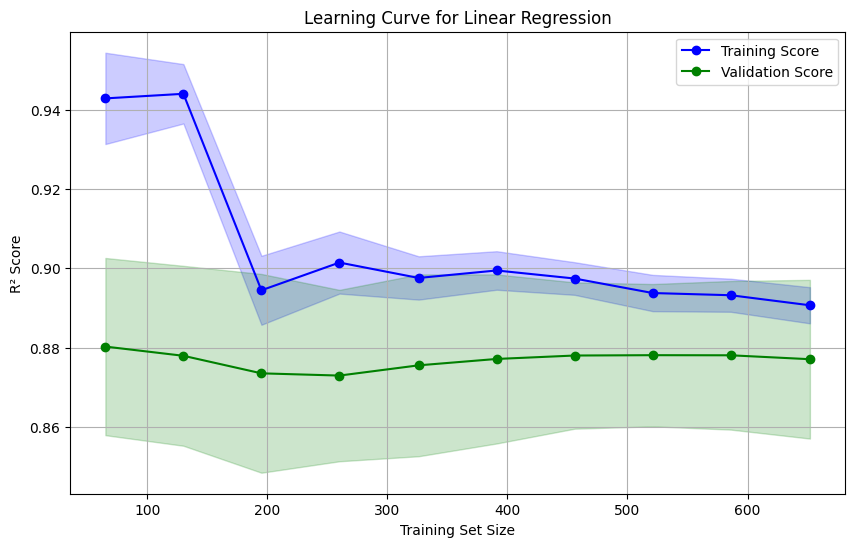

In [195]:
from sklearn.model_selection import learning_curve

# Generate Learning Curve Data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lr, X=X, y=y, cv=5, scoring='r2', n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate Means and Standard Deviations
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the Learning Curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')

# Add Shaded Area for Standard Deviations
plt.fill_between(train_sizes,
                 train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')
plt.fill_between(train_sizes,
                 test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

# Labels, Title, and Grid
plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for Linear Regression')
plt.legend(loc='best')
plt.grid(True)
plt.show()


## MLP Regressor (Neural Network)

In [196]:
from sklearn.neural_network import MLPRegressor
# Initialize the MLP Regressor with two hidden layers (64, 64 neurons)
mlp = MLPRegressor(hidden_layer_sizes=(64, 64), activation='relu',
                   solver='adam', max_iter=500, random_state=42)

# Train the model
mlp.fit(X_train, y_train)

MLPRegressor(hidden_layer_sizes=(64, 64), max_iter=500, random_state=42)

In [197]:
# Predict on test data
y_pred = mlp.predict(X_test)


In [198]:
# Calculate R² Score and Mean Squared Error
r2 = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)

print(f'MLP Regressor R² Score: {r2:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
# not performing well.

MLP Regressor R² Score: 89.22%
Mean Squared Error: 8220.72


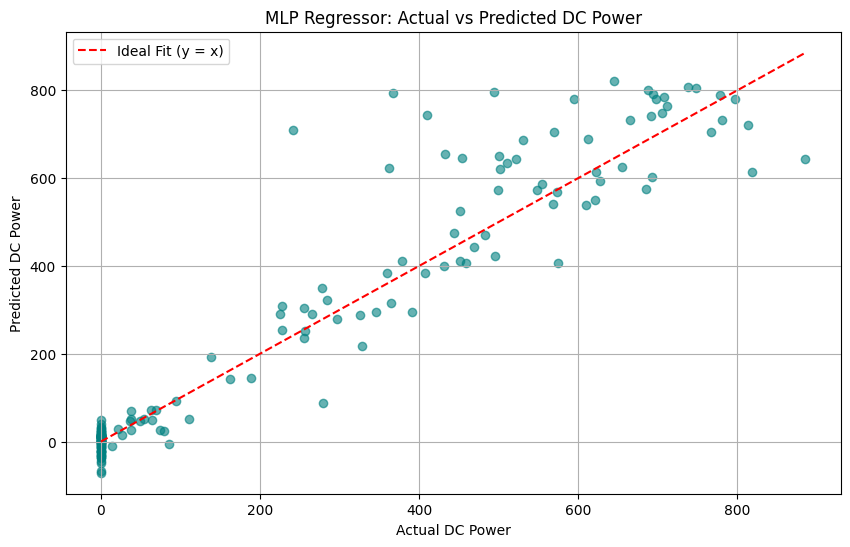

In [199]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='teal')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Ideal Fit (y = x)')
plt.xlabel('Actual DC Power')
plt.ylabel('Predicted DC Power')
plt.title('MLP Regressor: Actual vs Predicted DC Power')
plt.legend()
plt.grid(True)
plt.show()


The current model is not good based on the extremely negative R² score and large MSE.

/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptro

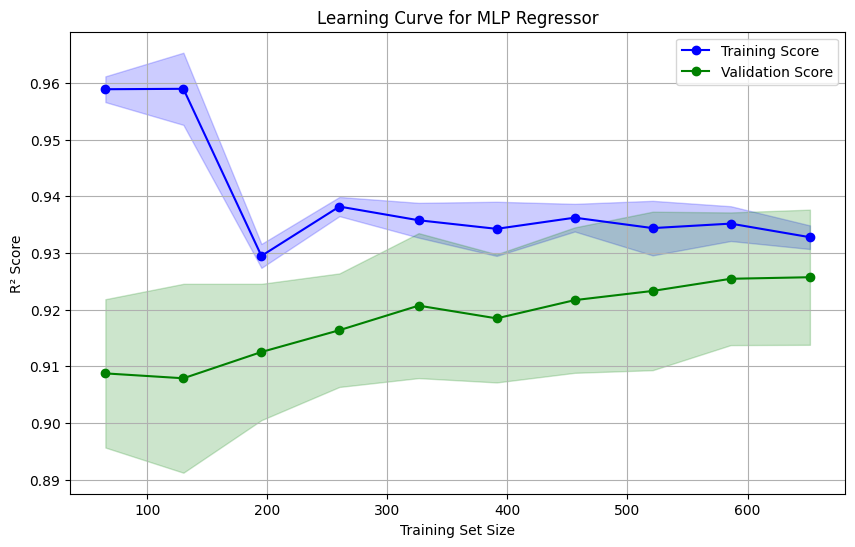

In [200]:
# Initialize the MLP Regressor
mlp_model = MLPRegressor(
    hidden_layer_sizes=(64, 64),
    activation='relu',
    solver='adam',
    max_iter=500,
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=mlp_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate the mean and standard deviation of training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for MLP Regressor')
plt.legend(loc='best')

plt.grid(True)
plt.show()


## LightGBM Regressor

In [201]:
from lightgbm import LGBMRegressor, early_stopping
from sklearn.model_selection import cross_val_score

In [202]:
# Initialize and train
lgb = LGBMRegressor(n_estimators=100, max_depth=5, learning_rate=0.1, random_state=42)
lgb.fit(X_train, y_train)

# Predict
y_pred = lgb.predict(X_test)

# Evaluate
r2 = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)

print(f'LightGBM R² Score: {r2:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000118 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 455
[LightGBM] [Info] Number of data points in the train set: 521, number of used features: 3
[LightGBM] [Info] Start training from score 254.223364
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

In [203]:
# Define the hyperparameters to tune
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'num_leaves': [20, 30, 40]
}

# Initialize
lgb = LGBMRegressor(random_state=42)

# Use GridSearchCV to find the best hyperparameters
grid_search = GridSearchCV(estimator=lgb, param_grid=param_grid,
                           cv=5, scoring='r2', n_jobs=-1, verbose=1)

# Train
grid_search.fit(X_train, y_train)

# best parameters
print(f'Best Parameters: {grid_search.best_params_}')


Fitting 5 folds for each of 81 candidates, totalling 405 fits
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022053 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 369
[LightGBM] [Info] Number of data points in the train set: 417, number of used features: 3
[LightGBM] [Info] Start training from score 259.659089
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

In [204]:
# Predict on the test data using the best model
y_pred_tuned = grid_search.best_estimator_.predict(X_test)

# Evaluate
r2 = r2_score(y_test, y_pred_tuned) * 100
mse = mean_squared_error(y_test, y_pred_tuned)

print(f'Tuned LightGBM R² Score: {r2:.2f}%')
print(f'Tuned Mean Squared Error: {mse:.2f}')

Tuned LightGBM R² Score: 92.50%
Tuned Mean Squared Error: 5718.91


In [205]:
cv_scores = cross_val_score(grid_search.best_estimator_, X, y, cv=5, scoring='r2')
print(f'Cross-Validation R² Scores: {cv_scores}')
print(f'Mean CV R² Score: {cv_scores.mean() * 100:.2f}%')


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000046 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 571
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info] Start training from score 244.176519
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

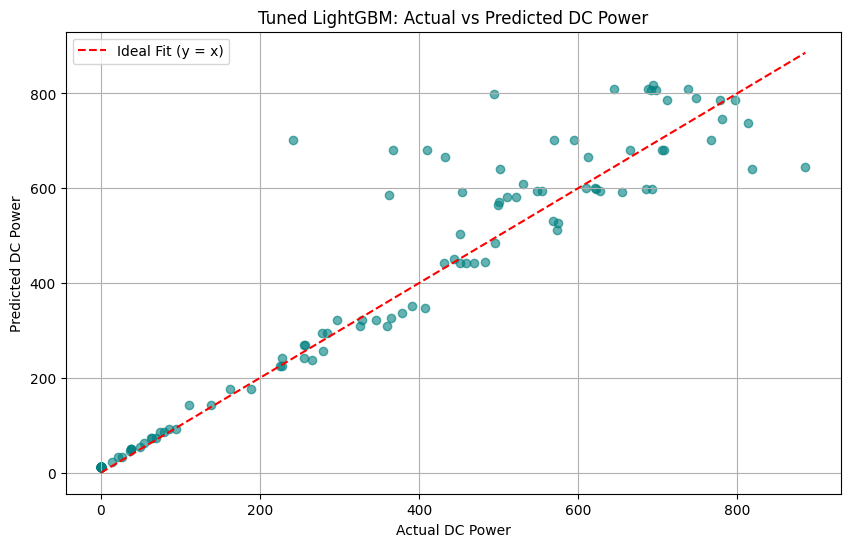

In [206]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred_tuned, alpha=0.6, color='teal')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Ideal Fit (y = x)')
plt.xlabel('Actual DC Power')
plt.ylabel('Predicted DC Power')
plt.title('Tuned LightGBM: Actual vs Predicted DC Power')
plt.legend()
plt.grid(True)
plt.show()



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

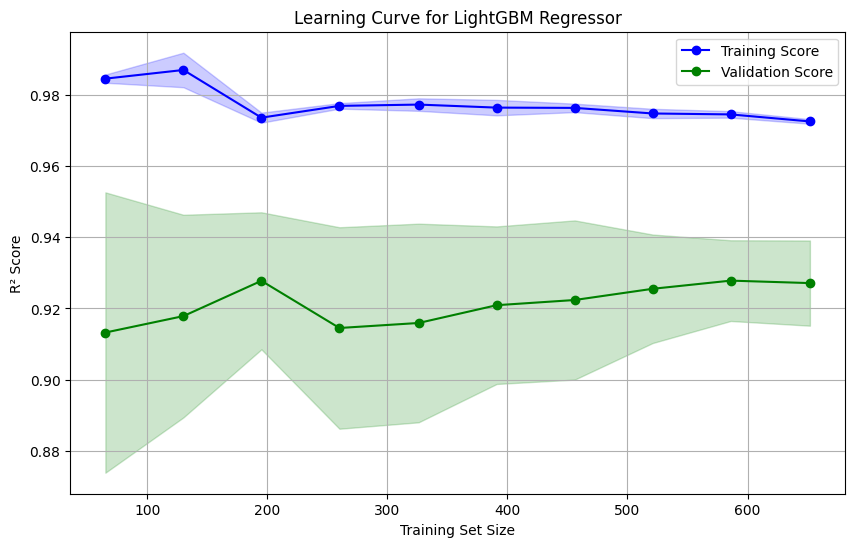

In [207]:
# Initialize the LightGBM Regressor
lgb_model = LGBMRegressor(
    n_estimators=100,
    max_depth=5,
    learning_rate=0.1,
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


### trying to fix the overfitting

In [208]:
lgb_model = LGBMRegressor(
    n_estimators=100,
    max_depth=5,
    learning_rate=0.1,
    reg_alpha=0.1,  # L1 regularization
    reg_lambda=0.1,  # L2 regularization
    random_state=42
)

# Fit the model
lgb_model.fit(X_train, y_train)
# This helps reduce overfitting by penalizing overly complex models.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000057 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 455
[LightGBM] [Info] Number of data points in the train set: 521, number of used features: 3
[LightGBM] [Info] Start training from score 254.223364
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

LGBMRegressor(max_depth=5, random_state=42, reg_alpha=0.1, reg_lambda=0.1)

In [209]:
from lightgbm import LGBMRegressor
from sklearn.model_selection import train_test_split
import lightgbm as lgb

lgb_model = LGBMRegressor(
    n_estimators=1000,
    max_depth=5,
    learning_rate=0.1,
    random_state=42
)

# Fit the model with early stopping
lgb_model.fit(
    X_train, y_train,
    eval_set=[(X_test, y_test)],
    eval_metric='rmse',
    # early_stopping_rounds=50,  # Stops if no improvement in 50 rounds
    # verbose=True
)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 455
[LightGBM] [Info] Number of data points in the train set: 521, number of used features: 3
[LightGBM] [Info] Start training from score 254.223364
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

LGBMRegressor(max_depth=5, n_estimators=1000, random_state=42)

In [210]:
# Make predictions using the trained model
y_pred = lgb_model.predict(X_test)


In [211]:
# Evaluate the model
from sklearn.metrics import r2_score, mean_squared_error

r2 = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)

print(f'LightGBM R² Score: {r2:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')

LightGBM R² Score: 88.91%
Mean Squared Error: 8456.39



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

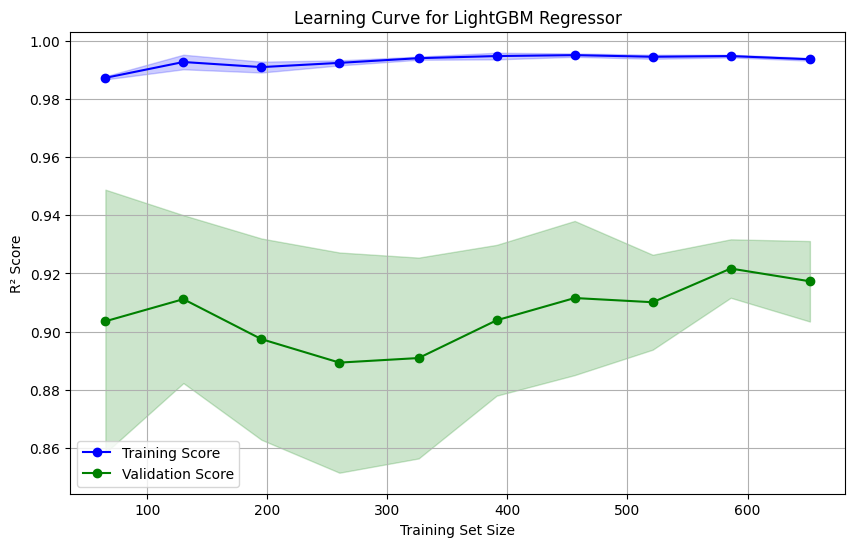

In [212]:
# Initialize the LightGBM Regressor with the final parameters
lgb_model = LGBMRegressor(
    n_estimators=1000,
    max_depth=5,
    learning_rate=0.1,
    reg_alpha=0.1,  # L1 regularization
    reg_lambda=0.1,  # L2 regularization
    random_state=42
)

# Generate the learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',  # Use R² as the evaluation metric
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)  # Vary training sizes from 10% to 100%
)

# Calculate the mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))

# Plot training score
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

# Plot validation score
plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

# Labels, title, and grid
plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


In [213]:
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,  # Make trees shallower
    learning_rate=0.05,  # Slower learning
    reg_alpha=1.0,  # Stronger L1 regularization
    reg_lambda=1.0,  # Stronger L2 regularization
    random_state=42
)


In [214]:
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,
    num_leaves=20,  # Fewer leaves per tree
    learning_rate=0.05,
    random_state=42
)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

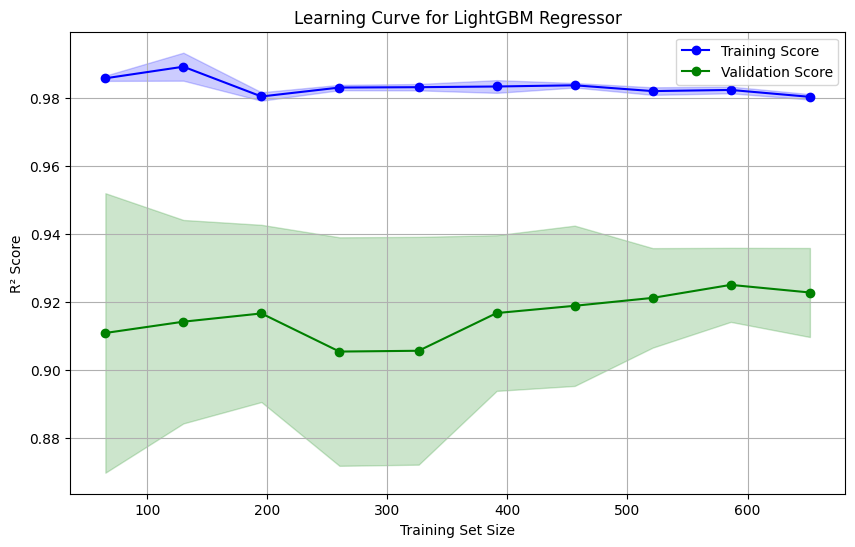

In [215]:
# Initialize the LightGBM Regressor with final parameters
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=5,
    learning_rate=0.05,
    reg_alpha=1.0,  # Stronger L1 regularization
    reg_lambda=1.0,  # Stronger L2 regularization
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,  # 5-fold cross-validation
    scoring='r2',  # Use R² as the metric
    n_jobs=-1,  # Use all available cores
    train_sizes=np.linspace(0.1, 1.0, 10)  # Training set sizes from 10% to 100%
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))

# Plot training score
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

# Plot validation score
plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

# Labels and title
plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


In [216]:
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,
    num_leaves=10,  # Fewer leaf nodes for simplicity
    learning_rate=0.05,
    reg_alpha=10.0,  # Stronger L1 regularization
    reg_lambda=10.0,  # Stronger L2 regularization
    random_state=42
)


In [217]:
lgb_model = LGBMRegressor(
    n_estimators=300,
    max_depth=2,
    num_leaves=5,  # Very few leaves
    learning_rate=0.05,
    random_state=42
)


In [218]:
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,
    num_leaves=20,
    learning_rate=0.05,
    reg_alpha=1.0,
    reg_lambda=1.0,
    feature_fraction=0.8,  # Use only 80% of features per iteration
    bagging_fraction=0.8,  # Use only 80% of data per iteration
    bagging_freq=5,  # Perform bagging every 5 iterations
    random_state=42
)


In [219]:
y_train_log = np.log1p(y_train)  # Apply log transformation
y_test_log = np.log1p(y_test)

# Train the model on transformed target
lgb_model.fit(X_train, y_train_log)
y_pred_log = lgb_model.predict(X_test)

# Reverse the log transformation for evaluation
y_pred = np.expm1(y_pred_log)


[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000041 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 455
[LightGBM] [Info] Number of data points in the train set: 521, number of used features: 3
[LightGBM] [Info]

In [220]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'max_depth': [2, 3, 4],
    'num_leaves': [5, 10, 20],
    'learning_rate': [0.01, 0.05, 0.1],
    'reg_alpha': [1.0, 10.0],
    'reg_lambda': [1.0, 10.0]
}

grid_search = GridSearchCV(estimator=LGBMRegressor(n_estimators=300, random_state=42),
                           param_grid=param_grid, cv=3, scoring='r2', n_jobs=-1)

grid_search.fit(X_train, y_train)
print(f'Best Parameters: {grid_search.best_params_}')



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

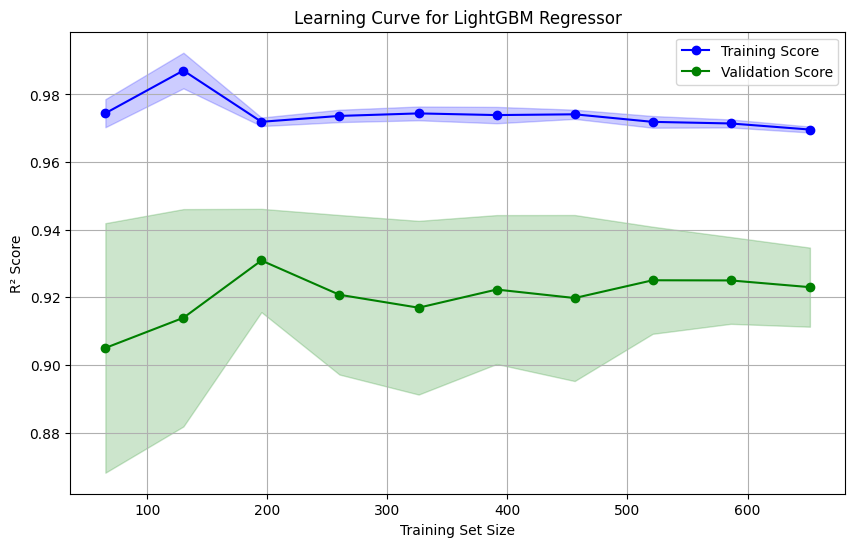

In [221]:
# Initialize the LightGBM Regressor with adjusted parameters
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,
    num_leaves=10,
    learning_rate=0.05,
    reg_alpha=10.0,
    reg_lambda=10.0,
    feature_fraction=0.8,
    bagging_fraction=0.8,
    bagging_freq=5,
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and std of scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))

plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


### fixed

In [222]:
lgb_model = LGBMRegressor(
    n_estimators=300,
    max_depth=2,
    num_leaves=5,
    learning_rate=0.05,
    reg_alpha=10.0,
    reg_lambda=10.0,
    feature_fraction=0.8,
    bagging_fraction=0.8,
    bagging_freq=5,
    random_state=42
)


In [223]:
reg_alpha=130.0
reg_lambda=130.0



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

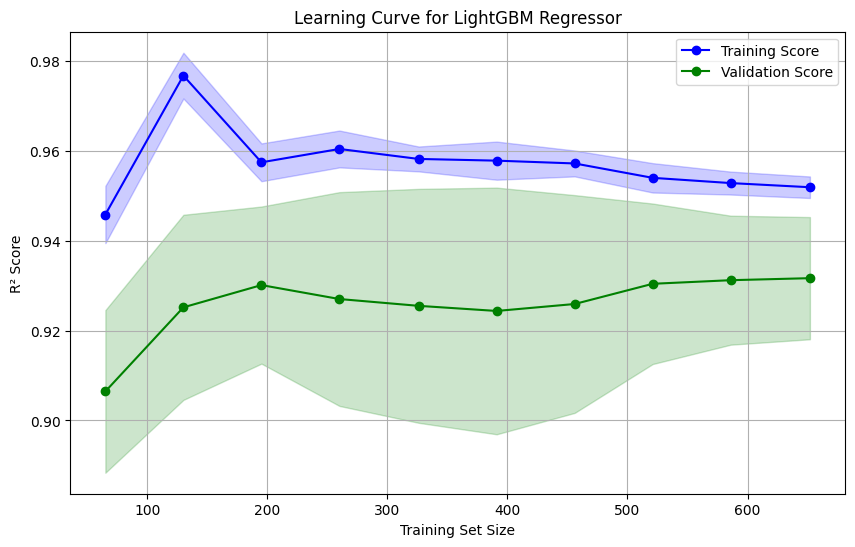

In [224]:
# Initialize LightGBM Regressor with tuned hyperparameters
lgb_model = LGBMRegressor(
    n_estimators=300,
    max_depth=2,
    num_leaves=5,
    learning_rate=0.05,
    reg_alpha=130.0,
    reg_lambda=130.0,
    feature_fraction=0.8,
    bagging_fraction=0.8,
    bagging_freq=3,
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)  # Training set sizes from 10% to 100%
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)


plt.figure(figsize=(10, 6))


plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')


plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')


plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


In [225]:
for size, train_score, val_score in zip(train_sizes, train_scores_mean, test_scores_mean):
    print(f"Training Size: {size}, Training R²: {train_score:.4f}, Validation R²: {val_score:.4f}")


Training Size: 65, Training R²: 0.9459, Validation R²: 0.9065
Training Size: 130, Training R²: 0.9768, Validation R²: 0.9252
Training Size: 195, Training R²: 0.9575, Validation R²: 0.9301
Training Size: 260, Training R²: 0.9604, Validation R²: 0.9270
Training Size: 326, Training R²: 0.9582, Validation R²: 0.9255
Training Size: 391, Training R²: 0.9578, Validation R²: 0.9244
Training Size: 456, Training R²: 0.9572, Validation R²: 0.9259
Training Size: 521, Training R²: 0.9540, Validation R²: 0.9304
Training Size: 586, Training R²: 0.9529, Validation R²: 0.9312
Training Size: 652, Training R²: 0.9519, Validation R²: 0.9317


In [226]:
lgb_model.fit(X_train, y_train)
y_pred = lgb_model.predict(X_test)

r2 = r2_score(y_test, y_pred)
print(f'Final R² Score: {r2:.4f}')

[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000052 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 455
[LightGBM] [Info] Number of data points in the train set: 521, number of used features: 3
[LightGBM] [Info]

## CatBoost Regressor

In [227]:
pip install catboost


Note: you may need to restart the kernel to use updated packages.


In [228]:
from catboost import CatBoostRegressor
# Initialize CatBoost Regressor
catboost_model = CatBoostRegressor(iterations=500, depth=8, learning_rate=0.1,
                                   loss_function='RMSE', verbose=50, random_state=42)

# Train the model
catboost_model.fit(X_train, y_train)


0:	learn: 290.5369996	total: 55.1ms	remaining: 27.5s
50:	learn: 56.0820319	total: 137ms	remaining: 1.21s
100:	learn: 43.7510273	total: 216ms	remaining: 854ms
150:	learn: 32.9260032	total: 295ms	remaining: 683ms
200:	learn: 25.8656039	total: 374ms	remaining: 557ms
250:	learn: 21.0799502	total: 450ms	remaining: 447ms
300:	learn: 17.7289259	total: 537ms	remaining: 355ms
350:	learn: 14.6365932	total: 648ms	remaining: 275ms
400:	learn: 12.1794532	total: 734ms	remaining: 181ms
450:	learn: 10.4450239	total: 849ms	remaining: 92.2ms
499:	learn: 8.8650142	total: 934ms	remaining: 0us


In [229]:
# Predict on test data
y_pred = catboost_model.predict(X_test)

# Evaluate the model
r2 = r2_score(y_test, y_pred) * 100  # R² in percentage
mse = mean_squared_error(y_test, y_pred)

print(f'CatBoost R² Score: {r2:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')


CatBoost R² Score: 90.98%
Mean Squared Error: 6878.78


In [230]:
# Perform 5-fold cross-validation
cv_scores = cross_val_score(catboost_model, X, y, cv=5, scoring='r2')

print(f'Cross-Validation R² Scores: {cv_scores}')
print(f'Mean CV R² Score: {cv_scores.mean() * 100:.2f}%')


0:	learn: 275.1022450	total: 2.99ms	remaining: 1.49s
50:	learn: 58.0655738	total: 83.5ms	remaining: 735ms
100:	learn: 47.9430652	total: 160ms	remaining: 630ms
150:	learn: 39.2743484	total: 239ms	remaining: 551ms
200:	learn: 32.5636561	total: 318ms	remaining: 473ms
250:	learn: 26.7487761	total: 398ms	remaining: 395ms
300:	learn: 21.8446196	total: 478ms	remaining: 316ms
350:	learn: 17.9553190	total: 558ms	remaining: 237ms
400:	learn: 16.0742293	total: 639ms	remaining: 158ms
450:	learn: 13.4706228	total: 718ms	remaining: 78ms
499:	learn: 11.6264110	total: 796ms	remaining: 0us
0:	learn: 267.9784218	total: 2.97ms	remaining: 1.48s
50:	learn: 57.1874150	total: 83.6ms	remaining: 736ms
100:	learn: 41.8531039	total: 165ms	remaining: 653ms
150:	learn: 32.0454038	total: 245ms	remaining: 566ms
200:	learn: 25.0593508	total: 323ms	remaining: 480ms
250:	learn: 20.8856794	total: 402ms	remaining: 398ms
300:	learn: 17.7247727	total: 483ms	remaining: 319ms
350:	learn: 15.1001133	total: 561ms	remaining: 23

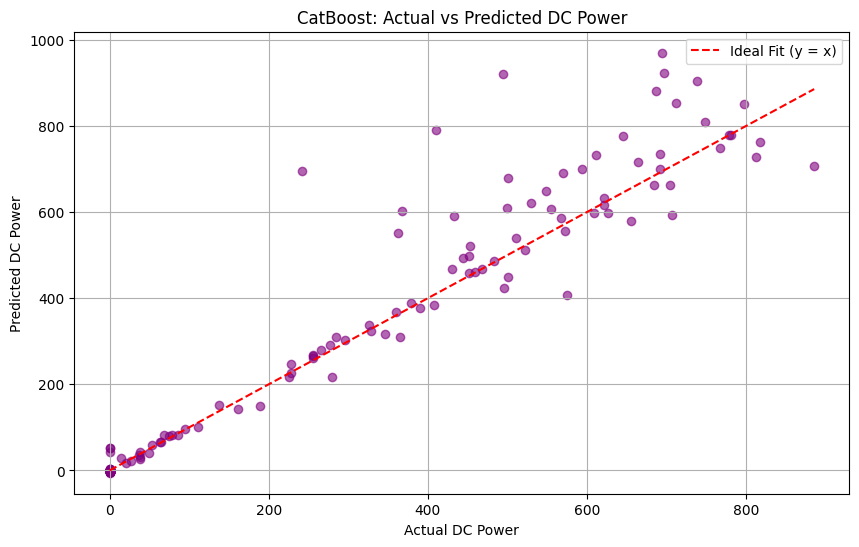

In [231]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='purple')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Ideal Fit (y = x)')
plt.xlabel('Actual DC Power')
plt.ylabel('Predicted DC Power')
plt.title('CatBoost: Actual vs Predicted DC Power')
plt.legend()
plt.grid(True)
plt.show()


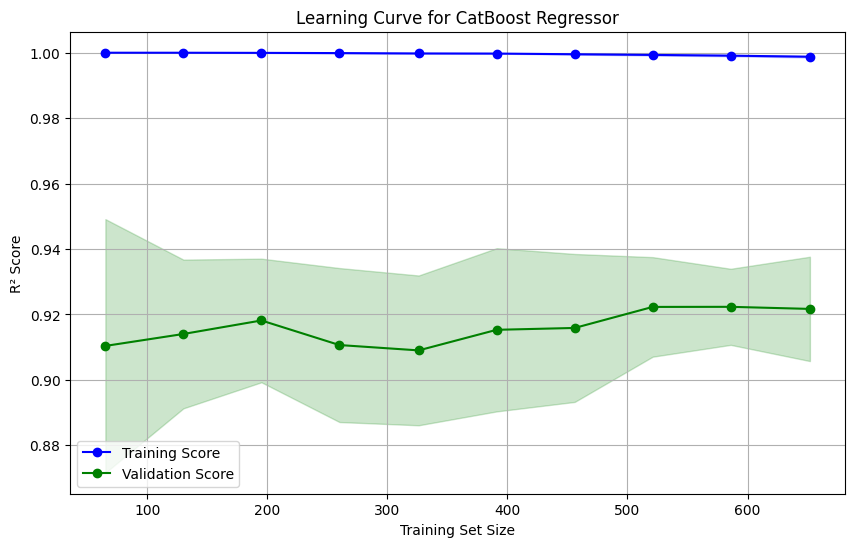

In [232]:
# Create learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=CatBoostRegressor(iterations=500, depth=8, learning_rate=0.1,
                                loss_function='RMSE', random_state=42, verbose=0),
    X=X, y=y, cv=5, scoring='r2', n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for CatBoost Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


## Final LightGBM

In [233]:
# Split data into train/test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [234]:
# Initialize LightGBM Regressor
lgb_model = LGBMRegressor(
    n_estimators=300,
    max_depth=3,
    num_leaves=10,
    learning_rate=0.05,
    reg_alpha=130.0,
    reg_lambda=130.0,
    random_state=42
)


In [235]:
# Train the Model
lgb_model.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 573
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info] Start training from score 249.115540
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

LGBMRegressor(learning_rate=0.05, max_depth=3, n_estimators=300, num_leaves=10,
              random_state=42, reg_alpha=130.0, reg_lambda=130.0)

In [236]:
y_pred = lgb_model.predict(X_test)

In [237]:
# Evaluate the Model
r2 = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)

In [238]:
print(f'R² Score: {r2:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')

R² Score: 96.52%
Mean Squared Error: 3152.85


In [239]:
# Generate Learning Curve Data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model, X=X, y=y, cv=5, scoring='r2', n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

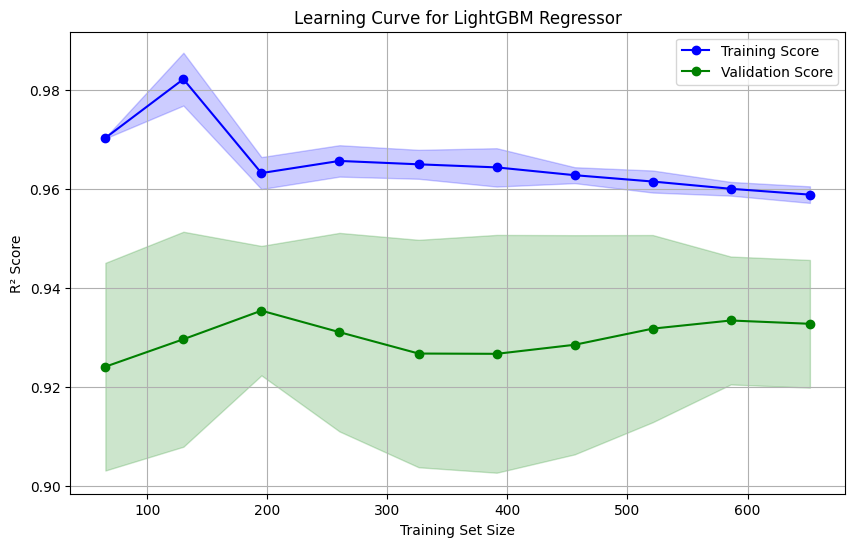

In [240]:
# Plot the Learning Curve
plt.figure(figsize=(10, 6))

plt.plot(train_sizes, np.mean(train_scores, axis=1), 'o-', color='blue', label='Training Score')
plt.plot(train_sizes, np.mean(test_scores, axis=1), 'o-', color='green', label='Validation Score')

# Add Shaded Area for Standard Deviation
plt.fill_between(train_sizes,
                 np.mean(train_scores, axis=1) - np.std(train_scores, axis=1),
                 np.mean(train_scores, axis=1) + np.std(train_scores, axis=1),
                 alpha=0.2, color='blue')
plt.fill_between(train_sizes,
                 np.mean(test_scores, axis=1) - np.std(test_scores, axis=1),
                 np.mean(test_scores, axis=1) + np.std(test_scores, axis=1),
                 alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()

## LSTM Model for Generation Power

In [241]:
df2 = solar.copy()

In [242]:
df2.head()

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING,date
0,2020-05-15,4UPUqMRk7TRMgml,0.0,0.0,9425.000000,2.429011e+06,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
1,2020-05-15,81aHJ1q11NBPMrL,0.0,0.0,0.000000,1.215279e+09,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
2,2020-05-15,9kRcWv60rDACzjR,0.0,0.0,3075.333333,2.247720e+09,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
3,2020-05-15,Et9kgGMDl729KT4,0.0,0.0,269.933333,1.704250e+06,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15
4,2020-05-15,IQ2d7wF4YD8zU1Q,0.0,0.0,3177.000000,1.994153e+07,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2020-05-15


In [243]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DATE_TIME            67698 non-null  datetime64[ns]
 1   SOURCE_KEY           67698 non-null  object        
 2   DC_POWER             67698 non-null  float64       
 3   AC_POWER             67698 non-null  float64       
 4   DAILY_YIELD          67698 non-null  float64       
 5   TOTAL_YIELD          67698 non-null  float64       
 6   AMBIENT_TEMPERATURE  67698 non-null  float64       
 7   MODULE_TEMPERATURE   67698 non-null  float64       
 8   IRRADIATION          67698 non-null  float64       
 9   DATE                 67698 non-null  object        
 10  TIME                 67698 non-null  object        
 11  DAY                  67698 non-null  int32         
 12  MONTH                67698 non-null  int32         
 13  WEEK                 67698 non-

In [244]:
X= df2[['AMBIENT_TEMPERATURE','MODULE_TEMPERATURE','IRRADIATION']]
y= df2['DC_POWER']

In [245]:
df2['DATE_TIME'] = pd.to_datetime(df2['DATE_TIME'])  
df2.set_index('DATE_TIME', inplace=True)
df2=df2.resample("H")["AMBIENT_TEMPERATURE","MODULE_TEMPERATURE","IRRADIATION","DC_POWER"].mean()
df2.head()

,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DC_POWER
DATE_TIME,,,,
2020-05-15 00:00:00,26.767055,24.582656,0.0,0.0
2020-05-15 01:00:00,26.505909,25.172109,0.0,0.0
2020-05-15 02:00:00,26.296562,24.555514,0.0,0.0
2020-05-15 03:00:00,26.141691,24.627655,0.0,0.0
2020-05-15 04:00:00,25.509473,24.658230,0.0,0.0


In [246]:
def df_to_X_y(df, target_column, window_size=6):

    df_as_np = df.drop(columns=[target_column]).to_numpy()  # Features as numpy array
    target_as_np = df[target_column].to_numpy()  # Target (y) as numpy array

    X = []
    y = []

    for i in range(len(df_as_np) - window_size):
        X.append(df_as_np[i:i + window_size])  # Sliding window for X features
        y.append(target_as_np[i + window_size])  # Corresponding target

    return np.array(X), np.array(y)

# Apply the function to your data
X, y = df_to_X_y(df2, target_column='DC_POWER', window_size=6)

# Check shapes
X.shape, y.shape


((810, 6, 3), (810,))

In [247]:
# making a train and test dataset to train the model, This is an 80-10-10 split
X_train, y_train  = X[:648], y[:648]
X_val, y_val  = X[648:729], y[648:729]
X_test, y_test  = X[729:], y[729:]

In [248]:
print(X_train.shape, y_train.shape)
print(X_val.shape, y_val.shape)
print(X_test.shape, y_test.shape)

(648, 6, 3) (648,)
(81, 6, 3) (81,)
(81, 6, 3) (81,)


In [249]:
from sklearn.preprocessing import MinMaxScaler
# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Reshape the 3D arrays to 2D (if applicable)
n_samples, n_timesteps, n_features = X_train.shape
X_train_reshaped = X_train.reshape(-1, n_features)
X_val_reshaped = X_val.reshape(-1, n_features)
X_test_reshaped = X_test.reshape(-1, n_features)

# Scale the reshaped data
X_train_scaled_reshaped = scaler.fit_transform(X_train_reshaped)
X_val_scaled_reshaped = scaler.transform(X_val_reshaped)
X_test_scaled_reshaped = scaler.transform(X_test_reshaped)

# Reshape back to 3D
X_train_scaled = X_train_scaled_reshaped.reshape(n_samples, n_timesteps, n_features)
X_val_scaled = X_val_scaled_reshaped.reshape(X_val.shape)
X_test_scaled = X_test_scaled_reshaped.reshape(X_test.shape)


In [250]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Input, InputLayer

# Defining the model and adding layers into the LSTM model
model1 = Sequential()
# Assuming input shape of (6, 3) for 60 minutes of daily yield data
model1.add(InputLayer(input_shape=(6, 3)))  # 5 time steps, 1 feature

# LSTM layer with 32 units, reduced from 64 to prevent overfitting
model1.add(LSTM(32))

# Adding a Dense layer with 8 units and ReLU activation
model1.add(Dense(8, activation='relu'))

# Adding Dropout for regularization (optional, 0.2 means 20% dropout rate)
model1.add(Dropout(0.2))
# Output layer for a single value prediction with linear activation
model1.add(Dense(1, activation='linear'))

# Compile the model
model1.compile(optimizer='adam', loss='mse')

# Model summary to check the architecture
model1.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_1 (LSTM)                        │ (None, 32)                  │           4,608 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 8)                   │             264 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 8)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 1)                   │               9 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,881 (19.07 KB)

 Trainable params: 4,881 (19.07 KB)

 Non-trainable params: 0 (0.00 B)

### Evaluate model

In [251]:
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
# Add early stopping to stop training if the model stops improving
es = EarlyStopping(
    monitor='val_mae',  # Stop if RMSE doesn't improve
    patience=50,  # Wait 10 epochs before stopping
    restore_best_weights=True,  # Restore the best weights after stopping
    verbose=1
)

model1.compile(
      optimizer=Adam(learning_rate=1e-3),
      loss='mean_squared_error',
       metrics=["mae"]

)

In [252]:
# Fit the model with better structure, additional callbacks, and dynamic batch size
history1=model1.fit(
    X_train_scaled,
    y_train,
    validation_data=(X_val_scaled, y_val),  # Provide validation data for real-time evaluation
    epochs=75,  # Increase epochs for a more robust model, can be adjusted later
    batch_size=32,  # Use a moderate batch size (adjust based on your hardware)
    callbacks=[es],  # Include EarlyStopping for better convergence
    verbose=1  # Show training progress
)

Epoch 1/75
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - loss: 178562.2812 - mae: 269.5522 - val_loss: 111418.0625 - val_mae: 225.7113
Epoch 2/75
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 163113.2188 - mae: 254.5422 - val_loss: 110684.0391 - val_mae: 225.2864
Epoch 3/75
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 140696.7188 - mae: 223.3638 - val_loss: 108595.7656 - val_mae: 224.4097
Epoch 4/75
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 152996.8281 - mae: 244.6808 - val_loss: 105800.0156 - val_mae: 223.3613
Epoch 5/75
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 180195.2656 - mae: 281.0043 - val_loss: 103689.8125 - val_mae: 222.4947
Epoch 6/75
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 157555.6562 - mae: 257.1015 - val_loss: 101962.1016 - val_mae: 221.8287
Epoch 7/75
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 152224.3125 - mae: 250.3615 - val_loss: 99774.2188 - val_mae: 220.9562
Epoch 8/75
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 159874.8906 - mae: 263.2509 - va

In [253]:
# Make predictions on the training data
train_predictions = model1.predict(X_train_scaled).flatten()

# Create a DataFrame to compare predictions and actual values
train_results = pd.DataFrame({
    'Train Predictions': train_predictions,
    'Actual Values': y_train.flatten()  # Ensure y_train is also flattened for consistency
})

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


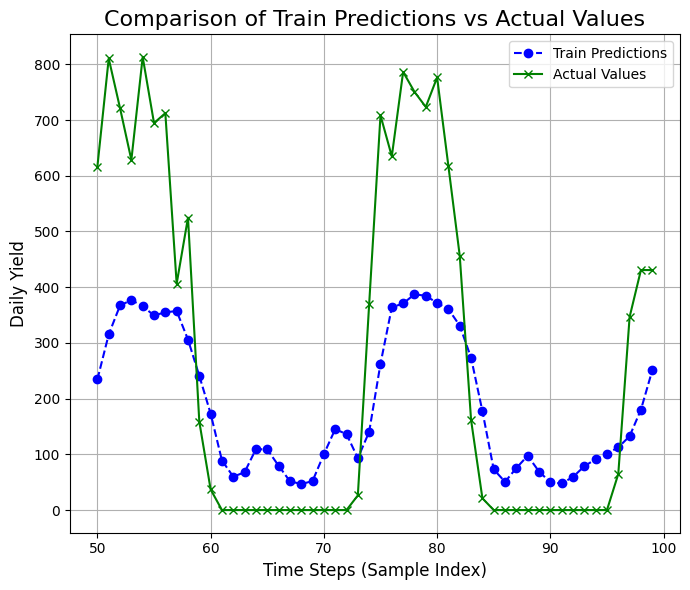

In [254]:
# Set plot size for better visibility
plt.figure(figsize=(7, 6))

# Plot Train Predictions and Actual Values
plt.plot(train_results['Train Predictions'][50:100], label='Train Predictions', color='blue', linestyle='--', marker='o')
plt.plot(train_results['Actual Values'][50:100], label='Actual Values', color='green', linestyle='-', marker='x')

# Add labels, title, and grid
plt.title('Comparison of Train Predictions vs Actual Values', fontsize=16)
plt.xlabel('Time Steps (Sample Index)', fontsize=12)
plt.ylabel('Daily Yield', fontsize=12)
plt.grid(True)

# Add a legend to differentiate the lines
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

In [255]:
# Make predictions on the validation data
val_predictions = model1.predict(X_val).flatten()

# Create a DataFrame to compare predictions and actual values
val_results = pd.DataFrame({
    'Val Predictions': val_predictions,
    'Actual Values': y_val.flatten()  # Ensure y_val is flattened for consistency
})

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


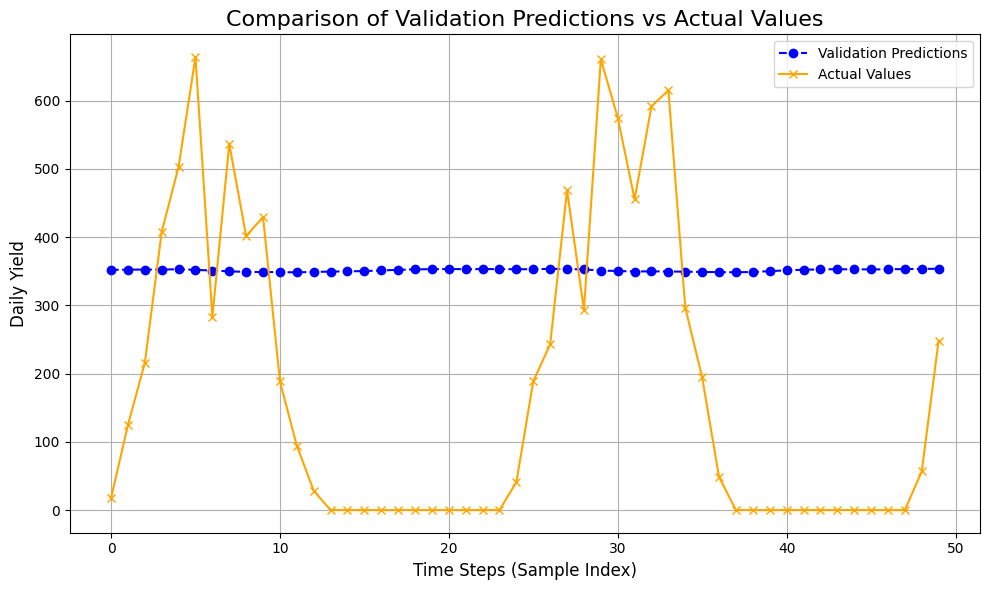

In [256]:
# Set plot size for better visibility
plt.figure(figsize=(10, 6))

# Plot Validation Predictions and Actual Values
plt.plot(val_results['Val Predictions'][:50], label='Validation Predictions', color='blue', linestyle='--', marker='o')
plt.plot(val_results['Actual Values'][:50], label='Actual Values', color='orange', linestyle='-', marker='x')

# Add labels, title, and grid
plt.title('Comparison of Validation Predictions vs Actual Values', fontsize=16)
plt.xlabel('Time Steps (Sample Index)', fontsize=12)
plt.ylabel('Daily Yield', fontsize=12)
plt.grid(True)

# Add a legend to differentiate the lines
plt.legend()
# Show the plot
plt.tight_layout()
plt.show()

In [257]:
# Make predictions on the test data
test_predictions_1 = model1.predict(X_test_scaled).flatten()

# Create a DataFrame to compare predictions and actual values
test_results_1 = pd.DataFrame({
    'Test Predictions': test_predictions_1,
    'Actual Values': y_test.flatten()  # Ensure y_test is flattened for consistency
})

# Display the first few rows of the DataFrame
test_results_1.head()

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


,Test Predictions,Actual Values
0,339.951416,563.974161
1,278.347107,378.734600
2,194.699707,201.544654
3,102.488083,46.031071
4,47.797379,0.000000


In [258]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import pandas as pd

def evaluate_model_performance(y_true, y_pred):
    """
    Evaluates model performance by computing key metrics and generating visualizations.

    Parameters:
    y_true (array-like): Actual values
    y_pred (array-like): Predicted values

    Returns:
    dict: A dictionary containing calculated metrics (MSE, RMSE, MAE, R²)
    """

    # Flattening inputs if they are not 1D
    y_true = y_true.flatten()
    y_pred = y_pred.flatten()

    # Calculating key metrics
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)

    # Printing metrics
    print(f"Mean Squared Error (MSE): {mse:.4f}")
    print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
    print(f"Mean Absolute Error (MAE): {mae:.4f}")
    print(f"R² Score: {r2:.4f}")

    # Residuals calculation
    residuals = y_true - y_pred

    # Plotting residuals distribution
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(residuals, bins=20, edgecolor='black')
    plt.title('Residuals Distribution')
    plt.xlabel('Residual')
    plt.ylabel('Frequency')

    # Plotting Predictions vs Actual Values
    plt.subplot(1, 2, 2)
    plt.scatter(y_true, y_pred, alpha=0.6)
    plt.title('Predictions vs Actual Values')
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.plot([min(y_true), max(y_true)], [min(y_true), max(y_true)], color='red', linestyle='--')  # Ideal line
    plt.tight_layout()
    plt.show()

    # Plotting actual vs predicted over time (for time series or sequential data)
    plt.figure(figsize=(10, 6))
    plt.plot(y_true, label='Actual Values')
    plt.plot(y_pred, label='Predicted Values', alpha=0.7)
    plt.title('Actual vs Predicted Values Over Time')
    plt.xlabel('Index')
    plt.ylabel('Values')
    plt.legend()
    plt.show()

    # Returning a dictionary of computed metrics
    metrics = {
        'MSE': mse,
        'RMSE': rmse,
        'MAE': mae,
        'R²': r2
    }

    return metrics


Mean Squared Error (MSE): 26437.3450
Root Mean Squared Error (RMSE): 162.5956
Mean Absolute Error (MAE): 127.0024
R² Score: 0.5490


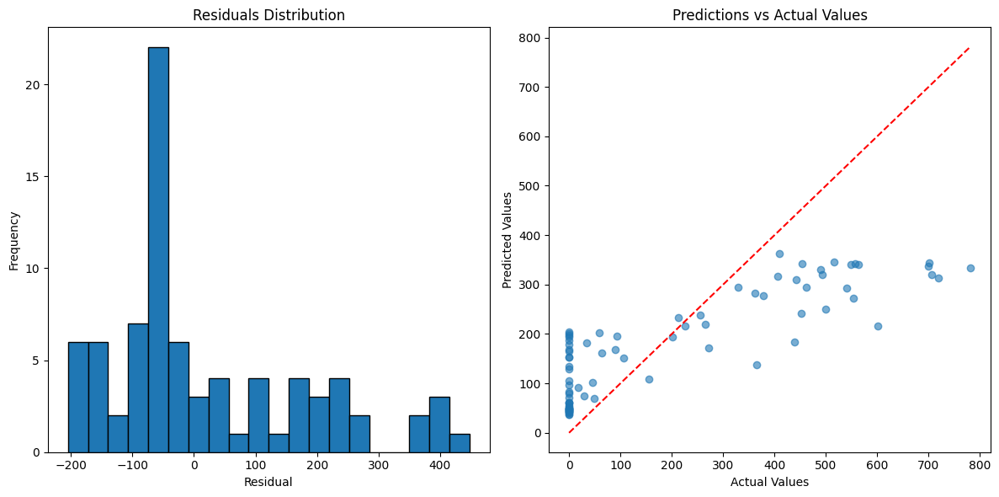

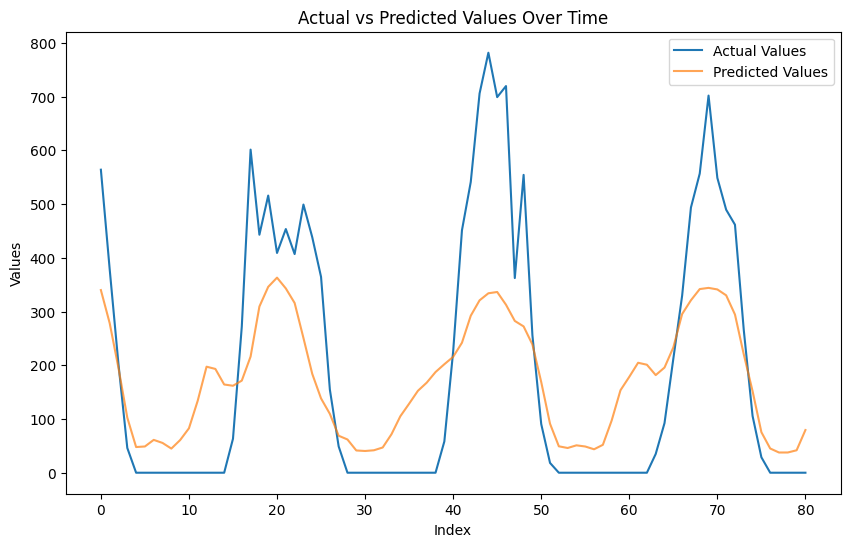

In [259]:
train_metrics_model1 = evaluate_model_performance(y_test, test_predictions_1)

In [260]:
from sklearn.metrics import mean_absolute_error, r2_score

# Step 1: Define the model with optimized hyperparameters
model2 = Sequential()

# Input layer - same window size of (6, 3)
model2.add(LSTM(64, input_shape=(6, 3)))  # Increased LSTM units to 64
model2.add(Dense(16, activation='relu'))
model2.add(Dropout(0.3))

# Output layer with 1 unit for prediction
model2.add(Dense(1, activation='linear'))

# Step 2: Compile the model with Adam optimizer and a lower learning rate
optimizer = Adam(learning_rate=0.001)  # Reduced learning rate for better convergence
model2.compile(optimizer=optimizer, loss='mae',metrics=["mae"])

# Step 3: Define EarlyStopping to prevent overfitting
early_stopping = EarlyStopping(monitor='val_mae', patience=10, restore_best_weights=True)

# Step 4: Train the model with an increased number of epochs and modified batch size
history = model2.fit(X_train_scaled, y_train,
                    validation_data=(X_val_scaled, y_val),
                    epochs=50,  # Increased epochs for better learning
                    batch_size=64,  # Increased batch size
                    callbacks=[early_stopping],
                    verbose=1)

Epoch 1/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - loss: 261.0407 - mae: 261.0407 - val_loss: 225.8858 - val_mae: 225.8858
Epoch 2/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 246.3533 - mae: 246.3533 - val_loss: 225.8258 - val_mae: 225.8258
Epoch 3/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 248.3449 - mae: 248.3449 - val_loss: 225.7229 - val_mae: 225.7229
Epoch 4/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 257.3888 - mae: 257.3888 - val_loss: 225.4486 - val_mae: 225.4486
Epoch 5/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 259.6351 - mae: 259.6351 - val_loss: 224.9788 - val_mae: 224.9788
Epoch 6/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 254.4305 - mae: 254.4305 - val_loss: 224.3467 - val_mae: 224.3467
Epoch 7/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 278.2501 - mae: 278.2501 - val_loss: 223.4503 - val_mae: 223.4503
Epoch 8/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 257.2597 - mae: 257.2597 - val_loss: 222.4903 - val_mae: 222.4903
Epoch 9

In [261]:
test_predictions_2 = model2.predict(X_test_scaled).flatten()

# Create a DataFrame to compare predictions and actual values
test_results_2 = pd.DataFrame({
    'Test Predictions': test_predictions_2,
    'Actual Values': y_test.flatten()  # Ensure y_test is flattened for consistency
})

# Display the first few rows of the DataFrame
test_results_2.head()

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


,Test Predictions,Actual Values
0,240.859848,563.974161
1,239.707352,378.734600
2,223.823929,201.544654
3,166.677307,46.031071
4,9.906977,0.000000


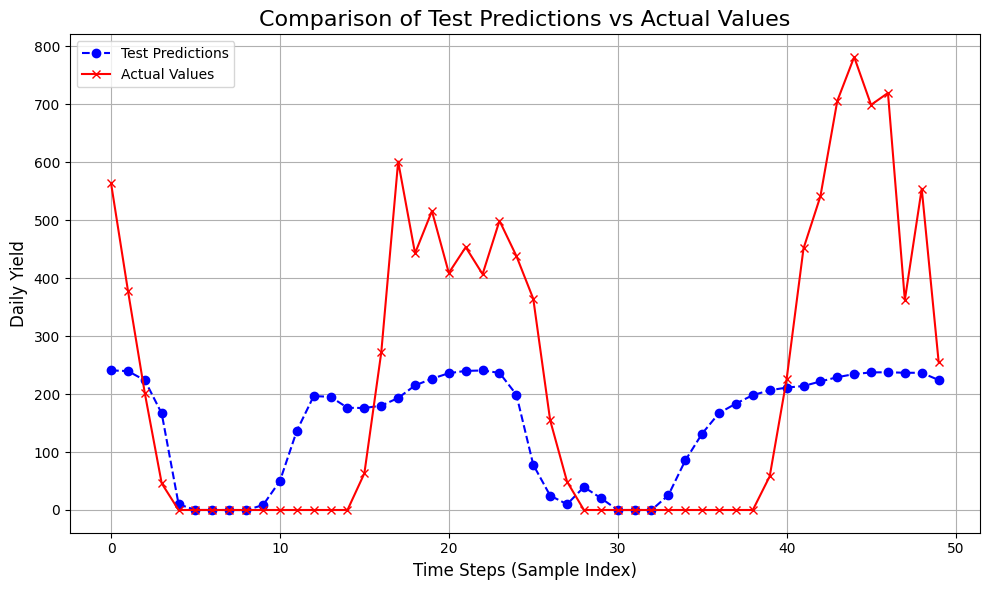

In [262]:
plt.figure(figsize=(10, 6))

# Plot Test Predictions and Actual Values
plt.plot(test_results_2['Test Predictions'][:50], label='Test Predictions', color='blue', linestyle='--', marker='o')
plt.plot(test_results_2['Actual Values'][:50], label='Actual Values', color='red', linestyle='-', marker='x')

# Add labels, title, and grid
plt.title('Comparison of Test Predictions vs Actual Values', fontsize=16)
plt.xlabel('Time Steps (Sample Index)', fontsize=12)
plt.ylabel('Daily Yield', fontsize=12)
plt.grid(True)

# Add a legend to differentiate the lines
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

Mean Squared Error (MSE): 39315.1854
Root Mean Squared Error (RMSE): 198.2806
Mean Absolute Error (MAE): 145.1239
R² Score: 0.3293


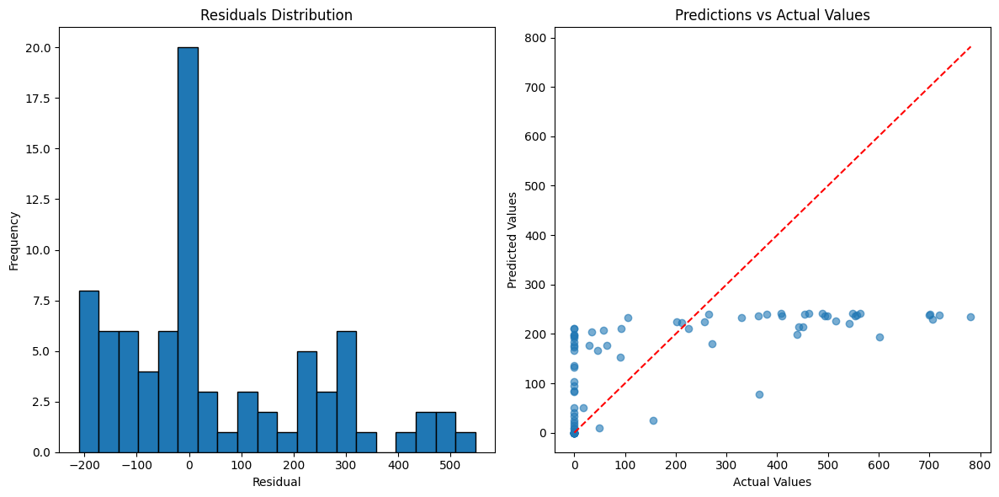

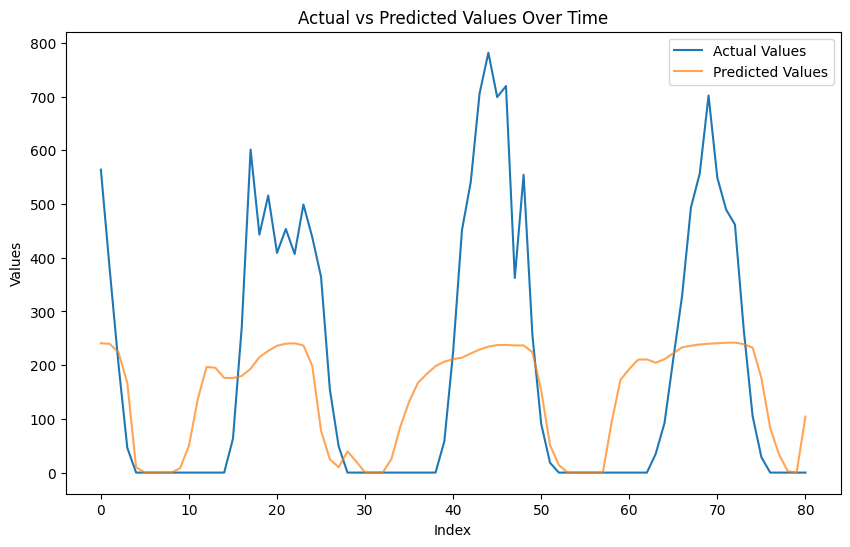

In [263]:
train_metrics_model2 = evaluate_model_performance(y_test, test_predictions_2)

### Evaluate2


In [264]:
from sklearn.metrics import mean_absolute_error, r2_score

# Step 1: Define the model with optimized hyperparameters
model2 = Sequential()

# Input layer - same window size of (6, 3)
model2.add(LSTM(70, input_shape=(6, 3)))  # Increased LSTM units to 64
model2.add(Dense(16, activation='relu'))
model2.add(Dropout(0.3))

# Output layer with 1 unit for prediction
model2.add(Dense(1, activation='linear'))

# Step 2: Compile the model with Adam optimizer and a lower learning rate
optimizer = Adam(learning_rate=0.001)  # Reduced learning rate for better convergence
model2.compile(optimizer=optimizer, loss='mae',metrics=["mae"])

# Step 3: Define EarlyStopping to prevent overfitting
early_stopping = EarlyStopping(monitor='val_mae', patience=10, restore_best_weights=True)

# Step 4: Train the model with an increased number of epochs and modified batch size
history = model2.fit(X_train_scaled, y_train,
                    validation_data=(X_val_scaled, y_val),
                    epochs=100,  # Increased epochs for better learning
                    batch_size=64,  # Increased batch size
                    callbacks=[early_stopping],
                    verbose=1)

Epoch 1/100
11/11 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - loss: 259.7089 - mae: 259.7089 - val_loss: 225.9158 - val_mae: 225.9158
Epoch 2/100
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 252.5041 - mae: 252.5041 - val_loss: 225.8803 - val_mae: 225.8803
Epoch 3/100
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 268.8478 - mae: 268.8478 - val_loss: 225.8171 - val_mae: 225.8171
Epoch 4/100
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 263.2480 - mae: 263.2480 - val_loss: 225.6491 - val_mae: 225.6491
Epoch 5/100
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 259.9587 - mae: 259.9587 - val_loss: 225.3573 - val_mae: 225.3573
Epoch 6/100
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 257.5467 - mae: 257.5467 - val_loss: 225.0669 - val_mae: 225.0669
Epoch 7/100
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 250.7506 - mae: 250.7506 - val_loss: 224.4315 - val_mae: 224.4315
Epoch 8/100
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 275.7150 - mae: 275.7150 - val_loss: 223.3940 - val_mae: 223.3940

In [265]:
test_predictions_2 = model2.predict(X_test_scaled).flatten()

# Create a DataFrame to compare predictions and actual values
test_results_2 = pd.DataFrame({
    'Test Predictions': test_predictions_2,
    'Actual Values': y_test.flatten()  # Ensure y_test is flattened for consistency
})

# Display the first few rows of the DataFrame
test_results_2.head()

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


,Test Predictions,Actual Values
0,562.732849,563.974161
1,432.714264,378.734600
2,155.537994,201.544654
3,3.117724,46.031071
4,0.156131,0.000000


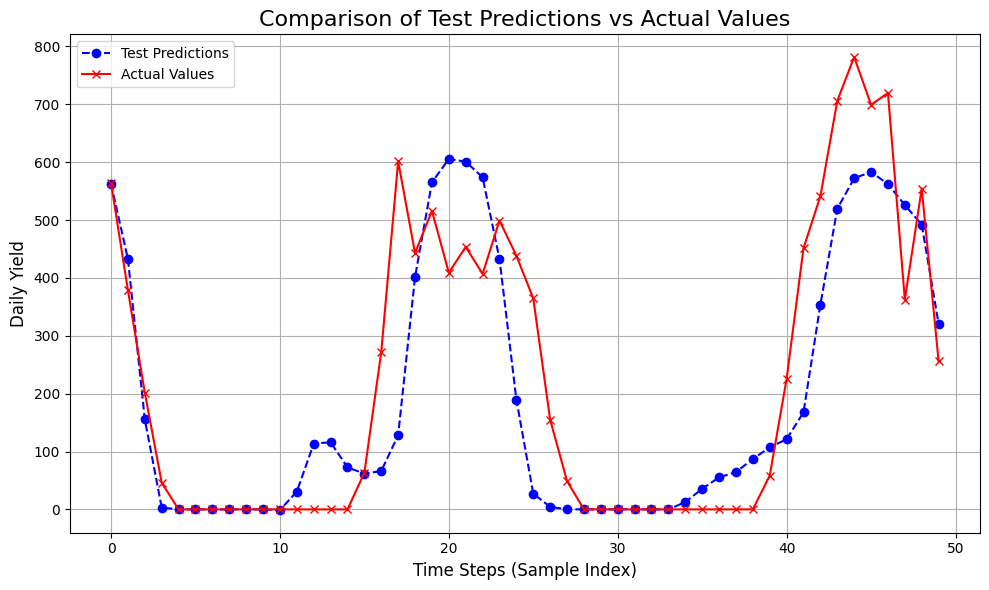

In [266]:
plt.figure(figsize=(10, 6))

# Plot Test Predictions and Actual Values
plt.plot(test_results_2['Test Predictions'][:50], label='Test Predictions', color='blue', linestyle='--', marker='o')
plt.plot(test_results_2['Actual Values'][:50], label='Actual Values', color='red', linestyle='-', marker='x')

# Add labels, title, and grid
plt.title('Comparison of Test Predictions vs Actual Values', fontsize=16)
plt.xlabel('Time Steps (Sample Index)', fontsize=12)
plt.ylabel('Daily Yield', fontsize=12)
plt.grid(True)

# Add a legend to differentiate the lines
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

Mean Squared Error (MSE): 12993.8392
Root Mean Squared Error (RMSE): 113.9905
Mean Absolute Error (MAE): 72.4480
R² Score: 0.7783


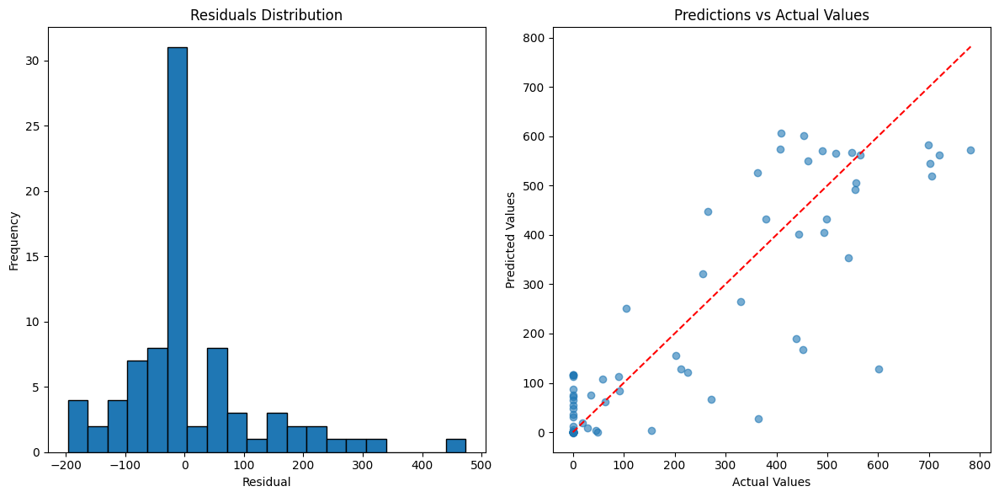

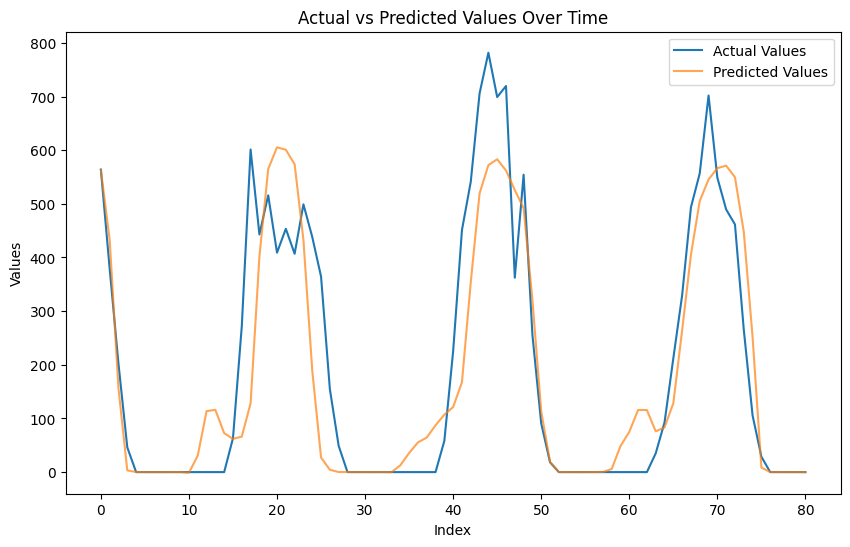

In [267]:
train_metrics_model2 = evaluate_model_performance(y_test, test_predictions_2)

In [268]:
from sklearn.metrics import mean_absolute_error, r2_score

# Step 1: Define the model with optimized hyperparameters
model2 = Sequential()

# Input layer - same window size of (6, 3)
model2.add(LSTM(75, input_shape=(6, 3)))  # Increased LSTM units to 64
model2.add(Dense(16, activation='relu'))
model2.add(Dropout(0.3)) #it was 0.3

# Output layer with 1 unit for prediction
model2.add(Dense(1, activation='linear'))

# Step 2: Compile the model with Adam optimizer and a lower learning rate
optimizer = Adam(learning_rate=0.0009)  # Reduced learning rate to 0.0005 (it was 0.001)
model2.compile(optimizer=optimizer, loss='mae',metrics=["mae"])

# Step 3: Define EarlyStopping to prevent overfitting
early_stopping = EarlyStopping(monitor='val_mae', patience=10, restore_best_weights=True)

# Step 4: Train the model with an increased number of epochs and modified batch size
history = model2.fit(X_train_scaled, y_train,
                    validation_data=(X_val_scaled, y_val),
                    epochs=100,  # Increased epochs for better learning
                    batch_size=32,  # Increased batch size
                    callbacks=[early_stopping],
                    verbose=1)

Epoch 1/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 281.9175 - mae: 281.9175 - val_loss: 225.7862 - val_mae: 225.7862
Epoch 2/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 262.2723 - mae: 262.2723 - val_loss: 225.3840 - val_mae: 225.3840
Epoch 3/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 270.3861 - mae: 270.3861 - val_loss: 224.2141 - val_mae: 224.2141
Epoch 4/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 261.1921 - mae: 261.1921 - val_loss: 222.4796 - val_mae: 222.4796
Epoch 5/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 249.8036 - mae: 249.8036 - val_loss: 219.0896 - val_mae: 219.0896
Epoch 6/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 263.7882 - mae: 263.7882 - val_loss: 214.3207 - val_mae: 214.3207
Epoch 7/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 240.3949 - mae: 240.3949 - val_loss: 213.0047 - val_mae: 213.0047
Epoch 8/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 236.7497 - mae: 236.7497 - val_loss: 205.7580 - val_mae: 205.7580

In [269]:
test_predictions_2 = model2.predict(X_test_scaled).flatten()

# Create a DataFrame to compare predictions and actual values
test_results_2 = pd.DataFrame({
    'Test Predictions': test_predictions_2,
    'Actual Values': y_test.flatten()  # Ensure y_test is flattened for consistency
})

# Display the first few rows of the DataFrame
test_results_2.head()

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


,Test Predictions,Actual Values
0,578.556824,563.974161
1,449.221130,378.734600
2,174.579865,201.544654
3,0.181659,46.031071
4,0.043887,0.000000


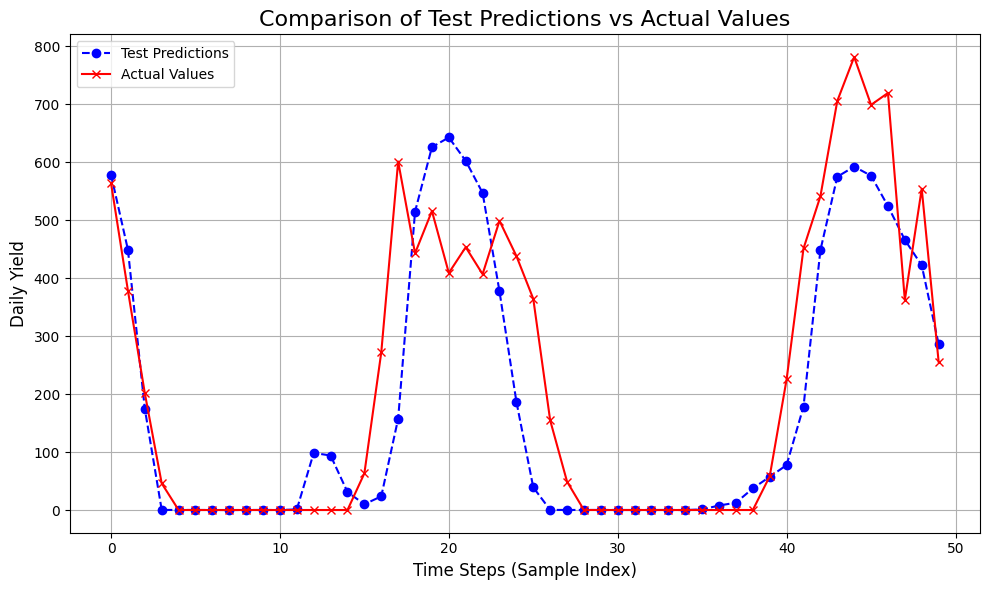

In [270]:
plt.figure(figsize=(10, 6))

# Plot Test Predictions and Actual Values
plt.plot(test_results_2['Test Predictions'][:50], label='Test Predictions', color='blue', linestyle='--', marker='o')
plt.plot(test_results_2['Actual Values'][:50], label='Actual Values', color='red', linestyle='-', marker='x')

# Add labels, title, and grid
plt.title('Comparison of Test Predictions vs Actual Values', fontsize=16)
plt.xlabel('Time Steps (Sample Index)', fontsize=12)
plt.ylabel('Daily Yield', fontsize=12)
plt.grid(True)

# Add a legend to differentiate the lines
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

Mean Squared Error (MSE): 11667.9327
Root Mean Squared Error (RMSE): 108.0182
Mean Absolute Error (MAE): 64.1267
R² Score: 0.8010


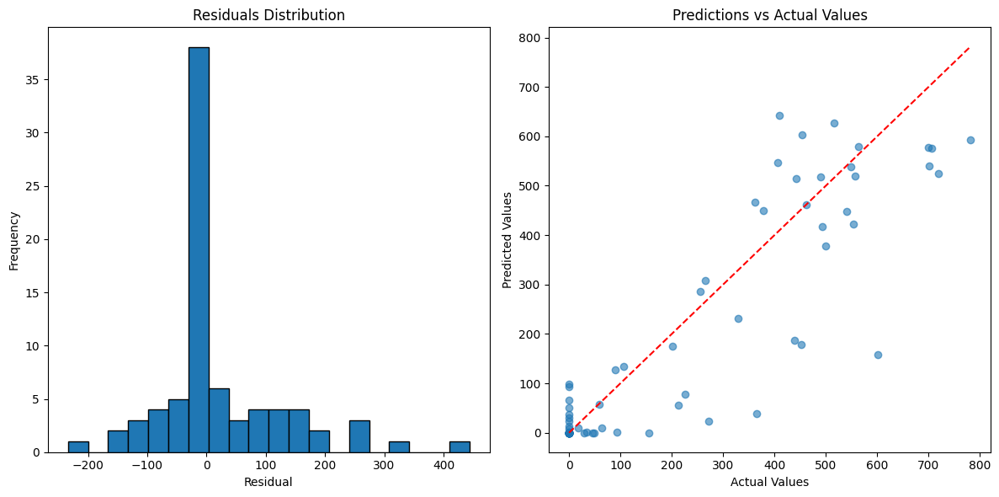

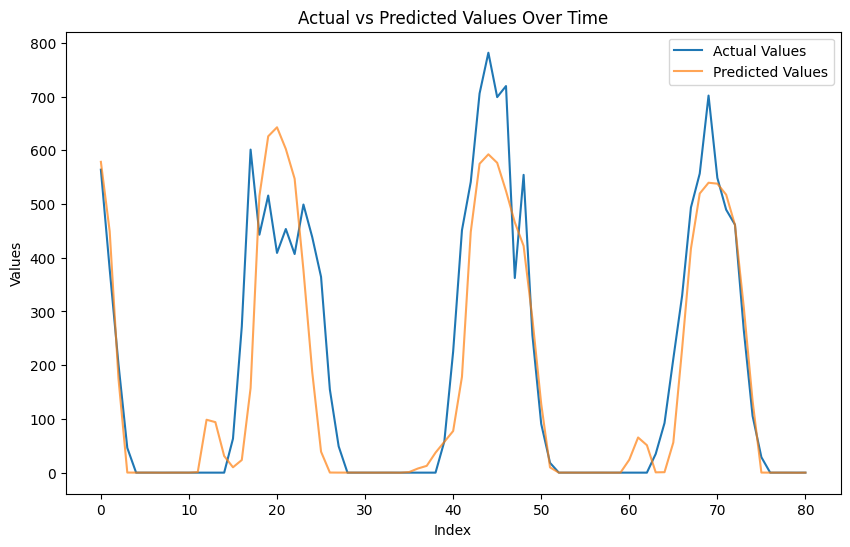

In [271]:
train_metrics_model2 = evaluate_model_performance(y_test, test_predictions_2)

In [272]:
import matplotlib.pyplot as plt

def plot_history(history):
    """
    Plots the model's MAE for both the training and validation sets.
    This will help assess the model's performance and whether it is underfitting or overfitting.
    """
    # Extract values from history
    mae = history.history['mae']
    val_mae = history.history['val_mae']

    epochs = range(1, len(mae) + 1)

    # Plotting MAE
    plt.figure(figsize=(10, 6))

    # MAE plot
    plt.plot(epochs, mae, label='Training MAE')
    plt.plot(epochs, val_mae, label='Validation MAE')
    plt.title('Training and Validation MAE')
    plt.xlabel('Epochs')
    plt.ylabel('Mean Absolute Error (MAE)')
    plt.legend()
    plt.grid(True)

    plt.show()


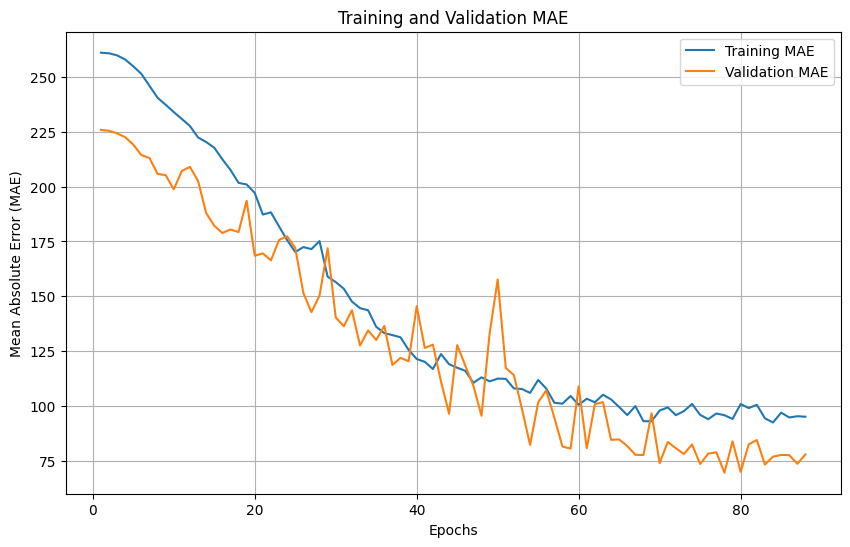

In [273]:
plot_history(history)

## Best model

### XGBoost Model

In [274]:
import numpy as np

# Apply log(y) transformation safely
y_safe = np.where(y < 1e-6, 1e-6, y)


Text(0.5, 0, 'log(PerCapitaConsumption)')

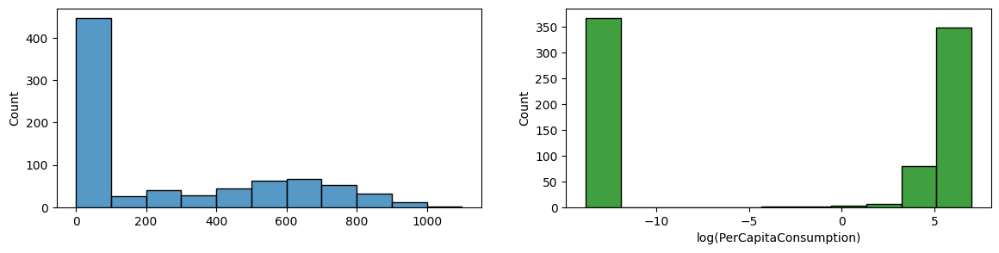

In [275]:
y_log = np.log(y_safe)

plt.figure(figsize=(14, 3))
plt.subplot(1, 2, 1)
sns.histplot(y)

plt.subplot(1, 2, 2)
sns.histplot(y_log, color='green')

plt.xlabel("log(PerCapitaConsumption)")


In [276]:
X_train, X_eval, y_train_log, y_eval_log = train_test_split(X, y_log, random_state=42)


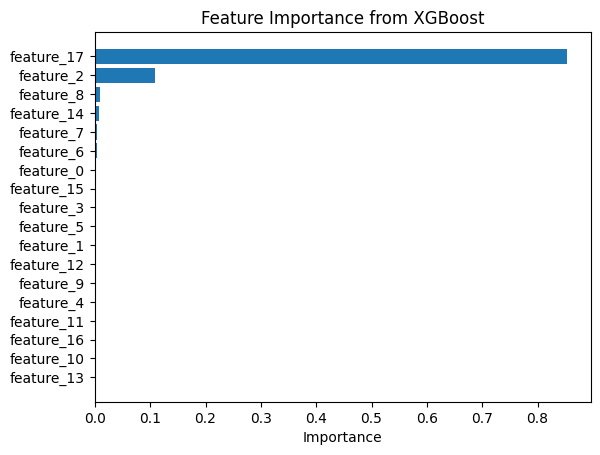

In [277]:
# Reshape 3D input to 2D for XGBoost
X_train_2D = X_train.reshape((X_train.shape[0], -1))

# Instantiate the XGBoost model
model_xgb = XGBRegressor(max_depth=6, n_estimators=300, learning_rate=0.1)

# Fit the model to get feature importance
model_xgb.fit(X_train_2D, y_train_log)
# Get feature importances
feature_importance = model_xgb.feature_importances_

# Create a DataFrame for visualization
importance_df = pd.DataFrame({
    'Feature': [f'feature_{i}' for i in range(X_train_2D.shape[1])],
    'Importance': feature_importance
}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.barh(importance_df['Feature'], importance_df['Importance'])
plt.gca().invert_yaxis()
plt.xlabel('Importance')
plt.title('Feature Importance from XGBoost')
plt.show()


In [278]:
model_xgb_early_stopping = XGBRegressor(
    max_depth=4,
    n_estimators=300,
    eval_metric=["rmse"],
    learning_rate=0.1,
    early_stopping_rounds=10
)

Best Validation Score 2.199920467134631


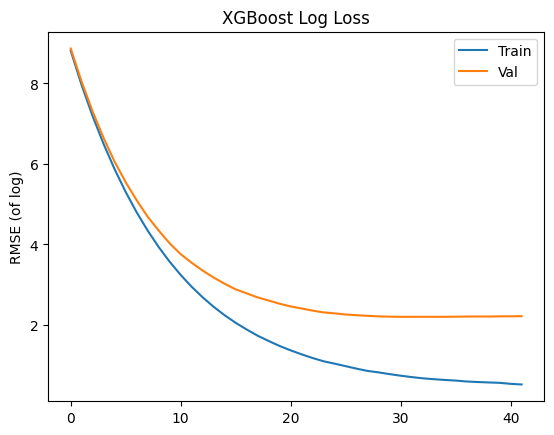

In [279]:
# Get original shapes
n_samples, n_timesteps, n_features = X_train.shape

# Flatten the data to 2D for StandardScaler
X_train_2D = X_train.reshape(-1, n_features)
X_eval_2D = X_eval.reshape(-1, n_features)

# Initialize the standard scaler for preprocessing
preproc = StandardScaler()

# Fit the scaler on the training data and transform both train and eval sets
X_train_scaled_2D = preproc.fit_transform(X_train_2D)
X_eval_scaled_2D = preproc.transform(X_eval_2D)

# Reshape back to original shape (if needed for LSTM or 3D models)
X_train_preproc = X_train_scaled_2D.reshape(n_samples, n_timesteps, n_features)
X_eval_preproc = X_eval_scaled_2D.reshape(X_eval.shape[0], n_timesteps, n_features)

X_train_flat = X_train_preproc.reshape(X_train_preproc.shape[0], -1)
X_eval_flat = X_eval_preproc.reshape(X_eval_preproc.shape[0], -1)

# Train model
model_xgb_early_stopping.fit(
    X_train_flat,
    y_train_log,
    verbose=False,
    eval_set=[(X_train_flat, y_train_log), (X_eval_flat, y_eval_log)],
)

# Retrieve performance metrics
results = model_xgb_early_stopping.evals_result()
epochs = len(results['validation_0']["rmse"])
x_axis = range(0, epochs)

# Plot RMSLE loss
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['rmse'], label='Train')
ax.plot(x_axis, results['validation_1']['rmse'], label='Val')
ax.legend(); plt.ylabel('RMSE (of log)'); plt.title('XGBoost Log Loss')

print("Best Validation Score", min(results['validation_1']['rmse']))


In [280]:
y_pred = np.exp(y_pred_log)
y_eval = np.exp(y_eval_log)
print(y_eval)

[9.72070648e+02 1.00000000e-06 2.08237235e+02 5.83840060e+02
 6.08799838e+02 4.93585649e+02 7.25954173e+02 1.00000000e-06
 4.94281819e+02 1.00000000e-06 1.00000000e-06 1.00000000e-06
 7.26822652e+02 1.00000000e-06 1.00000000e-06 1.00000000e-06
 6.31369206e+02 1.00000000e-06 1.00000000e-06 6.79947365e+02
 1.00000000e-06 1.00000000e-06 1.00000000e-06 1.00000000e-06
 1.00000000e-06 6.45278999e+02 6.02856429e+02 1.00000000e-06
 1.00000000e-06 7.50585216e+02 4.29452608e+02 5.91885119e+02
 1.00000000e-06 5.91591710e+02 5.91652873e+02 1.00000000e-06
 1.00000000e-06 1.92918885e+01 1.00000000e-06 7.11235384e+01
 1.00000000e-06 4.57789318e+02 5.80795165e+02 1.00000000e-06
 2.79133745e+02 1.00000000e-06 6.09309681e+02 5.65787175e+01
 1.00000000e-06 1.00000000e-06 7.69334061e+01 5.30134091e+02
 1.00000000e-06 1.88765487e+02 1.00000000e-06 1.00000000e-06
 1.00000000e-06 1.00000000e-06 5.19996412e+02 6.92277575e+02
 1.00000000e-06 5.66527484e+02 5.99037103e+01 7.13700800e+02
 1.00000000e-06 8.537813

In [281]:
# Predictions using the model (after log transformation)
y_pred_log = model_xgb_early_stopping.predict(X_eval_flat)

# Reverse the log1p transformation to get original values
y_pred = np.expm1(y_pred_log)
y_eval = np.expm1(y_eval_log)

# Calculate MAE
mae = mean_absolute_error(y_eval, y_pred)
print(f"MAE: {mae}")

# Calculate R²
r2 = r2_score(y_eval, y_pred)
print(f"R²: {r2}")

MAE: 84.80359263717519
R²: 0.7457050968560356


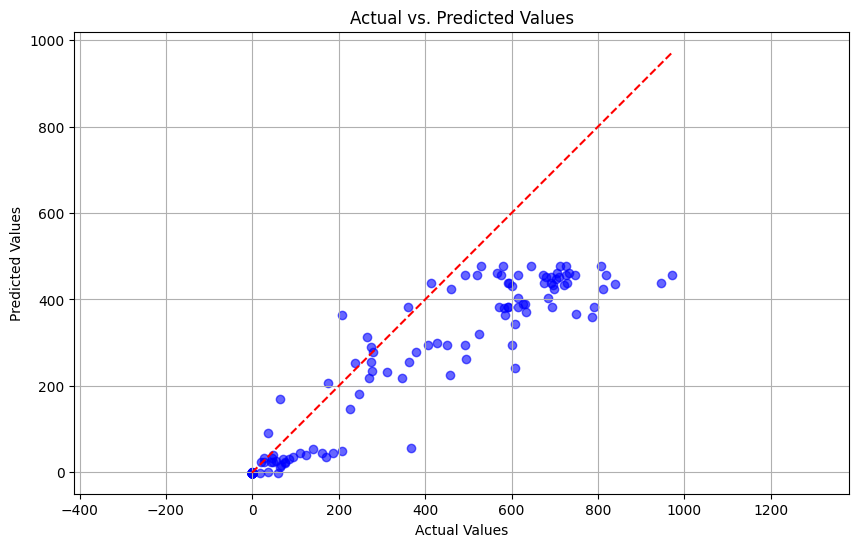

In [282]:
# Reverse the log1p transformation to get original values for both predictions and actual values
y_pred = np.expm1(y_pred_log)
y_eval = np.expm1(y_eval_log)

# Plotting Actual vs. Predicted values
plt.figure(figsize=(10, 6))
plt.scatter(y_eval, y_pred, alpha=0.6, color='blue')
plt.plot([y_eval.min(), y_eval.max()], [y_eval.min(), y_eval.max()], color='red', linestyle='--')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Actual vs. Predicted Values')
plt.grid(True)
plt.axis('equal')  # To maintain the aspect ratio
plt.show()


# API

## API Weather Month

In [283]:
data = pd.read_csv('/kaggle/input/openmeteo-v2/open-meteo.csv')

### data

In [284]:
data.isnull().sum()

time                                  0
temperature_2m (°C)                   0
relative_humidity_2m (%)              0
wind_speed_10m (km/h)                 0
wind_speed_100m (km/h)                0
soil_temperature_0_to_7cm (°C)        0
soil_temperature_7_to_28cm (°C)       0
soil_temperature_28_to_100cm (°C)     0
soil_temperature_100_to_255cm (°C)    0
dtype: int64

## API Irrdation Month

In [285]:
import requests

In [286]:
API_KEY = "tvATzwa1FudZ9qOK2oWYRDpkNdPsiall"

In [287]:
lat= 28.2344
lon = 34.8444

In [288]:
url =f'https://api.solcast.com.au/data/historic/radiation_and_weather?latitude={lat}&longitude={lon}&azimuth=44&tilt=90&start=2024-09-01T00:00:00.000Z&end=2024-10-01T00:00:00.000Z&format=json&time_zone=utc&period=PT60M'

In [289]:
headers = {"Authorization": f"Bearer {API_KEY}"}

In [290]:
response = requests.get(url,headers=headers)

In [291]:
len(response.json()["estimated_actuals"])

720

In [292]:
response.json()["estimated_actuals"][0]

{'air_temp': 31,
 'dni': 0,
 'ghi': 0,
 'period_end': '2024-09-01T01:00:00+00:00',
 'period': 'PT60M'}

In [293]:
response.json()["estimated_actuals"][-1]

{'air_temp': 29,
 'dni': 0,
 'ghi': 0,
 'period_end': '2024-10-01T00:00:00+00:00',
 'period': 'PT60M'}

In [294]:

def convert_ghi_to_dataframe(api_response):
    # Initialize an empty list to store the extracted data
    ghi_data = []

    # Loop through each entry in 'estimated_actuals'
    for entry in api_response.get('estimated_actuals', []):
        # Extract the 'ghi' and 'period_end' values
        ghi = entry.get('ghi', None)
        period_end = entry.get('period_end', None)

        # Append these values as a tuple to the list
        ghi_data.append({'Period_End': period_end, 'GHI': ghi})

    # Convert the list to a DataFrame
    df = pd.DataFrame(ghi_data)

    return df

In [295]:
ghi_df = convert_ghi_to_dataframe(response.json())
ghi_df

,Period_End,GHI
0,2024-09-01T01:00:00+00:00,0
1,2024-09-01T02:00:00+00:00,0
2,2024-09-01T03:00:00+00:00,0
3,2024-09-01T04:00:00+00:00,22
4,2024-09-01T05:00:00+00:00,185
...,...,...
715,2024-09-30T20:00:00+00:00,0
716,2024-09-30T21:00:00+00:00,0
717,2024-09-30T22:00:00+00:00,0
718,2024-09-30T23:00:00+00:00,0


In [296]:
data[["time","temperature_2m (°C)",	"soil_temperature_0_to_7cm (°C)"]]

,time,temperature_2m (°C),soil_temperature_0_to_7cm (°C)
0,2024-09-01T00:00,30.4,31.6
1,2024-09-01T01:00,30.8,32.4
2,2024-09-01T02:00,30.1,31.6
3,2024-09-01T03:00,29.5,30.9
4,2024-09-01T04:00,29.5,30.5
...,...,...,...
715,2024-09-30T19:00,30.1,32.9
716,2024-09-30T20:00,29.2,31.5
717,2024-09-30T21:00,28.5,30.4
718,2024-09-30T22:00,27.8,29.4


In [297]:
ghi_df

,Period_End,GHI
0,2024-09-01T01:00:00+00:00,0
1,2024-09-01T02:00:00+00:00,0
2,2024-09-01T03:00:00+00:00,0
3,2024-09-01T04:00:00+00:00,22
4,2024-09-01T05:00:00+00:00,185
...,...,...
715,2024-09-30T20:00:00+00:00,0
716,2024-09-30T21:00:00+00:00,0
717,2024-09-30T22:00:00+00:00,0
718,2024-09-30T23:00:00+00:00,0


# Forcast

## **prediction by one month**

In [298]:
neom_df = pd.concat([ghi_df[["GHI"]],data[["time","temperature_2m (°C)",	"soil_temperature_0_to_7cm (°C)"]]], axis=1)

In [299]:
neom_df.tail(24)

,GHI,time,temperature_2m (°C),soil_temperature_0_to_7cm (°C)
696,0,2024-09-30T00:00,26.5,28.4
697,0,2024-09-30T01:00,26.4,29.4
698,0,2024-09-30T02:00,26.0,28.5
699,8,2024-09-30T03:00,25.6,27.7
700,148,2024-09-30T04:00,25.4,27.1
701,369,2024-09-30T05:00,26.4,27.3
702,580,2024-09-30T06:00,28.1,28.6
703,744,2024-09-30T07:00,30.1,30.8
704,848,2024-09-30T08:00,32.0,33.7
705,885,2024-09-30T09:00,33.6,36.9


In [300]:
neom_df.head(1)

,GHI,time,temperature_2m (°C),soil_temperature_0_to_7cm (°C)
0,0,2024-09-01T00:00,30.4,31.6


In [301]:
neom_df = neom_df.rename(columns={'temperature_2m (°C)': 'AMBIENT_TEMPERATURE', 'soil_temperature_0_to_7cm (°C)': 'MODULE_TEMPERATURE', 'GHI': 'IRRADIATION'})

In [302]:
neom_df.head(1)

,IRRADIATION,time,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE
0,0,2024-09-01T00:00,30.4,31.6


In [303]:
neom_df

,IRRADIATION,time,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE
0,0,2024-09-01T00:00,30.4,31.6
1,0,2024-09-01T01:00,30.8,32.4
2,0,2024-09-01T02:00,30.1,31.6
3,22,2024-09-01T03:00,29.5,30.9
4,185,2024-09-01T04:00,29.5,30.5
...,...,...,...,...
715,0,2024-09-30T19:00,30.1,32.9
716,0,2024-09-30T20:00,29.2,31.5
717,0,2024-09-30T21:00,28.5,30.4
718,0,2024-09-30T22:00,27.8,29.4


In [304]:
# Rearranging the columns
neom_df = neom_df[['time', 'IRRADIATION', 'AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE']]

In [305]:
neom_df

,time,IRRADIATION,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE
0,2024-09-01T00:00,0,30.4,31.6
1,2024-09-01T01:00,0,30.8,32.4
2,2024-09-01T02:00,0,30.1,31.6
3,2024-09-01T03:00,22,29.5,30.9
4,2024-09-01T04:00,185,29.5,30.5
...,...,...,...,...
715,2024-09-30T19:00,0,30.1,32.9
716,2024-09-30T20:00,0,29.2,31.5
717,2024-09-30T21:00,0,28.5,30.4
718,2024-09-30T22:00,0,27.8,29.4


In [306]:
X_new = neom_df[['AMBIENT_TEMPERATURE','MODULE_TEMPERATURE','IRRADIATION']]

In [307]:
X_new.columns
# ['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE', 'IRRADIATION'] → عددها 3

Index(['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE', 'IRRADIATION'], dtype='object')

In [308]:
window_size = 6
preproc_flat = StandardScaler()
X_train_flat_scaled = preproc_flat.fit_transform(X_train_flat)
X_eval_flat_scaled = preproc_flat.transform(X_eval_flat)

X_new_np = X_new.to_numpy()
X_new_seq = []

for i in range(len(X_new_np) - window_size + 1):
    X_new_seq.append(X_new_np[i:i + window_size].flatten())

X_new_seq = np.array(X_new_seq)

X_new_scaled = preproc_flat.transform(X_new_seq)

y_pred_log = model_xgb_early_stopping.predict(X_new_scaled)
y_pred = np.expm1(y_pred_log)

In [309]:
y_pred.sum()

31333.291

In [310]:
pd.Series(y_pred).map(lambda x:x if x>=0 else 0)

0      57.946774
1      57.489079
2      56.739506
3      59.813393
4      59.813393
         ...    
710    20.559273
711    23.438759
712    28.859739
713    28.859739
714    28.859739
Length: 715, dtype: float64

In [311]:
import pickle

# Export Pipeline as pickle file
with open("model.pkl", "wb") as file:
    pickle.dump(model_xgb_early_stopping, file)

# # Load Pipeline from pickle file
# my_pipeline = pickle.load(open("pipeline.pkl","rb"))

## API Irrdation Day

In [312]:
url =f'https://api.solcast.com.au/data/historic/radiation_and_weather?latitude={lat}&longitude={lon}&azimuth=44&tilt=90&start=2024-10-01T00:00:00.000Z&end=2024-10-22T00:00:00.000Z&format=json&time_zone=utc&period=PT60M'

In [313]:
headers = {"Authorization": f"Bearer {API_KEY}"}

In [314]:
response2 = requests.get(url,headers=headers)

In [315]:
response2.json()

{'estimated_actuals': [{'air_temp': 28,
   'dni': 0,
   'ghi': 0,
   'period_end': '2024-10-01T01:00:00+00:00',
   'period': 'PT60M'},
  {'air_temp': 28,
   'dni': 0,
   'ghi': 0,
   'period_end': '2024-10-01T02:00:00+00:00',
   'period': 'PT60M'},
  {'air_temp': 28,
   'dni': 0,
   'ghi': 0,
   'period_end': '2024-10-01T03:00:00+00:00',
   'period': 'PT60M'},
  {'air_temp': 28,
   'dni': 24,
   'ghi': 9,
   'period_end': '2024-10-01T04:00:00+00:00',
   'period': 'PT60M'},
  {'air_temp': 29,
   'dni': 484,
   'ghi': 160,
   'period_end': '2024-10-01T05:00:00+00:00',
   'period': 'PT60M'},
  {'air_temp': 31,
   'dni': 706,
   'ghi': 384,
   'period_end': '2024-10-01T06:00:00+00:00',
   'period': 'PT60M'},
  {'air_temp': 32,
   'dni': 808,
   'ghi': 591,
   'period_end': '2024-10-01T07:00:00+00:00',
   'period': 'PT60M'},
  {'air_temp': 33,
   'dni': 860,
   'ghi': 754,
   'period_end': '2024-10-01T08:00:00+00:00',
   'period': 'PT60M'},
  {'air_temp': 34,
   'dni': 881,
   'ghi': 856,
 

In [316]:
ghi_day = convert_ghi_to_dataframe(response2.json())

In [317]:
ghi_day = ghi_day.loc[[470]]

In [318]:
ghi_day

,Period_End,GHI
470,2024-10-20T15:00:00+00:00,81


## API Weather Day

In [319]:
w_day=pd.read_csv('/kaggle/input/openmeteo-v2/open-meteo.csv')

In [320]:
w_day

,time,temperature_2m (°C),relative_humidity_2m (%),wind_speed_10m (km/h),wind_speed_100m (km/h),soil_temperature_0_to_7cm (°C),soil_temperature_7_to_28cm (°C),soil_temperature_28_to_100cm (°C),soil_temperature_100_to_255cm (°C)
0,2024-09-01T00:00,30.4,30,30.6,46.8,31.6,37.8,36.2,32.5
1,2024-09-01T01:00,30.8,31,31.7,48.0,32.4,37.8,36.2,32.5
2,2024-09-01T02:00,30.1,34,32.1,49.9,31.6,37.7,36.2,32.5
3,2024-09-01T03:00,29.5,39,31.7,49.4,30.9,37.6,36.2,32.5
4,2024-09-01T04:00,29.5,41,31.8,48.7,30.5,37.4,36.2,32.5
...,...,...,...,...,...,...,...,...,...
715,2024-09-30T19:00,30.1,34,27.2,41.8,32.9,35.3,35.0,33.4
716,2024-09-30T20:00,29.2,38,25.6,41.1,31.5,35.2,35.0,33.4
717,2024-09-30T21:00,28.5,42,28.0,44.3,30.4,35.2,35.0,33.4
718,2024-09-30T22:00,27.8,45,29.9,46.6,29.4,35.1,35.0,33.4


In [321]:
w_day = w_day.loc[[15]]

In [322]:
w_day

,time,temperature_2m (°C),relative_humidity_2m (%),wind_speed_10m (km/h),wind_speed_100m (km/h),soil_temperature_0_to_7cm (°C),soil_temperature_7_to_28cm (°C),soil_temperature_28_to_100cm (°C),soil_temperature_100_to_255cm (°C)
15,2024-09-01T15:00,39.6,12,28.1,36.5,44.7,37.8,36.2,32.5


In [323]:
# Resetting the index before concatenation
df1 = w_day.reset_index(drop=True)
df2 = ghi_day.reset_index(drop=True)

# Concatenate columns
neom_df2 = pd.concat([df1, df2], axis=1)

In [324]:
neom_df2

,time,temperature_2m (°C),relative_humidity_2m (%),wind_speed_10m (km/h),wind_speed_100m (km/h),soil_temperature_0_to_7cm (°C),soil_temperature_7_to_28cm (°C),soil_temperature_28_to_100cm (°C),soil_temperature_100_to_255cm (°C),Period_End,GHI
0,2024-09-01T15:00,39.6,12,28.1,36.5,44.7,37.8,36.2,32.5,2024-10-20T15:00:00+00:00,81


In [325]:
neom_df2 = neom_df2.drop(columns=['Period_End', 'relative_humidity_2m (%)', 'wind_speed_10m (km/h)', 'wind_speed_100m (km/h)', 'soil_temperature_7_to_28cm (°C)', 'soil_temperature_28_to_100cm (°C)', 'soil_temperature_100_to_255cm (°C)'])

In [326]:
neom_df2

,time,temperature_2m (°C),soil_temperature_0_to_7cm (°C),GHI
0,2024-09-01T15:00,39.6,44.7,81


In [327]:
neom_df2 = neom_df2.rename(columns={'temperature_2m (°C)': 'AMBIENT_TEMPERATURE', 'soil_temperature_0_to_7cm (°C)': 'MODULE_TEMPERATURE', 'GHI': 'IRRADIATION'})

In [328]:
neom_df2

,time,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2024-09-01T15:00,39.6,44.7,81


In [329]:
X_new = neom_df2[['AMBIENT_TEMPERATURE','MODULE_TEMPERATURE','IRRADIATION']]

In [330]:
print(X_new_np.shape)

(720, 3)


In [331]:
print("🔹 X_new_seq shape:", X_new_seq.shape)
print("🔍 Number of input rows:", X_new_np.shape[0])
print("🧮 Window size:", window_size)

print("🔹 First row of X_new_seq:\n", X_new_seq[0])
try:
    print("🔹 Scaler mean_ shape:", preproc_flat.mean_.shape)
except AttributeError:
    print("❌ preproc_flat has not been fitted yet!")

🔹 X_new_seq shape: (715, 18)
🔍 Number of input rows: 720
🧮 Window size: 6
🔹 First row of X_new_seq:
 [ 30.4  31.6   0.   30.8  32.4   0.   30.1  31.6   0.   29.5  30.9  22.
  29.5  30.5 185.   30.7  30.9 408. ]
🔹 Scaler mean_ shape: (18,)


In [332]:
# X_new_preproc = preproc.transform(X_new)
# y_pred_log = model_xgb_early_stopping.predict(X_new_preproc)
# y_pred = np.expm1(y_pred_log)

X_new_np = X_new.to_numpy()
X_new_np = np.repeat(X_new_np, 6, axis=0)
X_new_seq = []
window_size = 6
for i in range(len(X_new_np) - window_size + 1):
    X_new_seq.append(X_new_np[i:i + window_size].flatten())

X_new_seq = np.array(X_new_seq)
X_new_scaled = preproc_flat.transform(X_new_seq)

y_pred_log = model_xgb_early_stopping.predict(X_new_scaled)
y_pred = np.expm1(y_pred_log)

print("🎯 Final Prediction:", y_pred.sum())

🎯 Final Prediction: 59.813393


In [333]:
y_pred

array([59.813393], dtype=float32)

In [334]:
pd.Series(y_pred).map(lambda x:x if x>=0 else 0)

0    59.813393
dtype: float64

---

# ✅ Conclusion

As citizens living within the momentum of Vision 2030 — not merely observing it from a distance — we believe in contributing meaningfully to its realization. This project reflects our aspiration to be part of that future, using data and technology to support sustainable development in NEOM and beyond.

In alignment with Saudi Arabia’s Vision 2030, which emphasizes sustainability, clean energy, and smart city development, this project delivers a comprehensive machine learning framework to simulate and support NEOM’s energy future.

It combines electricity consumption forecasting and solar energy production modeling using real-world datasets and scalable machine learning techniques.

To realistically estimate NEOM’s power needs, we used per capita consumption data from **Tetouan** (selected for its climatic and cultural similarity), and scaled it based on **NEOM’s population of 300,000 residents in September 2024**, the target timeframe for the simulation.

Importantly, we accounted for the **difference in individual consumption behavior** between the two countries: on average, a Saudi resident consumes **four times more electricity** than a Moroccan resident. This adjustment ensured the simulation reflects **localized demand patterns** rather than raw data extrapolation.

> **NEOM Power Consumption**  
> = (Per Capita Consumption in Tetouan) × 300,000 (NEOM population in Sep 2024) × 4 (consumption multiplier)  
> = Estimated electricity demand for NEOM

Based on this simulation, we estimated that **approximately 2,000 solar power plants** would be required to fully meet NEOM’s energy demands under current efficiency assumptions.

The selected models — XGBoost for both consumption and production — achieved high performance:
- **Consumption Forecasting**: R² = 0.8173
- **Solar Forecasting**: R² = 0.944

Additionally, the project integrates **real-time weather APIs** to enhance its adaptability and bring it closer to live, deployable energy forecasting systems.

---

## 🚀 Real-World Impact

This project offers clear, actionable value across the energy ecosystem:

- **Solar maintenance teams** can schedule panel cleaning during periods of low solar input or when storage systems are full, minimizing risk of energy loss or service interruption.  

- **Facility operators** can anticipate peak demand hours and shift non-critical operations, such as irrigation, cooling, or EV charging to low-demand periods, optimizing energy usage, minimizing costs, and reducing pressure on the grid.

- **Energy providers** can use production forecasts to plan ahead, instead of reacting at the last minute to sudden drops or spikes. This helps reduce energy waste, avoid stress on the grid, and improve the overall balance between what’s produced and what’s actually needed.

- **Investors and planners** can test different investment scenarios using real consumption data, helping them decide the best time and place to build new solar stations, and how much return they can expect.

In **NEOM**, these are not external applications! They’re native to the vision we’re helping bring to life.

---
This simulation-driven, data-backed approach offers a strong foundation for sustainable, efficient, and intelligent energy planning, aligned with NEOM’s role as a centerpiece of Vision 2030.

In the spirit of Vision 2030, we aimed not just to learn, but to build. Not just to explore, but to deliver. And this project, we hope, is only the beginning.

---